# Physics-Guided AI for Enhanced Heat Index Forecasting in the Philippine Context (Neural Nets)


# Import Python Libraries

In [36]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


In [37]:
import torch

if torch.cuda.is_available():
    print(f"GPU: {torch.cuda.get_device_name(0)} is available.")
else:
    print("No GPU available. Training will run on CPU.")

GPU: NVIDIA GeForce RTX 5070 Ti is available.


In [38]:
!nvidia-smi

Tue Sep 30 17:18:26 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 576.88                 Driver Version: 576.88         CUDA Version: 12.9     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                  Driver-Model | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA GeForce RTX 5070 Ti   WDDM  |   00000000:01:00.0  On |                  N/A |
|  0%   42C    P3             35W /  300W |    1567MiB /  16303MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

## Data Loading

Climatological data from DOST-PAGASA (http://bagong.pagasa.dost.gov.ph/climate/climate-data)
Notes:
- 999.0 indicate Missing Values
- TMAX (Maximum Temperature, Unit: Deg C)
- TMIN (Minimum Temperature, Unit: Deg C)
- RH (Relative Humidity, Unit: %)
- Wind Speed, Unit: m/s
- Wind direction, Unit: degree relative to North indicating where the wind is blowing from

Stations:
- NAIA Latitude: 14.5047 N Longitude: 121.004751 E Elevation: 21 m
- Port Area Latitude: 14.58841 N Longitude: 120.967866 E Elevation: 15 m
- Science Garden Latitude: 14.645072 N Longitude: 121.044282 E Elevation: 42 m
- Baguio Latitude: 16.403992 N Longitude: 120.60147 E Elevation: 1510.08 m
- Laoag Latitude: 18.183016 N Longitude: 120.534723 E Elevation: 5 m
- Sinait Latitude: 17.89019 N Longitude: 120.459762 E Elevation: 58.129 m
- Dagupan Latitude: 16.086784 N Longitude: 120.352045 E Elevation: 2 m
- Tuguegarao Latitude: 17.647678 N Longitude: 121.758469 E Elevation: 62 m
- Aparri Latitude: 18.360059 N Longitude: 121.630454 E Elevation: 3 m
- Basco Radar Latitude: 20.427284 N Longitude: 121.970536 E Elevation: 167 m
- Baler Radar Latitude: 15.748809 N Longitude: 121.632028 E Elevation: 173 m
- Cabanatuan Latitude: 15.470387 N Longitude: 120.951143 E Elevation: 32 m
- CLSU Latitude: 15.73586 N Longitude: 120.9368 E Elevation: 7.6 m
- Clark Latitude: 15.1717 N Longitude: 120.5616667 E Elevation: 151.564 m
- Iba Latitude: 15.328408 N Longitude: 119.965661 E Elevation: 5.538 m
- Ambulong Latitude: 14.09008056 N Longitude: 121.0552444 E Elevation: 11 m
- Sangley Point Latitude: 14.494953 N Longitude: 120.906838 E Elevation: 3 m
- Tanay Latitude: 14.581167 N Longitude: 121.36927 E Elevation: 650 m
- Infanta Latitude: 14.74663611 N Longitude: 121.6490333 E Elevation: 7 m
- Tayabas Latitude: 14.018428 N Longitude: 121.596575 E Elevation: 158 m
- Calapan Latitude: 13.409775 N Longitude: 121.1896667 E Elevation: 41 m
- San Jose Latitude: 12.359602 N Longitude: 121.04788 E Elevation: 3.314 m
- Puerto Princesa Latitude: 9.740134 N Longitude: 118.758613 E Elevation: 16.76 m
- Daet Latitude: 14.128689 N Longitude: 122.982559 E Elevation: 3.77 m
- Legazpi Latitude: 13.150937 N Longitude: 123.728605 E Elevation: 15.487 m
- Virac Synop Latitude: 13.576558 N Longitude: 124.209834 E Elevation: 31.574 m


In [39]:
# Store individual datasets into a dictionary of dataframes
df_ambulong = pd.read_csv('C:/Users/Blix/Documents/GitHub/CCTHESS1-CCTHESS2-Dev-and-Docs/datasets/Ambulong Daily Data.csv')
df_baguio = pd.read_csv('C:/Users/Blix/Documents/GitHub/CCTHESS1-CCTHESS2-Dev-and-Docs/datasets/Baguio Daily Data.csv')
df_baler = pd.read_csv('C:/Users/Blix/Documents/GitHub/CCTHESS1-CCTHESS2-Dev-and-Docs/datasets/Baler Radar Daily Data.csv')
df_basco = pd.read_csv('C:/Users/Blix/Documents/GitHub/CCTHESS1-CCTHESS2-Dev-and-Docs/datasets/Basco Radar Daily Data.csv')
df_calapan = pd.read_csv('C:/Users/Blix/Documents/GitHub/CCTHESS1-CCTHESS2-Dev-and-Docs/datasets/Calapan Daily Data.csv')
df_clark = pd.read_csv('C:/Users/Blix/Documents/GitHub/CCTHESS1-CCTHESS2-Dev-and-Docs/datasets/Clark Daily Data.csv')
df_daet = pd.read_csv('C:/Users/Blix/Documents/GitHub/CCTHESS1-CCTHESS2-Dev-and-Docs/datasets/Daet Daily Data.csv')
df_dagupan = pd.read_csv('C:/Users/Blix/Documents/GitHub/CCTHESS1-CCTHESS2-Dev-and-Docs/datasets/Dagupan Daily Data.csv')
df_iba = pd.read_csv('C:/Users/Blix/Documents/GitHub/CCTHESS1-CCTHESS2-Dev-and-Docs/datasets/Iba Daily Data.csv')
df_infanta = pd.read_csv('C:/Users/Blix/Documents/GitHub/CCTHESS1-CCTHESS2-Dev-and-Docs/datasets/Infanta Daily Data.csv')
df_laoag = pd.read_csv('C:/Users/Blix/Documents/GitHub/CCTHESS1-CCTHESS2-Dev-and-Docs/datasets/Laoag Daily Data.csv')
df_legazpi = pd.read_csv('C:/Users/Blix/Documents/GitHub/CCTHESS1-CCTHESS2-Dev-and-Docs/datasets/Legazpi Daily Data.csv')
df_naia = pd.read_csv('C:/Users/Blix/Documents/GitHub/CCTHESS1-CCTHESS2-Dev-and-Docs/datasets/NAIA Daily Data.csv')
df_port = pd.read_csv('C:/Users/Blix/Documents/GitHub/CCTHESS1-CCTHESS2-Dev-and-Docs/datasets/Port Area Daily Data.csv')
df_puerto = pd.read_csv('C:/Users/Blix/Documents/GitHub/CCTHESS1-CCTHESS2-Dev-and-Docs/datasets/Puerto Princesa Daily Data.csv')
df_sanjose = pd.read_csv('C:/Users/Blix/Documents/GitHub/CCTHESS1-CCTHESS2-Dev-and-Docs/datasets/San Jose Daily Data.csv')
df_sangley = pd.read_csv('C:/Users/Blix/Documents/GitHub/CCTHESS1-CCTHESS2-Dev-and-Docs/datasets/Sangley Point Daily Data.csv')
df_sciencegarden = pd.read_csv('C:/Users/Blix/Documents/GitHub/CCTHESS1-CCTHESS2-Dev-and-Docs/datasets/Science Garden Daily Data.csv')
df_sinait = pd.read_csv('C:/Users/Blix/Documents/GitHub/CCTHESS1-CCTHESS2-Dev-and-Docs/datasets/Sinait Daily Data.csv')
df_tanay = pd.read_csv('C:/Users/Blix/Documents/GitHub/CCTHESS1-CCTHESS2-Dev-and-Docs/datasets/Tanay Daily Data.csv')
df_tayabas = pd.read_csv('C:/Users/Blix/Documents/GitHub/CCTHESS1-CCTHESS2-Dev-and-Docs/datasets/Tayabas Daily Data.csv')
df_tuguegarao = pd.read_csv('C:/Users/Blix/Documents/GitHub/CCTHESS1-CCTHESS2-Dev-and-Docs/datasets/Tuguegarao Daily Data.csv')
df_virac = pd.read_csv('C:/Users/Blix/Documents/GitHub/CCTHESS1-CCTHESS2-Dev-and-Docs/datasets/Virac Synop Daily Data.csv')

In [40]:
# Store dataframes in a list for easy access (Less Cabanatuan and CLSU - information loss)
dataframes = [
    df_ambulong, df_baguio, df_baler, df_basco, df_calapan, df_clark, df_daet, df_dagupan, df_iba, df_infanta, df_laoag, df_legazpi, df_naia,
    df_port, df_puerto, df_sanjose, df_sangley, df_sciencegarden, df_sinait, df_tanay, df_tayabas, df_tuguegarao, df_virac
]
# Corresponding names for the dataframes
dataframe_names = [
    'Ambulong', 'Baguio', 'Baler', 'Basco', 'Calapan', 'Clark', 'Daet', 'Dagupan', 'Iba', 'Infanta', 'Laoag', 'Legazpi', 'NAIA', 
    'Port Area', 'Puerto Princesa', 'San Jose', 'Sangley Point', 'Science Garden', 'Sinait', 'Tanay', 'Tayabas', 'Tuguegarao', 'Virac Synop'
]


# Corresponding latitude for the dataframes
latitudes = [
    14.09008056, 16.403992, 15.748809, 20.427284, 13.409775, 15.1717, 14.128689, 16.086784, 15.328408, 14.74663611, 18.183016, 13.150937, 14.5047,
    14.58841, 9.740134, 12.359602, 14.494953, 14.645072, 17.89019, 14.581167, 14.018428, 17.647678, 13.576558
]

# Corresponding longitude for the dataframes
longitudes = [
    121.0552444, 120.60147, 121.632028, 121.970536, 121.1896667, 120.5616667, 122.982559, 120.352045, 119.965661, 121.6490333, 120.534723, 123.728605, 121.004751,
    121.004751, 118.758613, 121.04788, 120.906838, 121.044282, 120.459762, 121.36927, 121.596575, 121.758469, 124.209834
]

# Corresponding elevation for the dataframes
elevations = [
    11, 1510.08, 173, 167, 41, 151.564, 3.77, 2, 5.538, 7, 5, 15.487, 21, 
    15, 16.76, 3.314, 3, 42, 58.129, 650, 158, 62, 31.574
]

In [41]:
# Add latitude, longitude, and elevation to each dataframe
for df, lat, lon, elev in zip(dataframes, latitudes, longitudes, elevations):
    df['Latitude'] = lat
    df['Longitude'] = lon
    df['Elevation'] = elev

## Initial Sanity Check

In [42]:
def sanity_check(df):
    # Print name of dataset (e.g. df_ambulong)
    print(f"Sanity Check for dataset: {df.name}")
    print("First 5 rows of the dataframe:")
    print(df.head())
    print("\nDataframe Info:")
    print(df.info())
    print("\nMissing Values in each column (containing -999.0 or np.nan):")
    print((df == -999.0).sum() + df.isna().sum())
    print("\nDuplicate values in the dataframe:")
    print(df.duplicated().sum())
    print("\nStatistical Summary:")
    print(df.describe())

In [43]:
for df, name in zip(dataframes, dataframe_names):
    df.name = name  # Assign name attribute to dataframe
    sanity_check(df)
    print("\n" + "="*50 + "\n")

Sanity Check for dataset: Ambulong
First 5 rows of the dataframe:
   YEAR  MONTH  DAY  TMAX  TMIN  RH  WIND_SPEED  WIND_DIRECTION    HI  \
0  2014      1    1  30.4  22.8  74           2              40  34.3   
1  2014      1    2  29.9  20.0  74           2              40  33.3   
2  2014      1    3  31.0  20.5  79           1              40  35.9   
3  2014      1    4  32.0  22.5  76           1              40  38.0   
4  2014      1    5  30.6  23.0  75           2              40  34.7   

   Albedo_linear  ...  NDBaI_linear  NDBaI_spline  NDBI_linear  NDBI_spline  \
0       0.334435  ...      0.131949      0.197894    -0.131949    -0.199351   
1       0.334435  ...      0.131949      0.198007    -0.131949    -0.199470   
2       0.334435  ...      0.131949      0.198119    -0.131949    -0.199588   
3       0.334435  ...      0.131949      0.198232    -0.131949    -0.199705   
4       0.334435  ...      0.131949      0.198344    -0.131949    -0.199823   

   NDVI_original  ND

Important Null Value Findings:
- Abulong: 17
- Aparri: 1414
- Baler: 1 
- Basco: 244
- Cabanatuan: 1 
- Calapan: 1 
- Clark: 0
- CLSU: 0
- Daet: 0
- Dagupan: 244
- Iba: 0
- Infanta: 0
- Laoag: 1 
- Legazpi: 0
- NAIA: 79
- Port Area: 26
- Puerto Princesa: 0
- San Jose: 0
- Sangley Point: 1 
- Science Garden: 4
- Sinait: 0 
- Tanay: 1 
- Tayabas: 0
- Tuguegarao: 116
- Virac Synop: 0

In [44]:
# Store columns for each dataframe with -999.0 or np.nan values
missing_value_columns = {}
for df, name in zip(dataframes, dataframe_names):
    missing_cols = df.columns[(df == -999.0).any() | df.isna().any()].tolist()
    missing_value_columns[name] = missing_cols
print("Columns with -999.0 values in each dataset:")
for name, cols in missing_value_columns.items():
    print(f"{name}: {cols}")

Columns with -999.0 values in each dataset:
Ambulong: ['TMAX', 'TMIN', 'RH', 'WIND_SPEED', 'WIND_DIRECTION', 'HI', 'NDVI_original']
Baguio: ['HI', 'NDVI_original']
Baler: ['RH', 'WIND_SPEED', 'WIND_DIRECTION', 'NDVI_original']
Basco: ['RH', 'WIND_SPEED', 'WIND_DIRECTION', 'HI', 'NDVI_original']
Calapan: ['RH', 'HI', 'NDVI_original']
Clark: ['NDVI_original']
Daet: ['NDVI_original']
Dagupan: ['TMAX', 'TMIN', 'RH', 'WIND_SPEED', 'WIND_DIRECTION', 'HI', 'NDVI_original']
Iba: ['NDVI_original']
Infanta: ['NDVI_original']
Laoag: ['WIND_SPEED', 'WIND_DIRECTION', 'NDVI_original']
Legazpi: ['NDVI_original']
NAIA: ['TMAX', 'TMIN', 'RH', 'WIND_SPEED', 'WIND_DIRECTION', 'HI', 'NDVI_original']
Port Area: ['TMAX', 'TMIN', 'RH', 'WIND_SPEED', 'WIND_DIRECTION', 'HI', 'NDVI_original']
Puerto Princesa: ['NDVI_original']
San Jose: ['NDVI_original']
Sangley Point: ['TMAX', 'TMIN', 'RH', 'WIND_SPEED', 'WIND_DIRECTION', 'NDVI_original']
Science Garden: ['TMAX', 'TMIN', 'RH', 'WIND_SPEED', 'WIND_DIRECTION', '

In [45]:
# Convert -999.0 to NaN for easier handling
for df in dataframes:
    df.replace(-999.0, np.nan, inplace=True)

In [46]:
# Create Date column for time series plots
for df in dataframes:
    df['Date'] = pd.to_datetime(df[['YEAR', 'MONTH', 'DAY']])

# Exploratory Data Analysis

In [47]:
# Plot time-series graph of features for each dataset that has -999.0 values. Print graph, one feature and one Date at a time. Do not include features that do not have -999.0 values, do not display all Dates at once, and if there is a -999.0 value, consider it as a missing value and display it in the graph.
def plot_time_series_with_missing_values(df, columns):
    for col in columns:
        plt.figure(figsize=(12, 6))
        plt.plot(df['Date'], df[col], marker='o', linestyle='-', markersize=3)
        plt.title(f'Time Series of {col} in {df.name}')
        plt.xlabel('Date')
        plt.ylabel(col)
        plt.xticks(rotation=45)
        plt.grid()
        plt.legend()
        plt.tight_layout()
        plt.show()

C:\Users\Blix\AppData\Local\Temp\ipykernel_396\2376163538.py:11: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


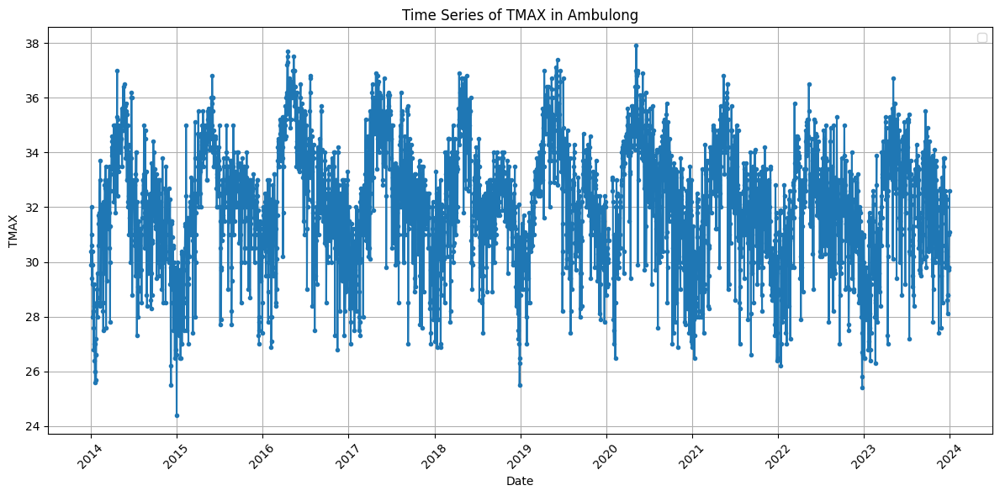

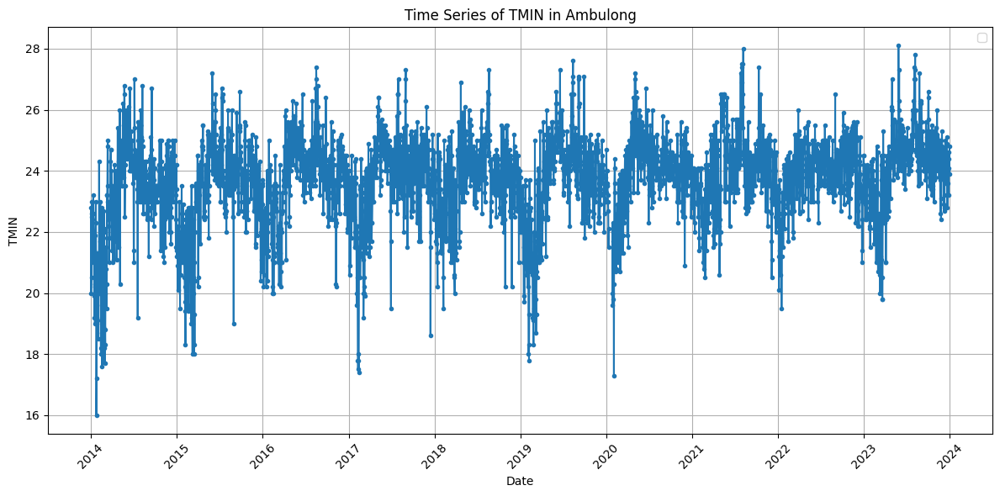

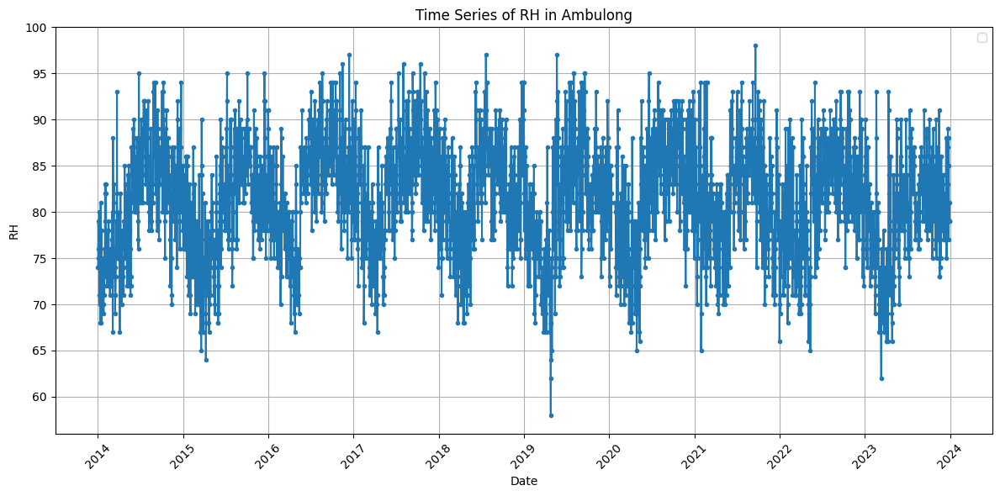

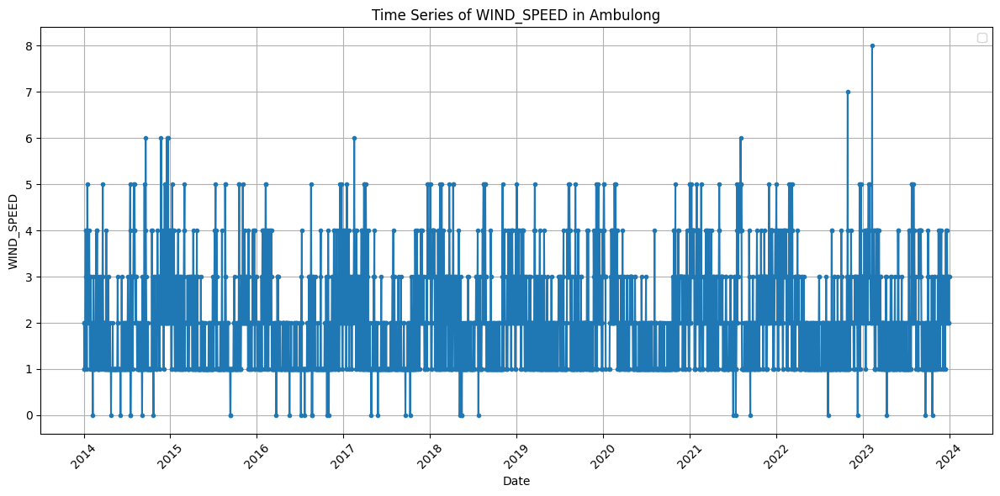

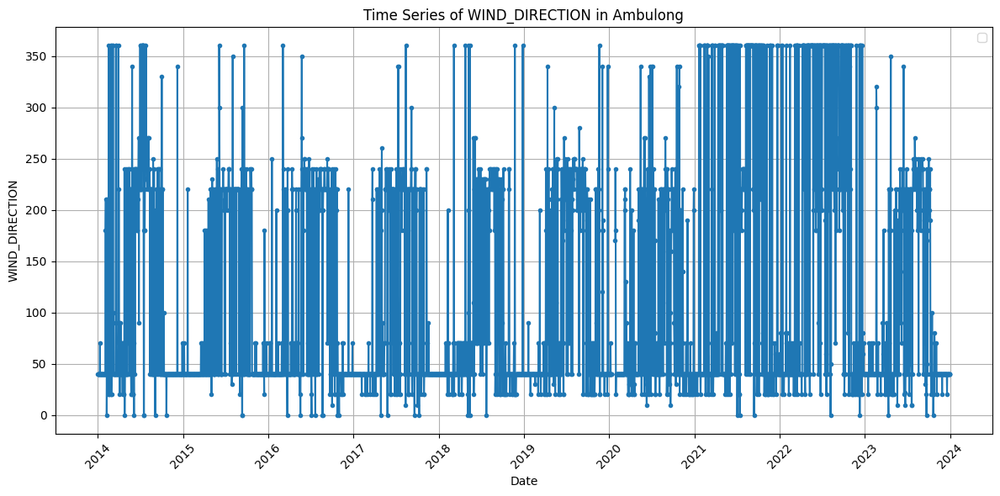

...

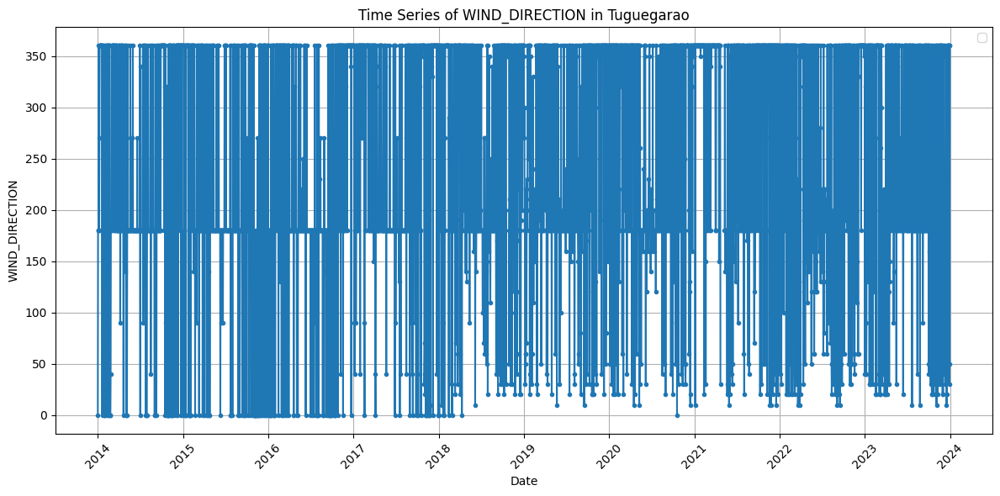

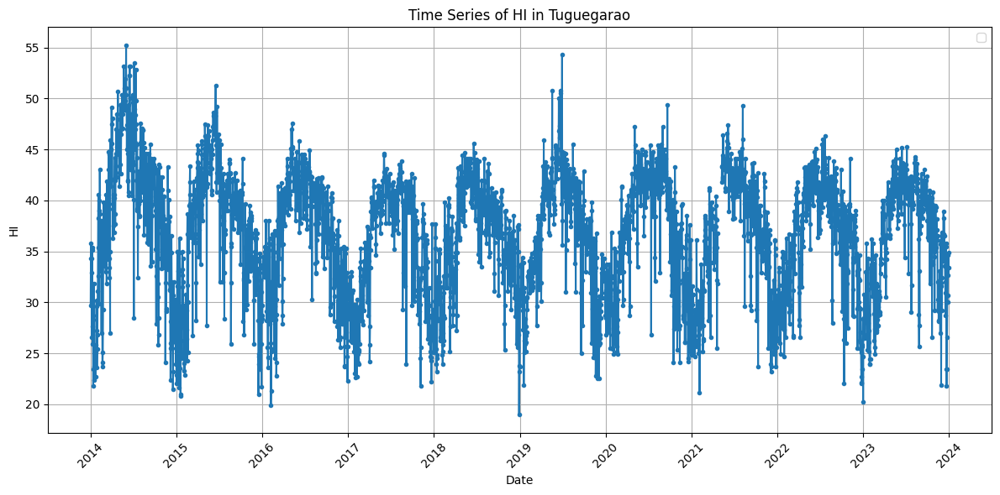

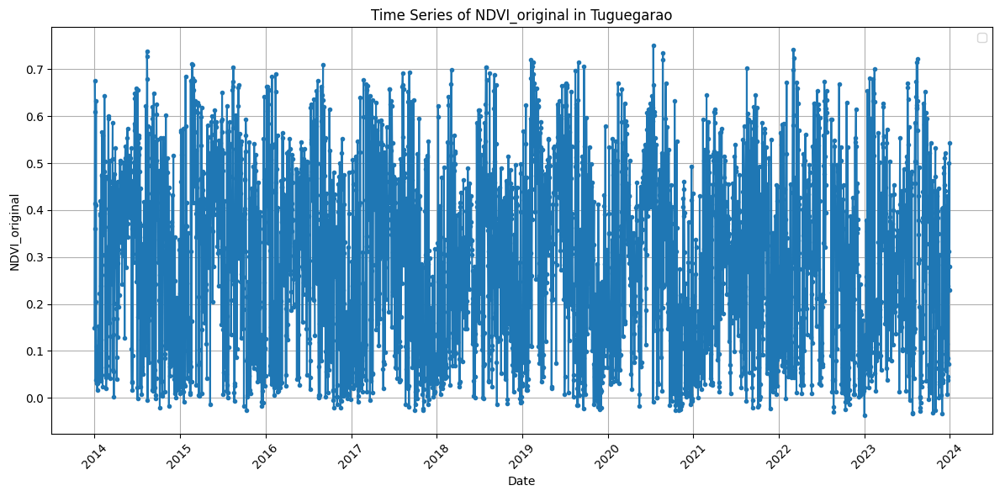

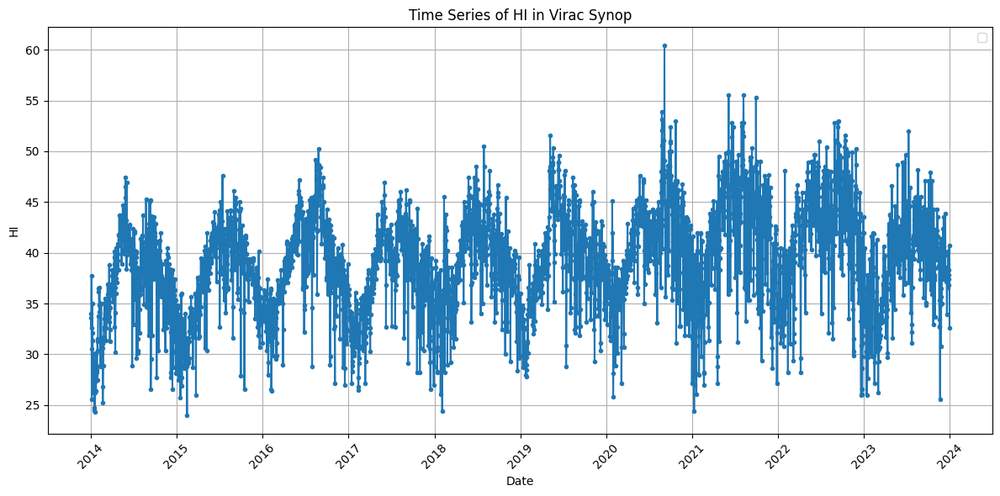

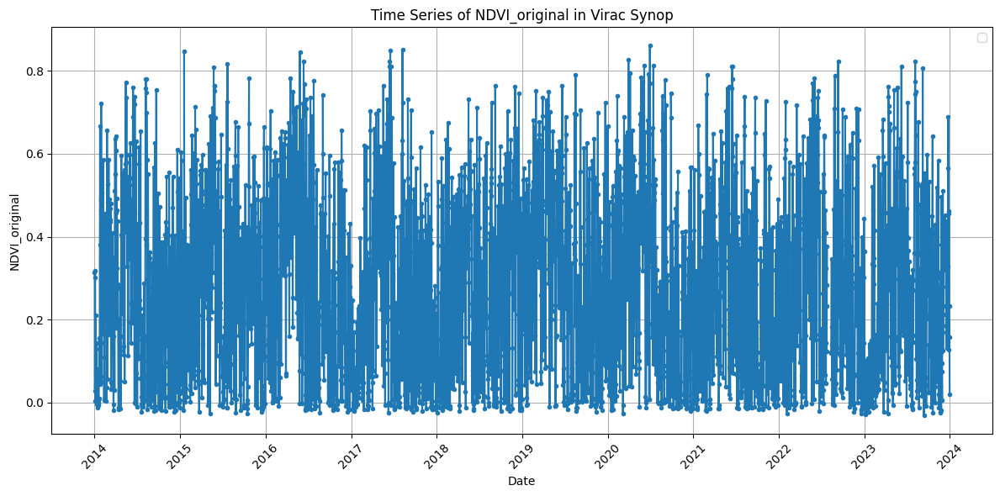

In [48]:
for df, name in zip(dataframes, dataframe_names):
    missing_cols = missing_value_columns[name]
    if missing_cols:
        plot_time_series_with_missing_values(df, missing_cols)

In [49]:
!pip install statsmodels

Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com


In [50]:
# Check for Seasonal Trends using STL Decomposition
from statsmodels.tsa.seasonal import STL

def stl_decomposition(df, column):
    df = df.set_index('Date')
    df = df.asfreq('D')  # Ensure daily frequency
    stl = STL(df[column], seasonal=13)  # Seasonal period of 13 for monthly seasonality in daily data
    result = stl.fit()
    
    plt.figure(figsize=(12, 8))
    plt.subplot(4, 1, 1)
    plt.plot(result.observed, label='Observed', color='blue')
    plt.ylabel('Observed')
    plt.legend(loc='upper left')
    
    plt.subplot(4, 1, 2)
    plt.plot(result.trend, label='Trend', color='orange')
    plt.ylabel('Trend')
    plt.legend(loc='upper left')
    
    plt.subplot(4, 1, 3)
    plt.plot(result.seasonal, label='Seasonal', color='green')
    plt.ylabel('Seasonal')
    plt.legend(loc='upper left')
    
    plt.subplot(4, 1, 4)
    plt.plot(result.resid, label='Residual', color='red')
    plt.ylabel('Residual')
    plt.legend(loc='upper left')
    
    plt.tight_layout()
    plt.show()

In [51]:
import pandas as pd
import numpy as np

def impute_station_data(df_station, alpha=0.7):
    """
    Gap-aware imputation for one station DataFrame.
    Expects columns: ['Date','TMAX','TMIN','RH','WIND_SPEED','WIND_DIRECTION', 'HI']
    -999.0 are treated as NaN.
    Returns DataFrame with imputed columns and recomputed 'HI'.
    """
    df = df_station.copy()
    # Ensure Datetime and sorted
    df = df.sort_values('Date').set_index('Date')
    
    # Replace sentinel with NaN
    df = df.replace(-999.0, np.nan)
    # Check all columns with NaNs and store
    cols_with_nans = df.columns[df.isna().any()].tolist()
    
    # --- Create circular components for WIND_DIRECTION early (so they appear in climatology) ---
    if 'WIND_DIRECTION' in df.columns:
        # WIND_DIRECTION may be NaN; np.sin(np.deg2rad(np.nan)) -> nan (ok)
        df['WIND_DIRECTION_sin'] = np.sin(np.deg2rad(df['WIND_DIRECTION']))
        df['WIND_DIRECTION_cos'] = np.cos(np.deg2rad(df['WIND_DIRECTION']))
    
    # --- Build climatologies and fallbacks ---
    # dayofyear climatology (1..366)
    climatology = df.groupby(df.index.dayofyear).mean()
    # monthly climatology fallback
    monthly_clim = df.groupby(df.index.month).mean()
    # global means as last fallback
    global_means = df.mean()
    
    # Helper: get fallback climatology value for a given Date and column
    def get_clim_value(Date, col):
        doy = Date.dayofyear
        mon = Date.month
        if col in climatology.columns:
            val = climatology.at[doy, col]
            if not pd.isna(val):
                return val
        # try monthly
        if col in monthly_clim.columns:
            mval = monthly_clim.at[mon, col]
            if not pd.isna(mval):
                return mval
        # final fallback
        return global_means.get(col, np.nan)
    
    # --- Utility: find consecutive NaN runs using boolean mask iteration ---
    def find_nan_runs(series):
        mask = series.isna().to_numpy()
        runs = []
        n = len(mask)
        i = 0
        while i < n:
            if mask[i]:
                start = i
                while i+1 < n and mask[i+1]:
                    i += 1
                end = i
                runs.append((start, end))
            i += 1
        return runs
    
    # --- Imputation function for a single scalar column ---
    def impute_scalar(s, colname):
        s = s.copy()
        if s.notna().sum() == 0:
            # nothing observed -> fill with global mean (or NaN if not available)
            fill_val = get_clim_value(s.index[0], colname)
            return s.fillna(fill_val)
        
        # Precompute an interpolated series limited to short gaps
        interp_full = s.interpolate(method='time', limit=3, limit_direction='both')
        rolling = s.rolling(window=7, min_periods=1, center=True).mean()
        
        runs = find_nan_runs(s)
        for start_pos, end_pos in runs:
            gap_len = end_pos - start_pos + 1
            idx_range = s.index[start_pos:end_pos+1]
            
            if gap_len <= 3:
                # Short gap: take interpolation result for those indices
                s.loc[idx_range] = interp_full.loc[idx_range]
            
            elif gap_len <= 14:
                # Medium gap: blended rolling + climatology
                clim_series = pd.Series([get_clim_value(d, colname) for d in s.index], index=s.index)
                blended = alpha * rolling + (1 - alpha) * clim_series
                s.loc[idx_range] = blended.loc[idx_range]
            
            else:
                # Long gap: use climatology day-of-year with fallback
                clim_vals = [get_clim_value(d, colname) for d in idx_range]
                s.loc[idx_range] = clim_vals
        
        # final safety fill (if any NaNs left) with global mean
        s = s.fillna(global_means.get(colname, np.nan))
        return s
    
    # --- Apply to scalar meteorological columns ---
    for col in cols_with_nans:
        if col in df.columns:
            df[col] = impute_scalar(df[col], col)
    
    # --- Wind direction: impute sin/cos then convert back ---
    if 'WIND_DIRECTION' in df.columns:
        df['WIND_DIRECTION_sin'] = impute_scalar(df['WIND_DIRECTION_sin'], 'WIND_DIRECTION_sin')
        df['WIND_DIRECTION_cos'] = impute_scalar(df['WIND_DIRECTION_cos'], 'WIND_DIRECTION_cos')
        # Reconstruct direction in degrees 0..360
        WIND_DIRECTION_rad = np.arctan2(df['WIND_DIRECTION_sin'], df['WIND_DIRECTION_cos'])
        df['WIND_DIRECTION'] = (np.rad2deg(WIND_DIRECTION_rad) + 360) % 360
        df = df.drop(columns=['WIND_DIRECTION_sin','WIND_DIRECTION_cos'])
    
    return df.reset_index()


In [52]:
# Fill missing values in all datasets
features_to_check = ['HI']
for i, (df, name) in enumerate(zip(dataframes, dataframe_names)):
    df.name = name  # Ensure name attribute is set
    # Print current dataset being processed
    print(f"Processing dataset: {df.name}")
    # Perform outlier removal before imputation
    print(f"Imputing missing values for dataset: {df.name}")
    dataframes[i] = impute_station_data(df)
    # Check if any NaNs remain
    if dataframes[i].isna().sum().sum() == 0:
        print(f"All missing values imputed for dataset: {df.name}")
    else:
        print(f"Warning: Some missing values remain in dataset: {df.name}")

Processing dataset: Ambulong
Imputing missing values for dataset: Ambulong
All missing values imputed for dataset: Ambulong
Processing dataset: Baguio
Imputing missing values for dataset: Baguio
All missing values imputed for dataset: Baguio
Processing dataset: Baler
Imputing missing values for dataset: Baler
All missing values imputed for dataset: Baler
Processing dataset: Basco
Imputing missing values for dataset: Basco
All missing values imputed for dataset: Basco
Processing dataset: Calapan
Imputing missing values for dataset: Calapan
All missing values imputed for dataset: Calapan
Processing dataset: Clark
Imputing missing values for dataset: Clark
All missing values imputed for dataset: Clark
Processing dataset: Daet
Imputing missing values for dataset: Daet
All missing values imputed for dataset: Daet
Processing dataset: Dagupan
Imputing missing values for dataset: Dagupan
All missing values imputed for dataset: Dagupan
Processing dataset: Iba
Imputing missing values for dataset

In [53]:
for df, name in zip(dataframes, dataframe_names):
    df.name = name  # Assign name attribute to dataframe
    sanity_check(df)
    print("\n" + "="*50 + "\n")

Sanity Check for dataset: Ambulong
First 5 rows of the dataframe:
        Date  YEAR  MONTH  DAY  TMAX  TMIN    RH  WIND_SPEED  WIND_DIRECTION  \
0 2014-01-01  2014      1    1  30.4  22.8  74.0         2.0            40.0   
1 2014-01-02  2014      1    2  29.9  20.0  74.0         2.0            40.0   
2 2014-01-03  2014      1    3  31.0  20.5  79.0         1.0            40.0   
3 2014-01-04  2014      1    4  32.0  22.5  76.0         1.0            40.0   
4 2014-01-05  2014      1    5  30.6  23.0  75.0         2.0            40.0   

     HI  ...  NDBaI_linear  NDBaI_spline  NDBI_linear  NDBI_spline  \
0  34.3  ...      0.131949      0.197894    -0.131949    -0.199351   
1  33.3  ...      0.131949      0.198007    -0.131949    -0.199470   
2  35.9  ...      0.131949      0.198119    -0.131949    -0.199588   
3  38.0  ...      0.131949      0.198232    -0.131949    -0.199705   
4  34.7  ...      0.131949      0.198344    -0.131949    -0.199823   

   NDVI_original  NDWI_linear  N

C:\Users\Blix\AppData\Local\Temp\ipykernel_396\2376163538.py:11: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


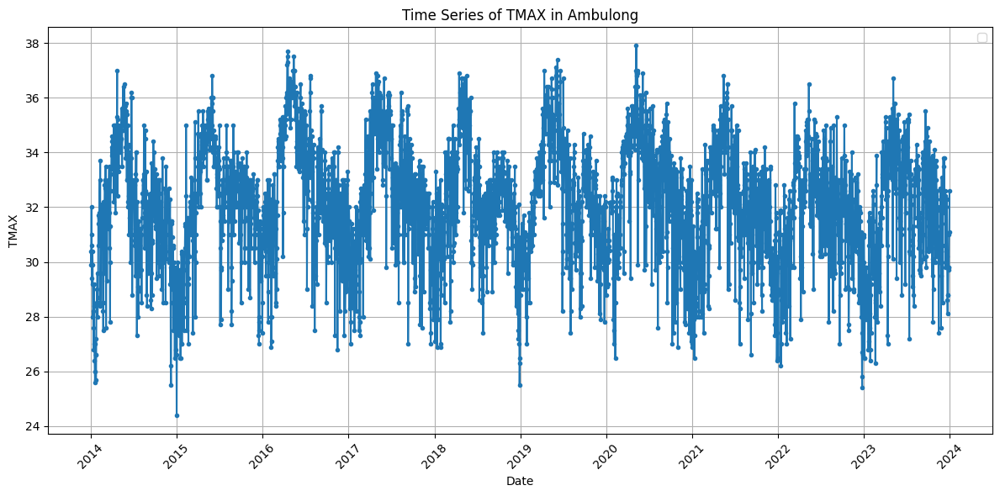

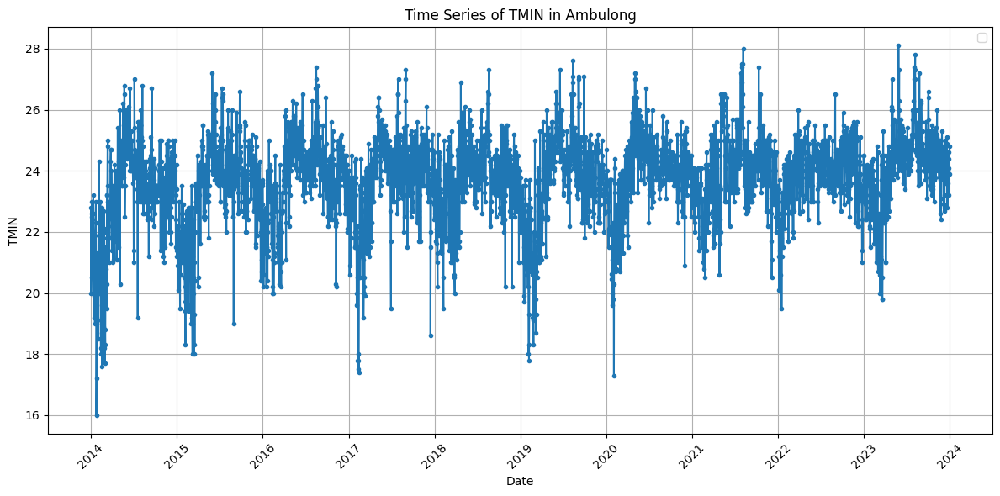

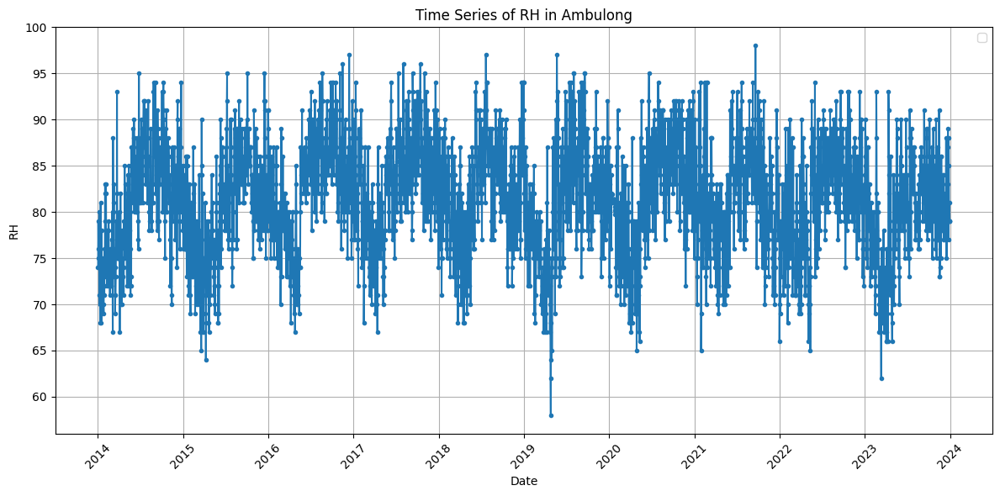

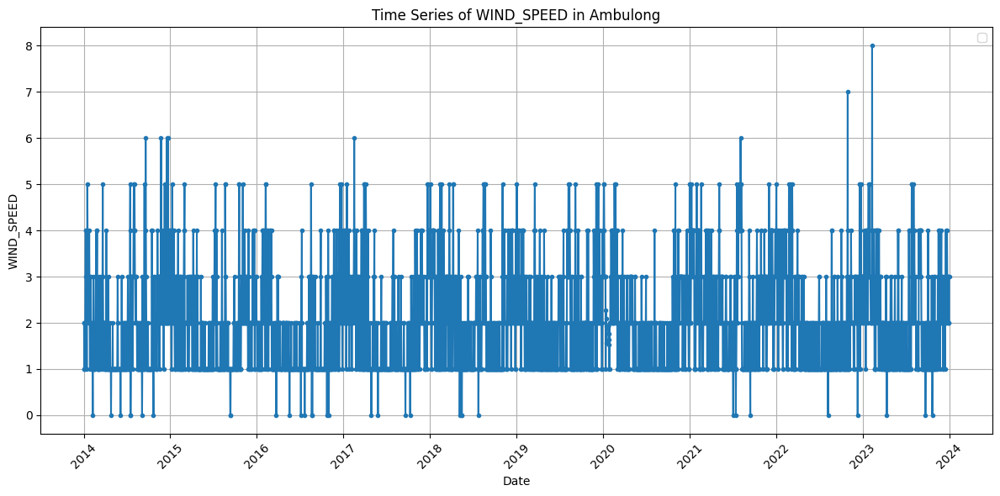

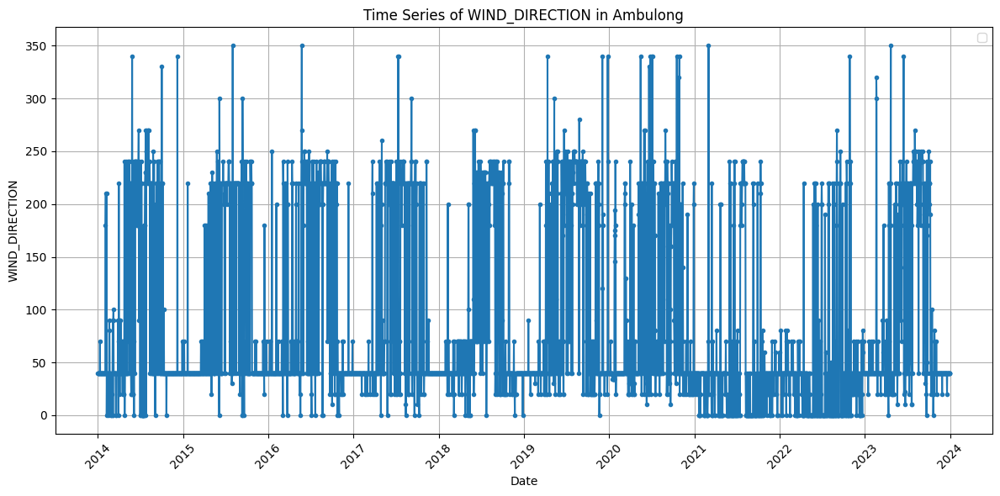

...

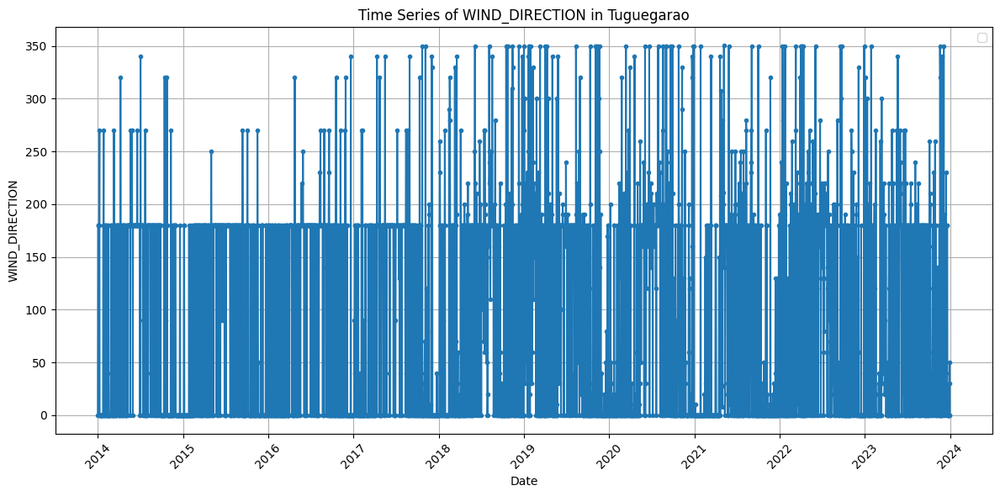

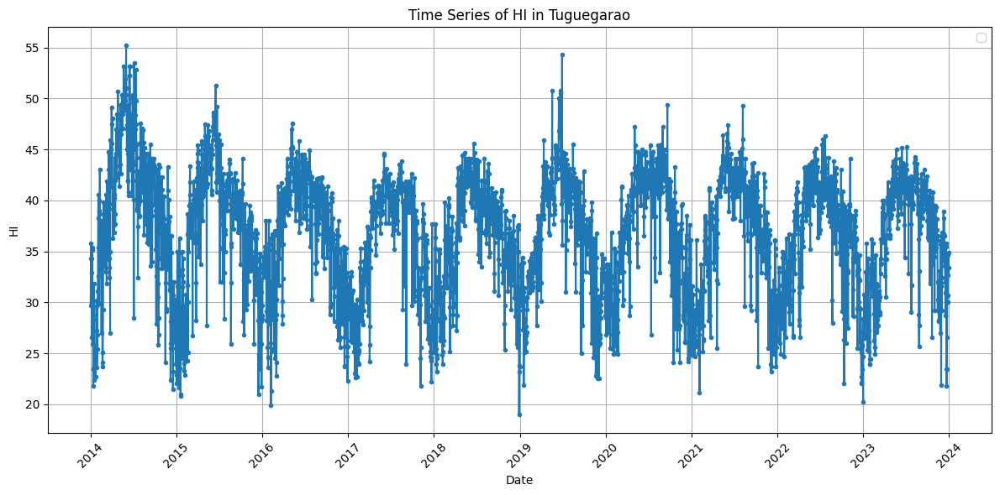

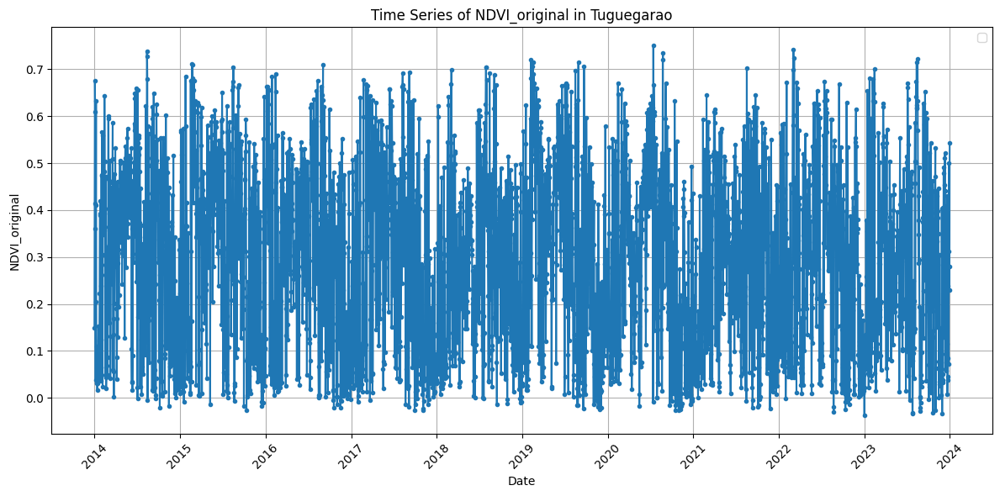

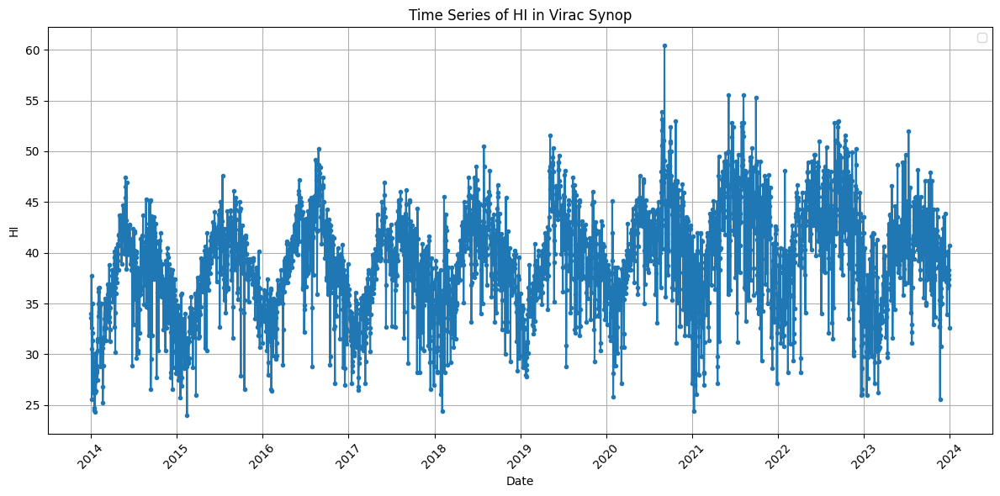

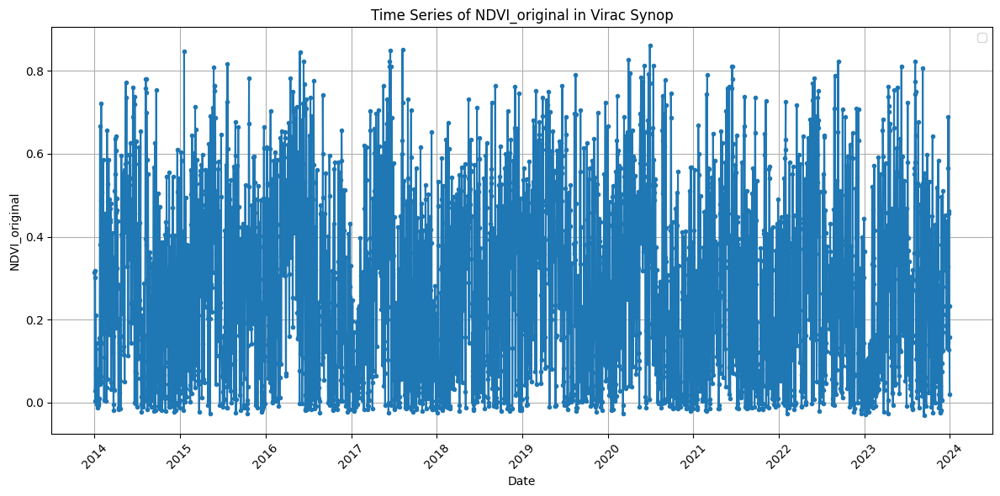

In [54]:
# Plot the time series of original missing features for each dataset after imputation to verify no missing values remain
missing_value_columns
for df, name in zip(dataframes, dataframe_names):
    missing_cols = missing_value_columns[name]
    if missing_cols:
        plot_time_series_with_missing_values(df, missing_cols)

C:\Users\Blix\AppData\Local\Temp\ipykernel_396\1866024867.py:10: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


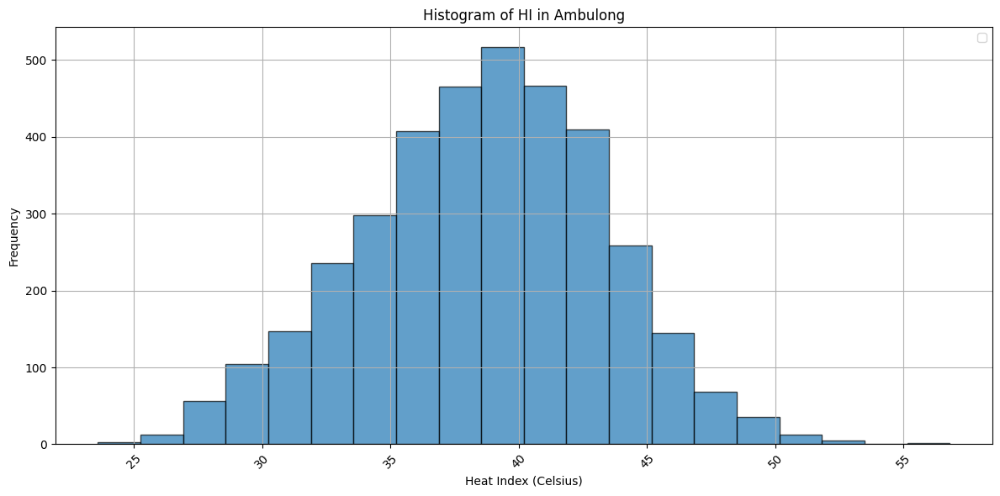

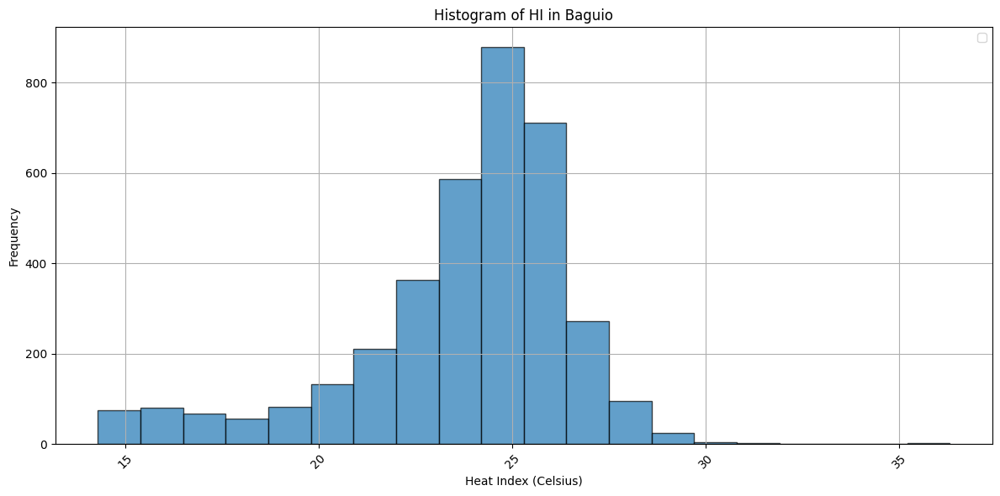

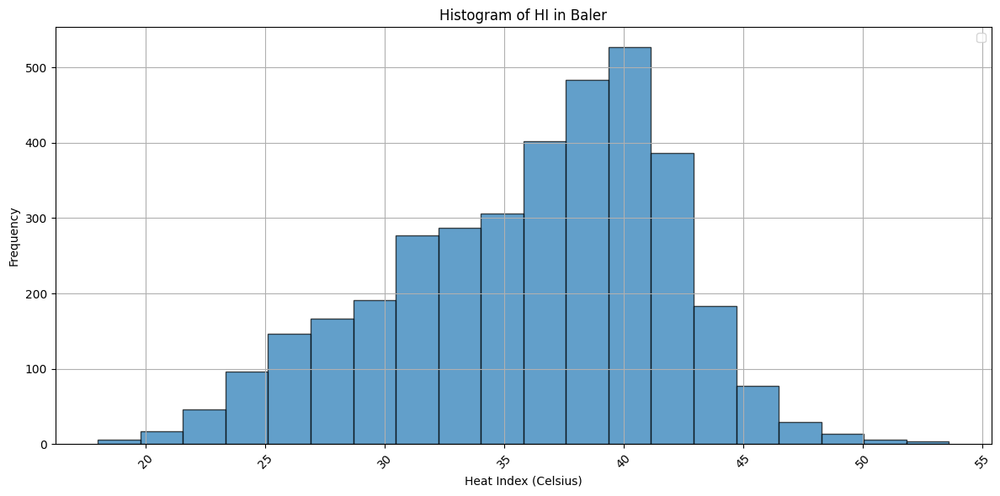

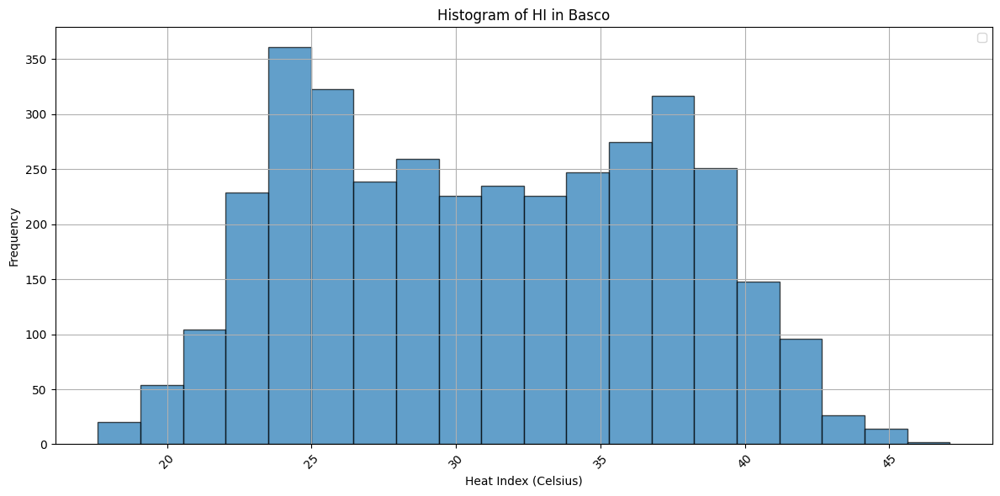

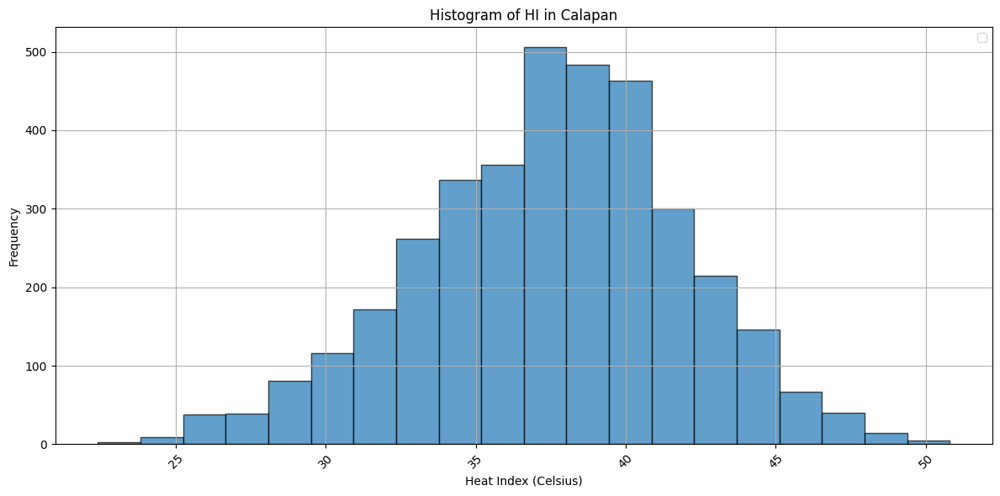

...

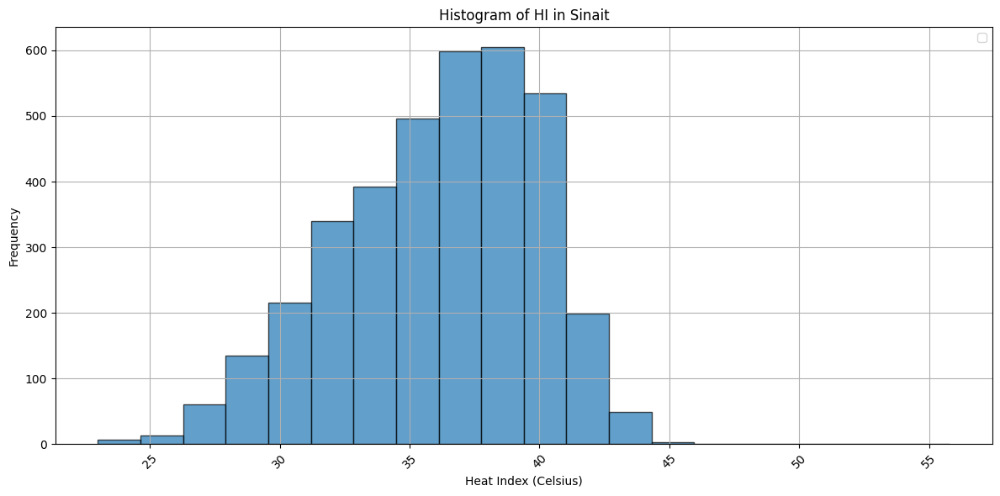

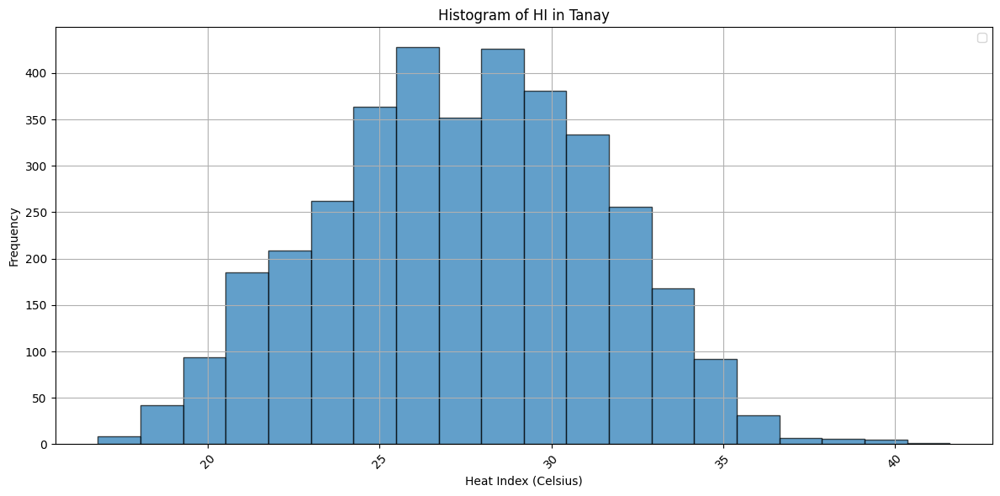

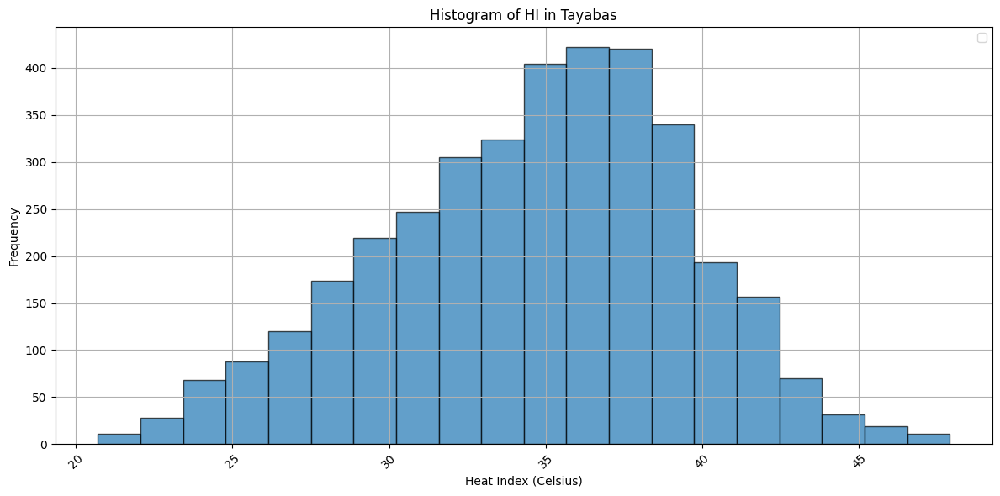

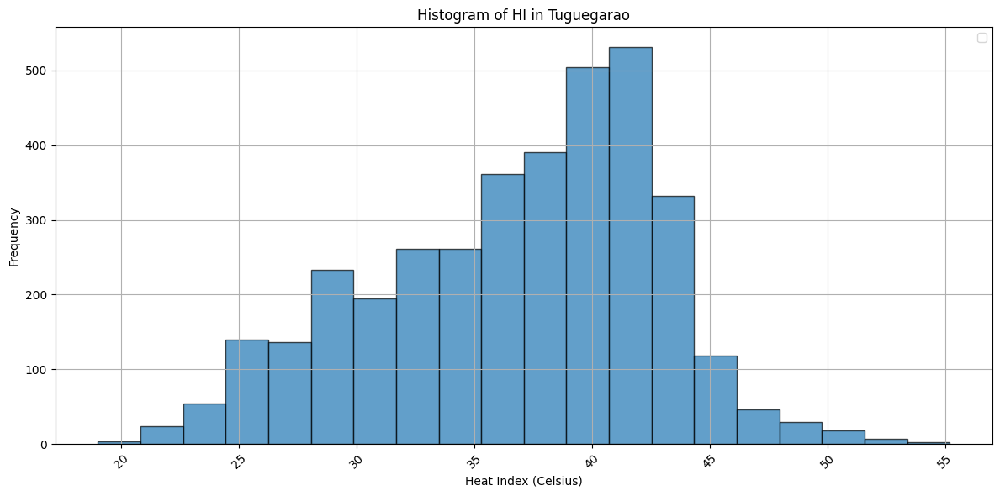

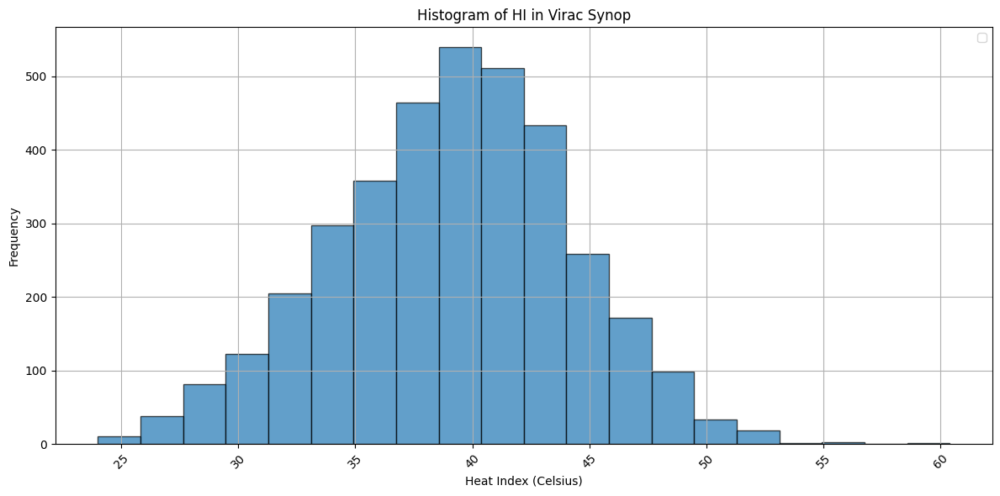

In [55]:
# Plot time-series graph of HI and HI for each dataset. Date on x-axis, HI on y-axis.
for i, (df, name) in enumerate(zip(dataframes, dataframe_names)):
    plt.figure(figsize=(12, 6))
    plt.hist(df['HI'], bins=20, edgecolor='black', alpha=0.7)
    plt.title(f'Histogram of HI in {name}')
    plt.xlabel('Heat Index (Celsius)')
    plt.ylabel('Frequency')
    plt.xticks(rotation=45)
    plt.grid()
    plt.legend()
    plt.tight_layout()
    plt.show()

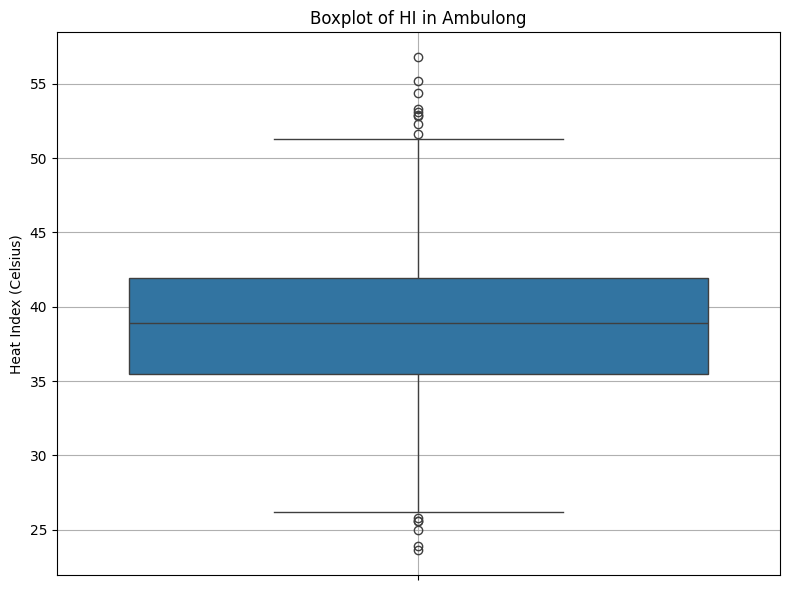

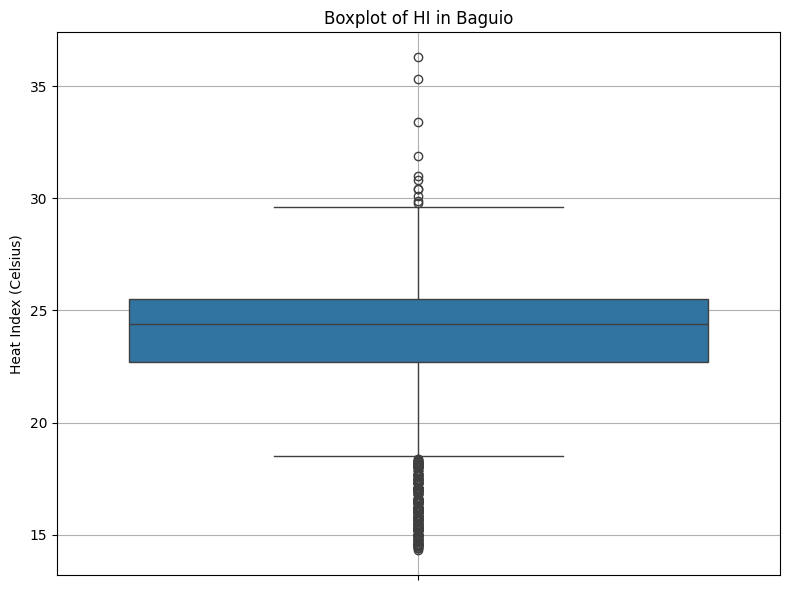

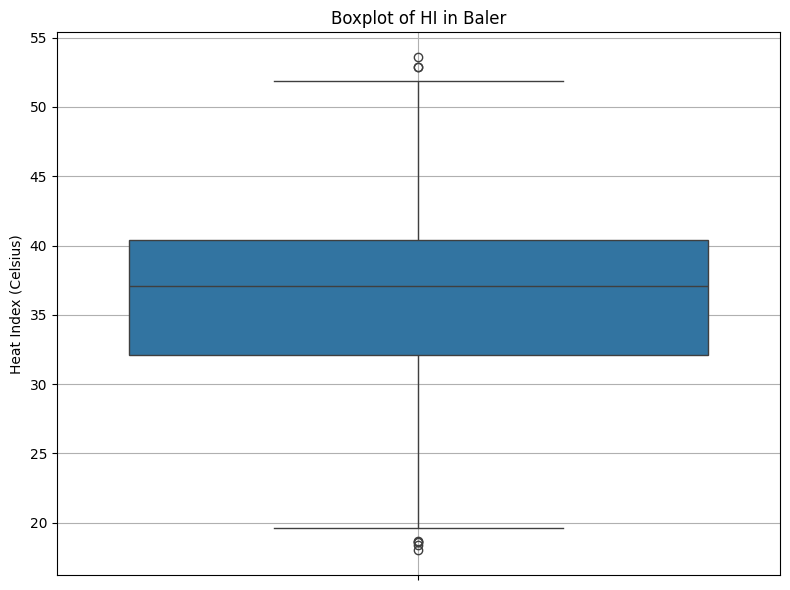

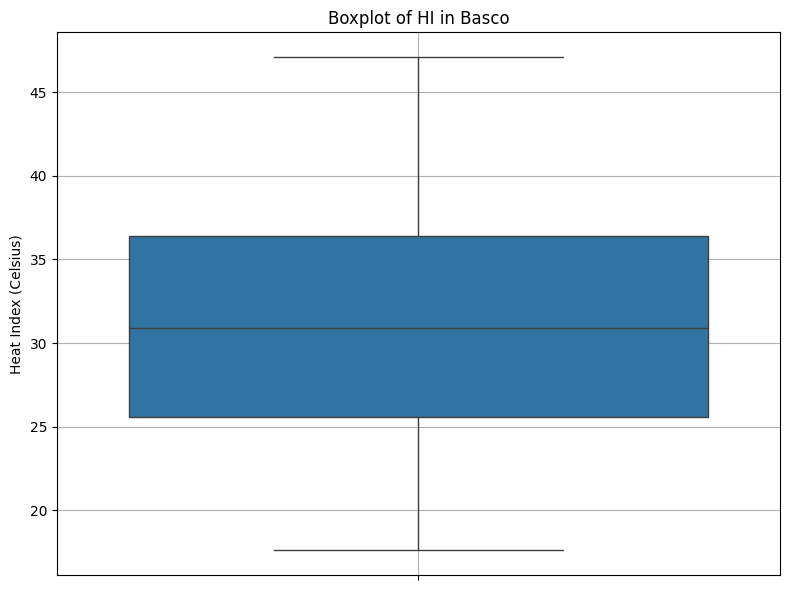

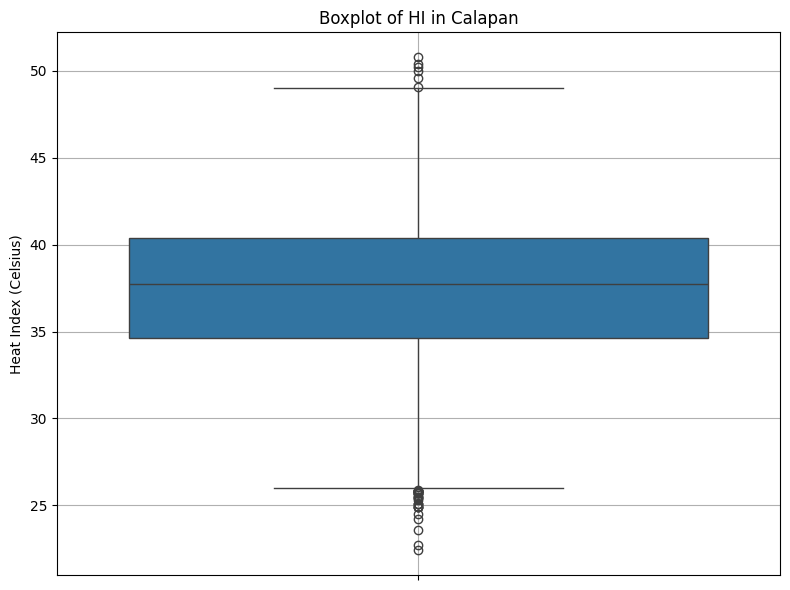

...

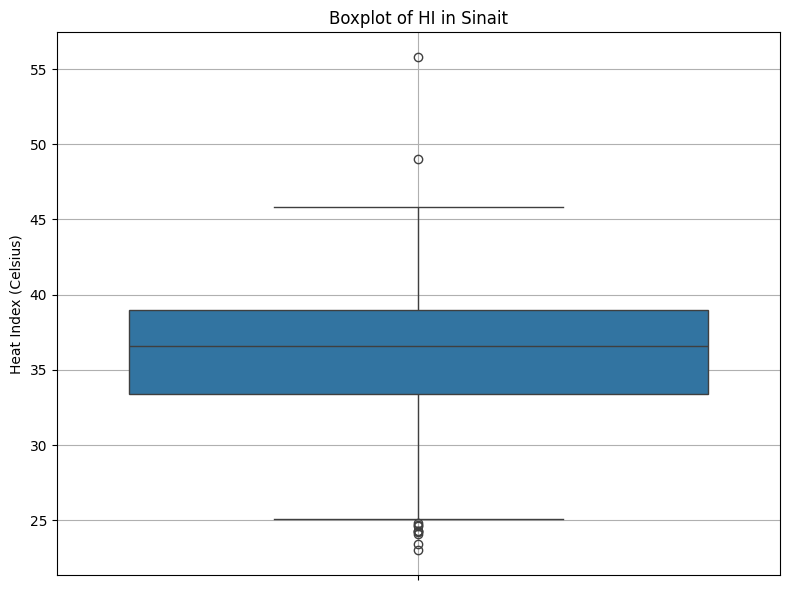

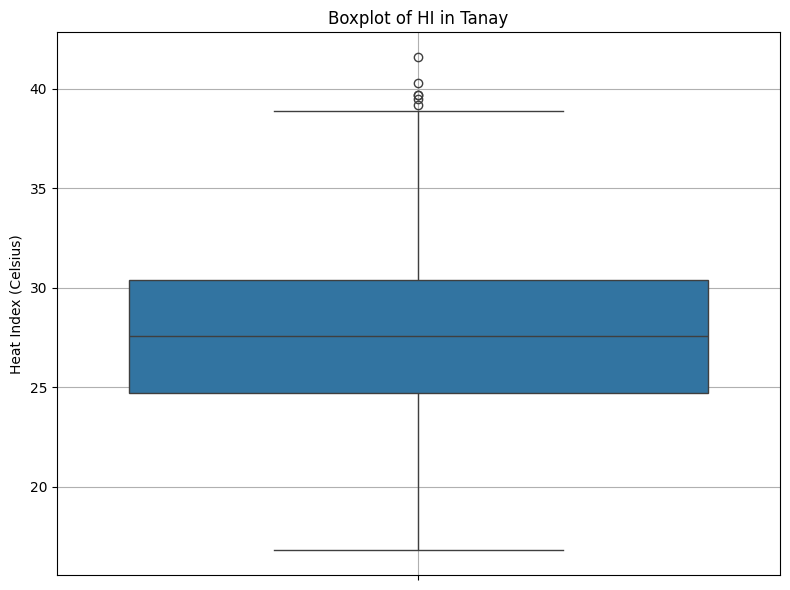

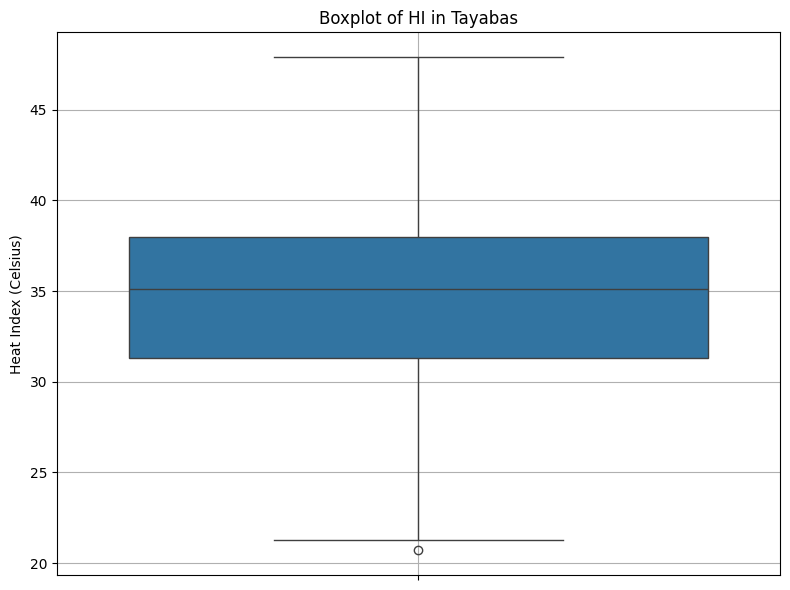

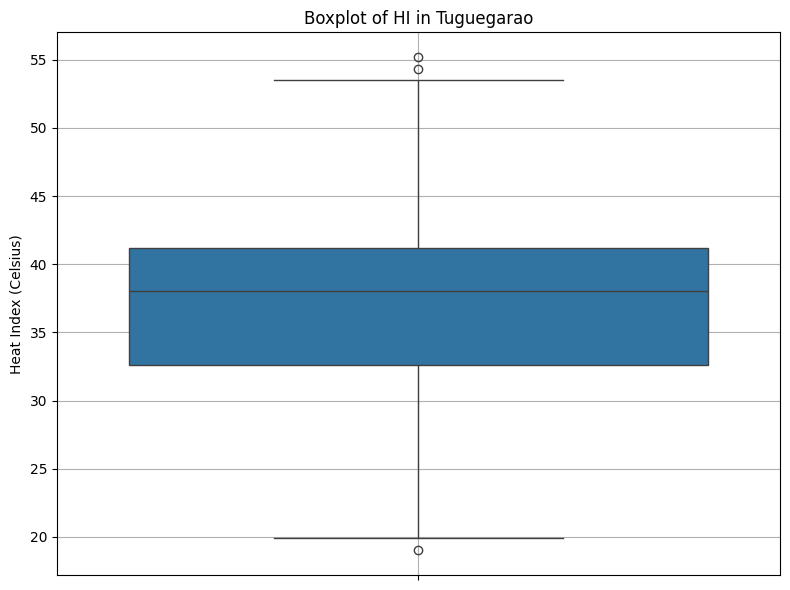

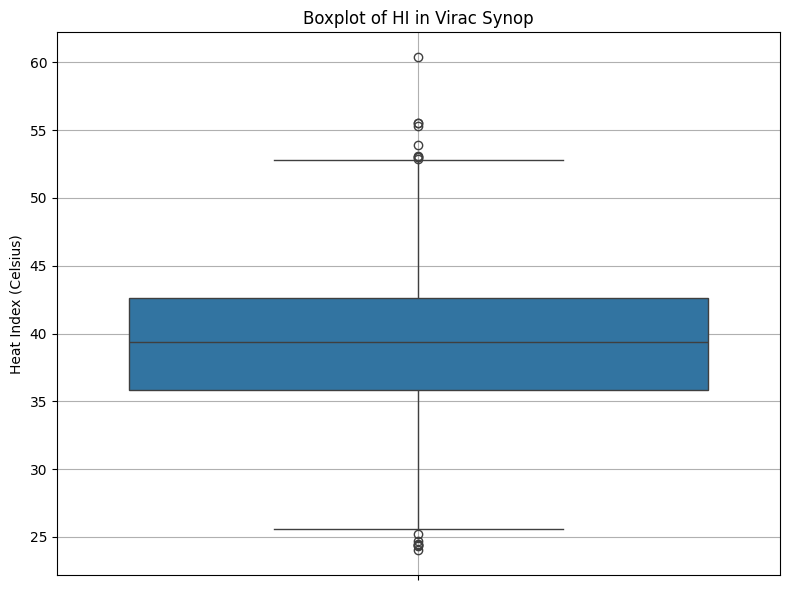

In [57]:
# Show boxplot of HI for each dataset to check for outliers
for i, (df, name) in enumerate(zip(dataframes, dataframe_names)):
    plt.figure(figsize=(8, 6))
    sns.boxplot(y=df['HI'])
    plt.title(f'Boxplot of HI in {name}')
    plt.ylabel('Heat Index (Celsius)')
    plt.grid()
    plt.tight_layout()
    plt.show()

STL Decomposition for dataset: Ambulong


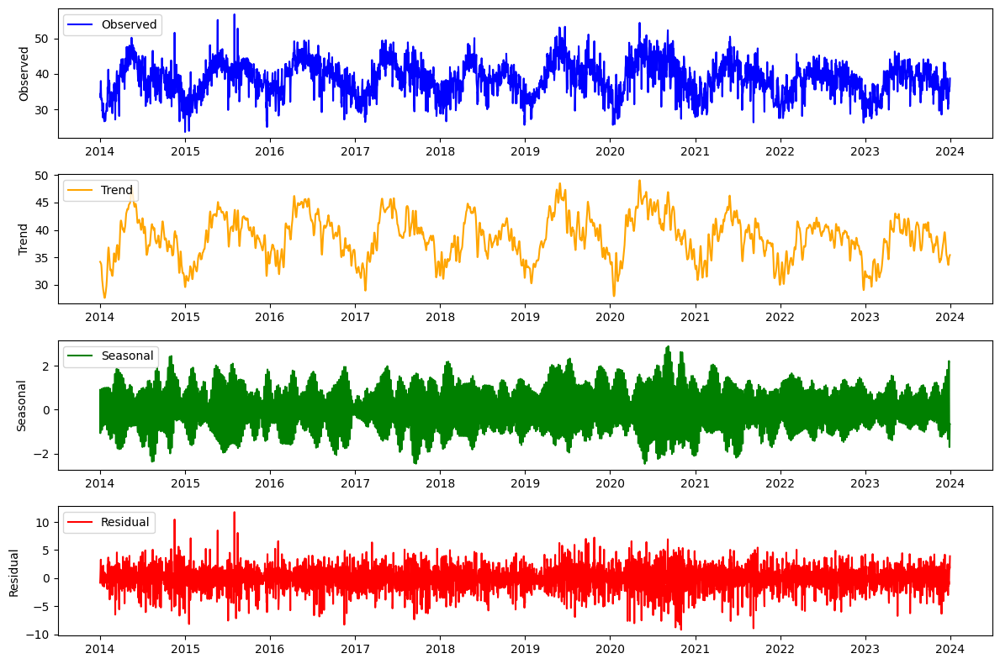

STL Decomposition for dataset: Baguio


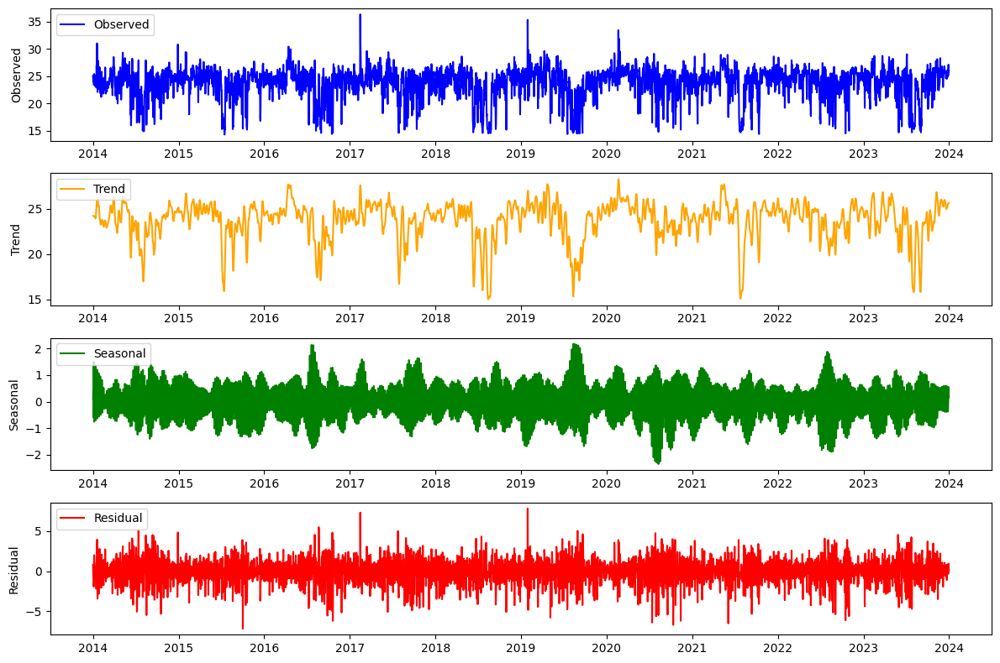

STL Decomposition for dataset: Baler


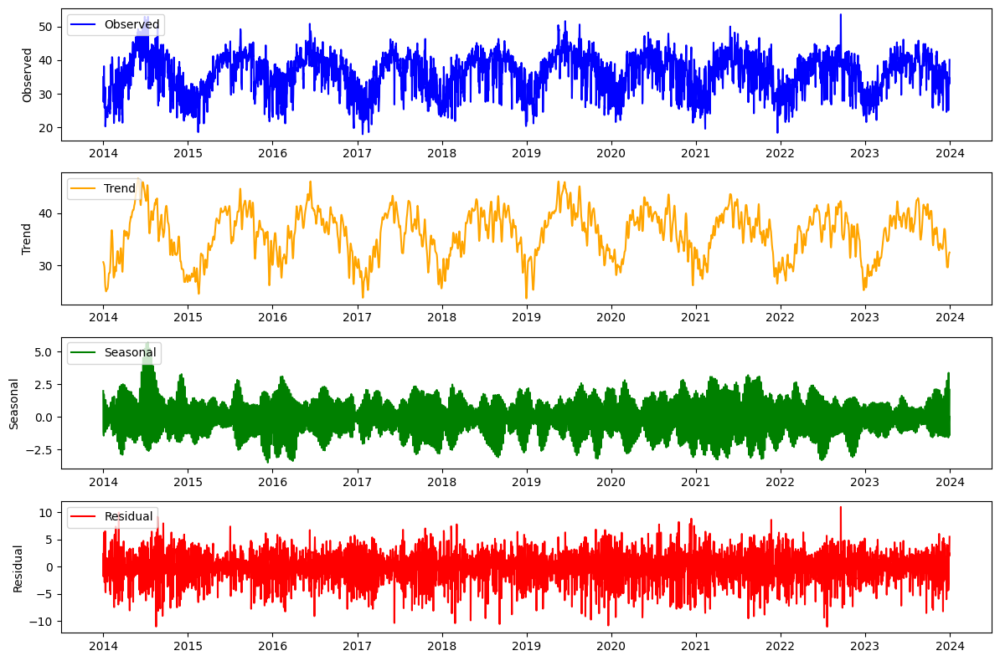

STL Decomposition for dataset: Basco


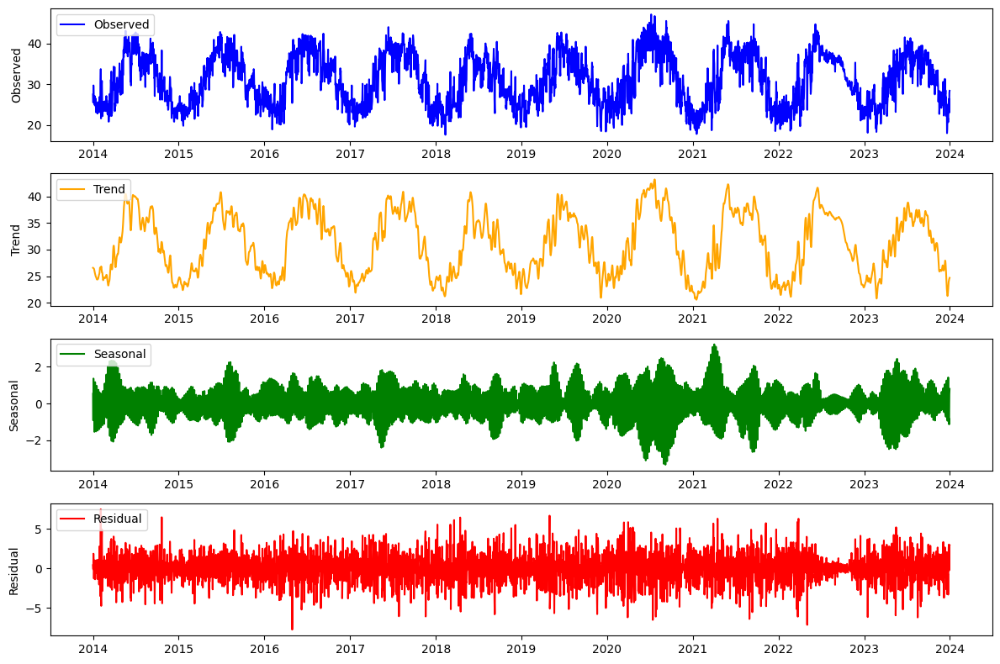

STL Decomposition for dataset: Calapan


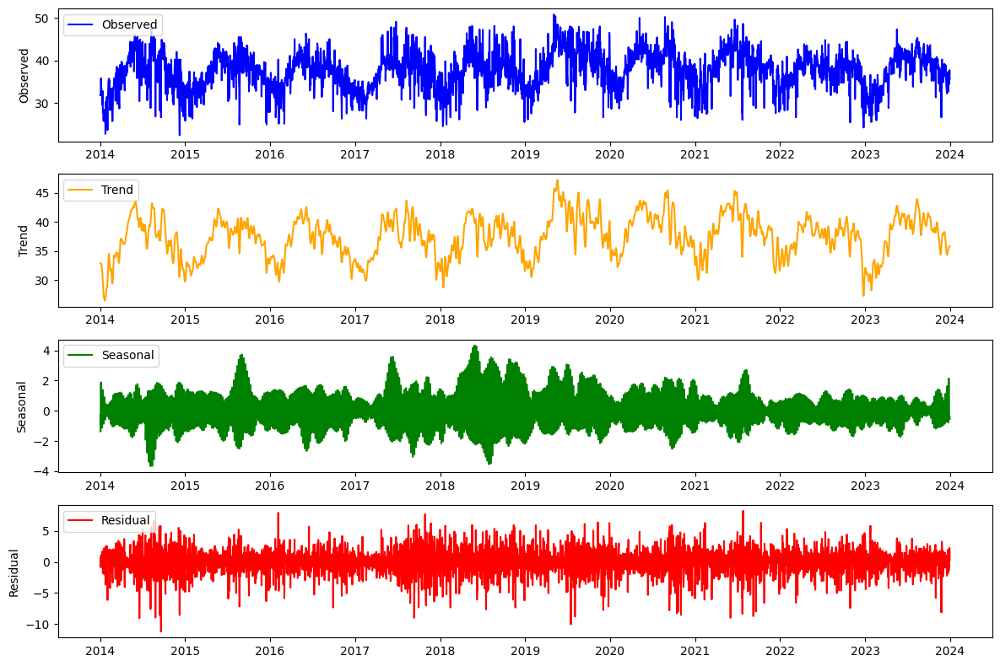

STL Decomposition for dataset: Clark


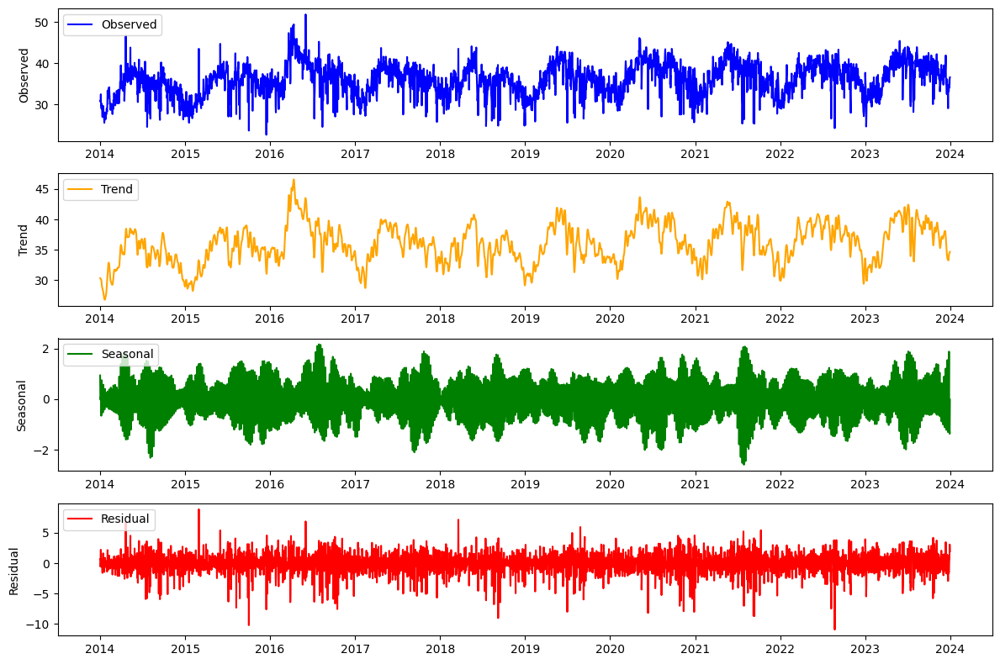

STL Decomposition for dataset: Daet


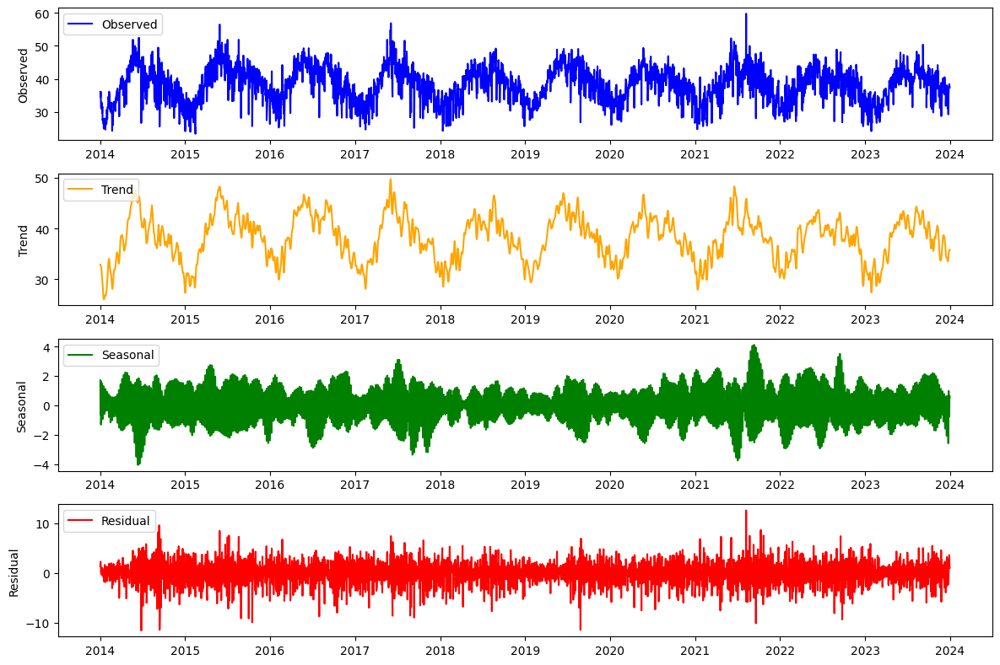

STL Decomposition for dataset: Dagupan


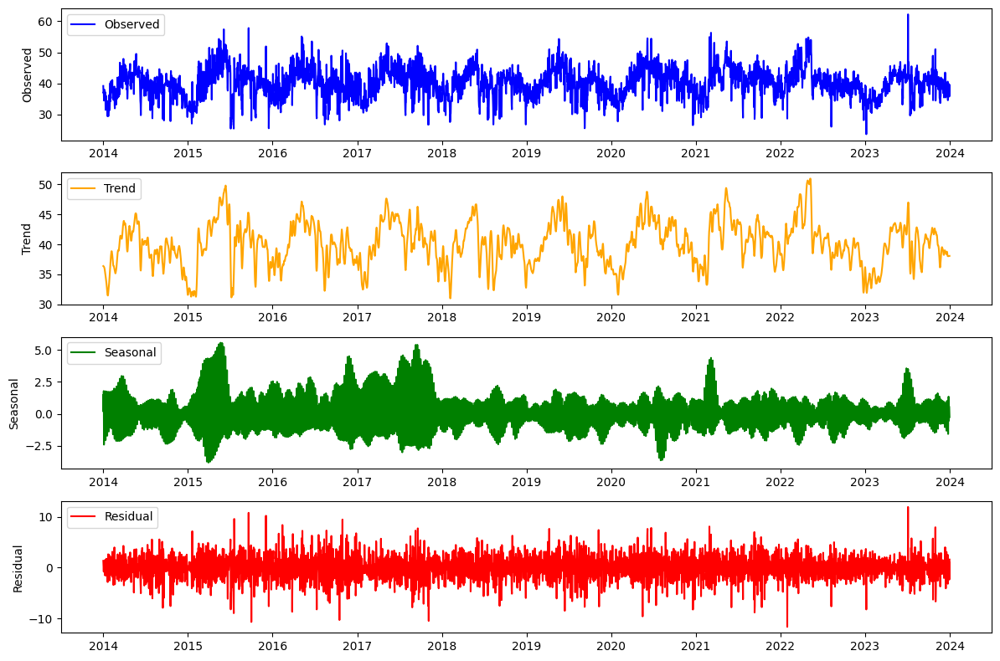

STL Decomposition for dataset: Iba


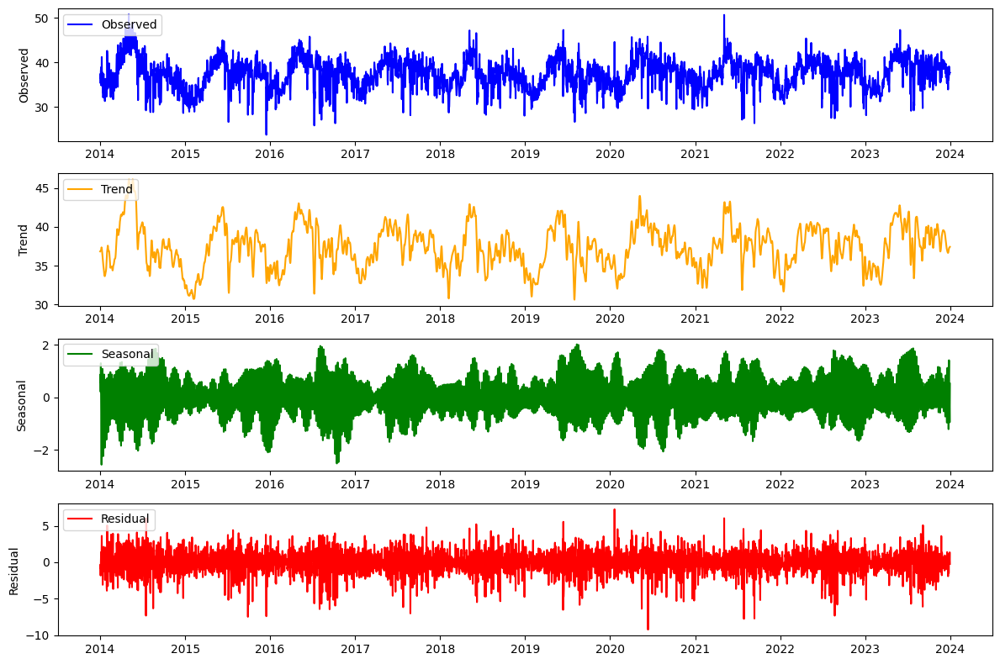

STL Decomposition for dataset: Infanta


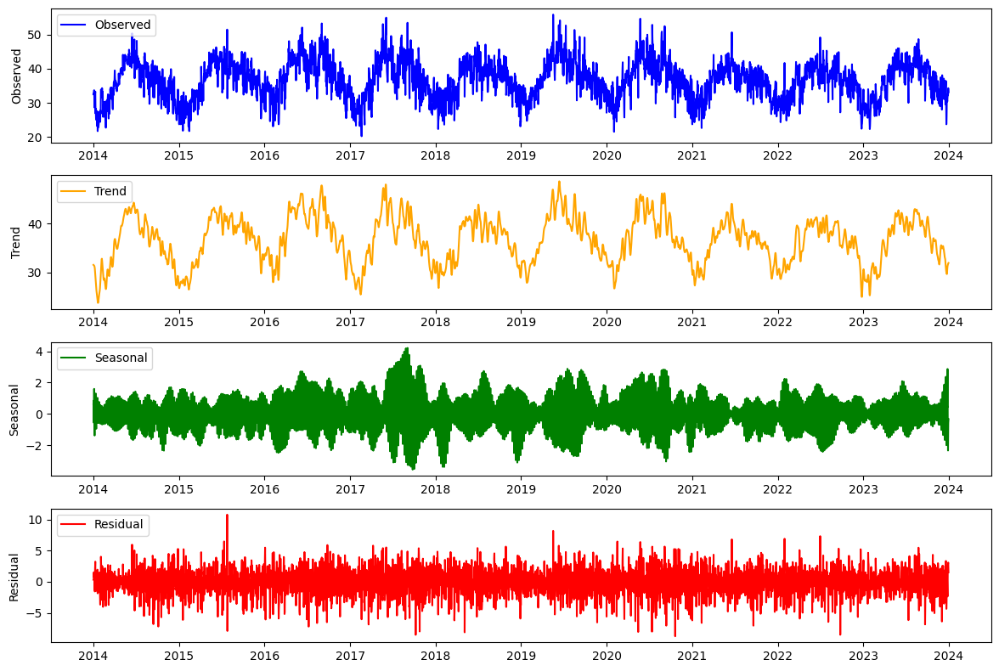

STL Decomposition for dataset: Laoag


ValueError: cannot reindex on an axis with duplicate labels

In [58]:
# Check for seasonal trends in HI using STL decomposition
for df, name in zip(dataframes, dataframe_names):
    print(f"STL Decomposition for dataset: {df.name}")
    stl_decomposition(df, 'HI')

In [872]:
df_heat_index = pd.read_excel('C:/Users/Blix/Documents/GitHub/CCTHESS1-CCTHESS2-Dev-and-Docs/datasets/Daily Maximum Heat Index Data.xls')

In [873]:
df_heat_index.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4299 entries, 0 to 4298
Data columns (total 26 columns):
 #   Column                                                               Non-Null Count  Dtype  
---  ------                                                               --------------  -----  
 0   Date(UTC)                                                            4299 non-null   object 
 1   Ambulong, Tanauan Batangas Heat.Index.Max.Dly [deg C]                3792 non-null   float64
 2   Aparri, Cagayan Heat.Index.Max.Dly [deg C]                           3621 non-null   float64
 3   Baguio City, Benguet Heat.Index.Max.Dly [deg C]                      3651 non-null   float64
 4   Baler (Radar), Aurora Heat.Index.Max.Dly [deg C]                     3652 non-null   float64
 5   Basco (Radar), Batanes Heat.Index.Max.Dly [deg C]                    3504 non-null   float64
 6   Calapan, Oriental Mindoro Heat.Index.Max.Dly [deg C]                 3651 non-null   float64
 7   Clark 

In [874]:
df_heat_index.head(5)

,Date(UTC),"Ambulong, Tanauan Batangas Heat.Index.Max.Dly [deg C]","Aparri, Cagayan Heat.Index.Max.Dly [deg C]","Baguio City, Benguet Heat.Index.Max.Dly [deg C]","Baler (Radar), Aurora Heat.Index.Max.Dly [deg C]","Basco (Radar), Batanes Heat.Index.Max.Dly [deg C]","Calapan, Oriental Mindoro Heat.Index.Max.Dly [deg C]","Clark Airport (DMIA), Pampanga Heat.Index.Max.Dly [deg C]","CLSU Muñoz, Nueva Ecija Heat.Index.Max.Dly [deg C]","Daet, Camarines Norte Heat.Index.Max.Dly [deg C]",...,"Port Area, Manila Heat.Index.Max.Dly [deg C]","Puerto Princesa City, Palawan Heat.Index.Max.Dly [deg C]","San Jose, Occidental Mindoro Heat.Index.Max.Dly [deg C]","Sangley Point, Cavite Heat.Index.Max.Dly [deg C]","Science Garden Quezon City, Metro Manila Heat.Index.Max.Dly [deg C]","Sinait, Ilocos Sur Heat.Index.Max.Dly [deg C]","Tanay, Rizal (Radar) Heat.Index.Max.Dly [deg C]","Tayabas City, Quezon Heat.Index.Max.Dly [deg C]","Tuguegarao City, Cagayan Heat.Index.Max.Dly [deg C]","Virac (Synop), Catanduanes Heat.Index.Max.Dly [deg C]"
0,2014-01-01 00:00:00,34.3,28.5,25.1,35.0,27.5,31.8,30.8,38.5,35.9,...,32.3,37.9,46.1,34.8,34.9,30.2,25.5,30.9,29.7,34.0
1,2014-01-02 00:00:00,33.3,30.2,24.1,27.6,25.5,32.1,31.0,37.7,34.4,...,32.4,39.1,42.5,36.7,34.2,30.7,24.8,31.6,34.3,33.6
2,2014-01-03 00:00:00,35.9,32.9,24.2,30.9,29.7,32.6,30.8,35.3,36.1,...,32.5,38.4,45.4,35.9,34.6,30.2,26.0,33.1,35.8,32.6
3,2014-01-04 00:00:00,38.0,29.8,23.8,38.2,27.4,35.8,32.5,38.8,31.3,...,33.2,37.1,41.6,34.8,35.1,30.5,26.0,33.2,32.9,37.7
4,2014-01-05 00:00:00,34.7,27.7,23.4,32.4,25.8,33.9,29.9,35.9,31.5,...,32.4,38.2,42.7,36.3,33.0,32.0,23.2,30.4,34.3,25.6


In [875]:
# Some dates have different time. (e.g 2014-01-01 12:00:00 vs 2014-01-01 00:00:00). If so, get the maximum value HI for that date instead of having two separate entries for the same date. Drop duplicate dates by keeping the maximum HI value.
df_heat_index['Date(UTC)'] = pd.to_datetime(df_heat_index['Date(UTC)']).dt.normalize()
df_heat_index = df_heat_index.groupby('Date(UTC)').max().reset_index()
df_heat_index.head(5)

,Date(UTC),"Ambulong, Tanauan Batangas Heat.Index.Max.Dly [deg C]","Aparri, Cagayan Heat.Index.Max.Dly [deg C]","Baguio City, Benguet Heat.Index.Max.Dly [deg C]","Baler (Radar), Aurora Heat.Index.Max.Dly [deg C]","Basco (Radar), Batanes Heat.Index.Max.Dly [deg C]","Calapan, Oriental Mindoro Heat.Index.Max.Dly [deg C]","Clark Airport (DMIA), Pampanga Heat.Index.Max.Dly [deg C]","CLSU Muñoz, Nueva Ecija Heat.Index.Max.Dly [deg C]","Daet, Camarines Norte Heat.Index.Max.Dly [deg C]",...,"Port Area, Manila Heat.Index.Max.Dly [deg C]","Puerto Princesa City, Palawan Heat.Index.Max.Dly [deg C]","San Jose, Occidental Mindoro Heat.Index.Max.Dly [deg C]","Sangley Point, Cavite Heat.Index.Max.Dly [deg C]","Science Garden Quezon City, Metro Manila Heat.Index.Max.Dly [deg C]","Sinait, Ilocos Sur Heat.Index.Max.Dly [deg C]","Tanay, Rizal (Radar) Heat.Index.Max.Dly [deg C]","Tayabas City, Quezon Heat.Index.Max.Dly [deg C]","Tuguegarao City, Cagayan Heat.Index.Max.Dly [deg C]","Virac (Synop), Catanduanes Heat.Index.Max.Dly [deg C]"
0,2014-01-01,34.3,28.5,25.1,35.0,27.5,31.8,30.8,38.5,35.9,...,32.3,37.9,46.1,34.8,34.9,30.2,25.5,30.9,29.7,34.0
1,2014-01-02,33.3,30.2,24.1,27.6,25.5,32.1,31.0,37.7,34.4,...,32.4,39.1,42.5,36.7,34.2,30.7,24.8,31.6,34.3,33.6
2,2014-01-03,35.9,32.9,24.2,30.9,29.7,32.6,30.8,35.3,36.1,...,32.5,38.4,45.4,35.9,34.6,30.2,26.0,33.1,35.8,32.6
3,2014-01-04,38.0,29.8,23.8,38.2,27.4,35.8,32.5,38.8,31.3,...,33.2,37.1,41.6,34.8,35.1,30.5,26.0,33.2,32.9,37.7
4,2014-01-05,34.7,27.7,23.4,32.4,25.8,33.9,29.9,35.9,31.5,...,32.4,38.2,42.7,36.3,33.0,32.0,23.2,30.4,34.3,25.6


In [876]:
df_heat_index.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3652 entries, 0 to 3651
Data columns (total 26 columns):
 #   Column                                                               Non-Null Count  Dtype         
---  ------                                                               --------------  -----         
 0   Date(UTC)                                                            3652 non-null   datetime64[ns]
 1   Ambulong, Tanauan Batangas Heat.Index.Max.Dly [deg C]                3647 non-null   float64       
 2   Aparri, Cagayan Heat.Index.Max.Dly [deg C]                           3621 non-null   float64       
 3   Baguio City, Benguet Heat.Index.Max.Dly [deg C]                      3651 non-null   float64       
 4   Baler (Radar), Aurora Heat.Index.Max.Dly [deg C]                     3652 non-null   float64       
 5   Basco (Radar), Batanes Heat.Index.Max.Dly [deg C]                    3504 non-null   float64       
 6   Calapan, Oriental Mindoro Heat.Index.Max.Dly [de

In [877]:
# Export cleaned heat_index dataset to CSV for future use
# df_heat_index.to_csv('C:/Users/Blix/Documents/GitHub/CCTHESS1-CCTHESS2-Dev-and-Docs/datasets/cleaned_heat_index_data.csv', index=False)

In [878]:
# Plot time-series graph for each column in df_heat_index. Date(UTC) on x-axis, and each column on y-axis.
def plot_heat_index_time_series(df):
    for col in df.columns:
        if col != 'Date(UTC)':
            plt.figure(figsize=(12, 6))
            plt.plot(df['Date(UTC)'], df[col], marker='o', linestyle='-', markersize=3)
            plt.title(f'Time Series of {col}')
            plt.xlabel('Date(UTC)')
            plt.ylabel(col)
            plt.xticks(rotation=45)
            plt.grid()
            plt.legend()
            plt.tight_layout()
            plt.show()

C:\Users\Blix\AppData\Local\Temp\ipykernel_25712\3415578785.py:12: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


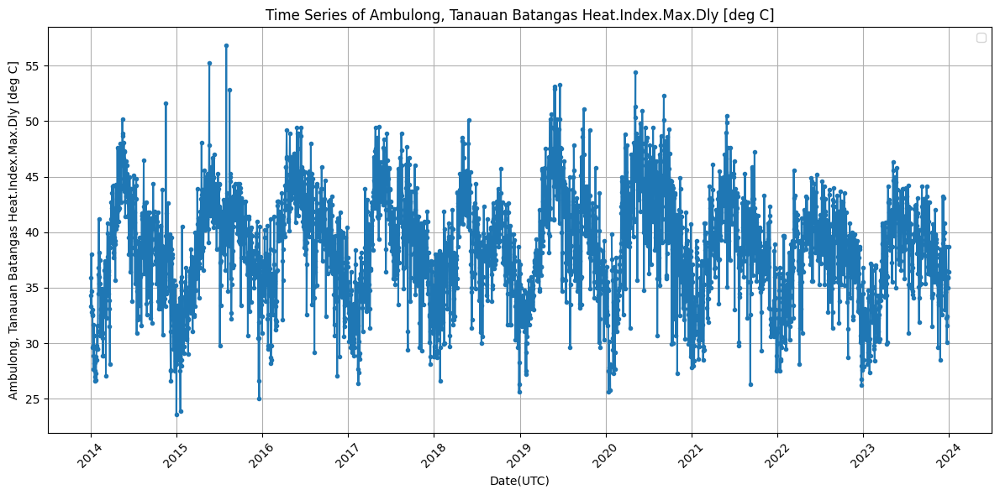

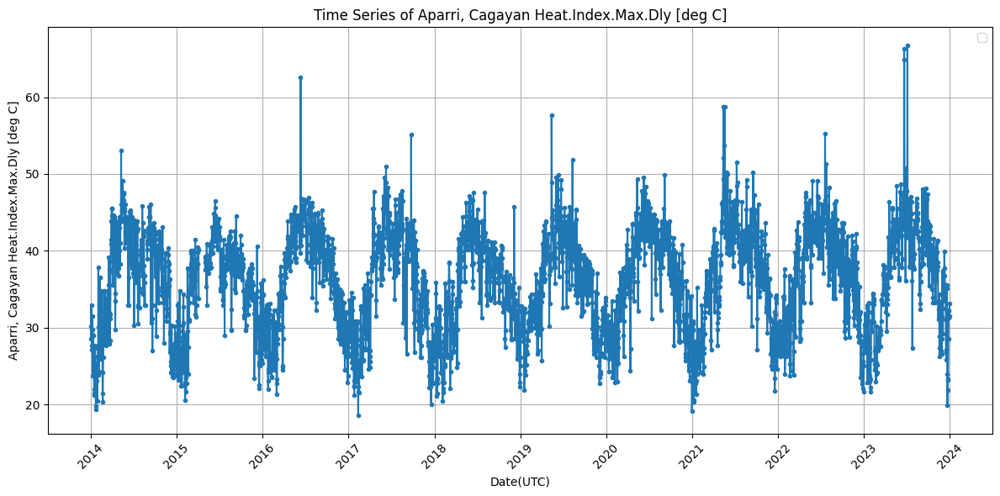

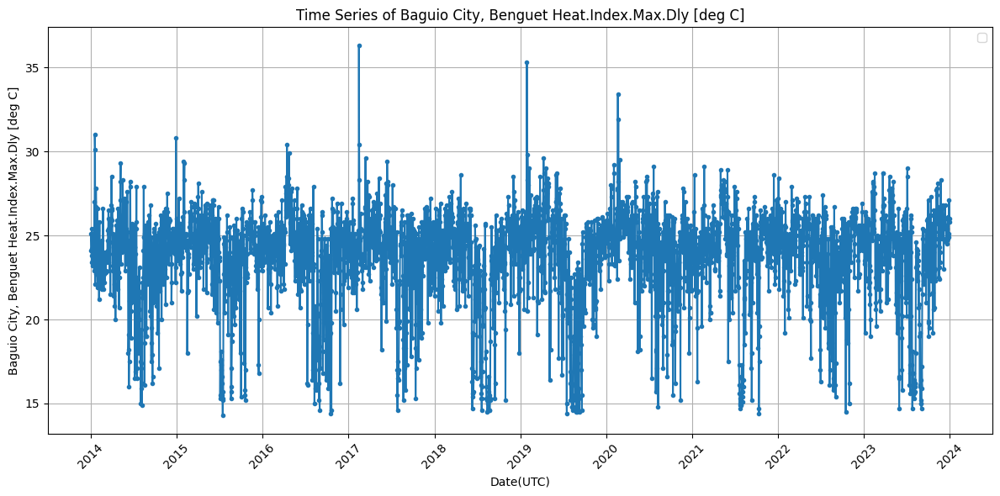

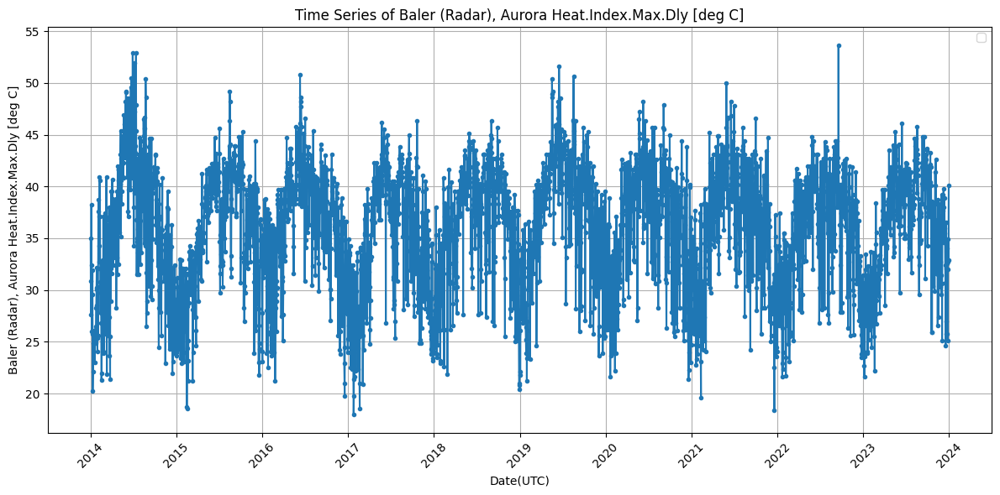

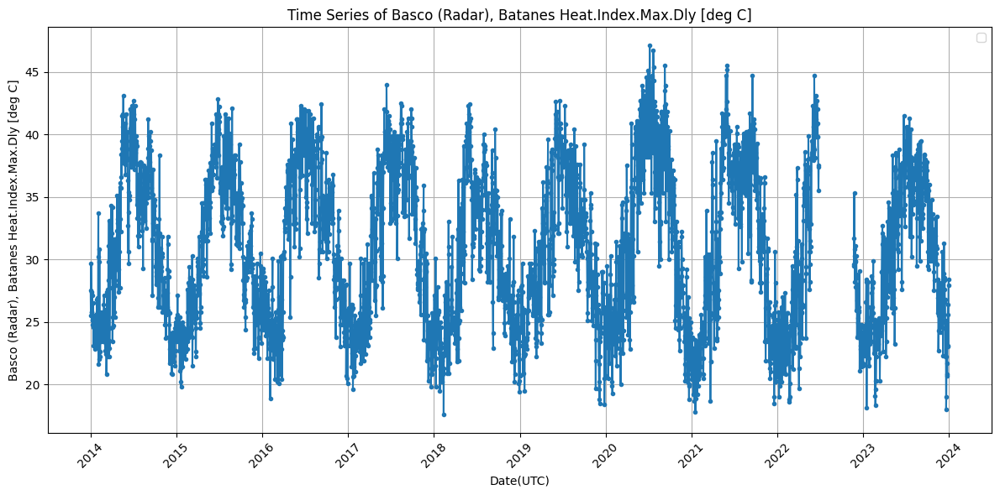

...

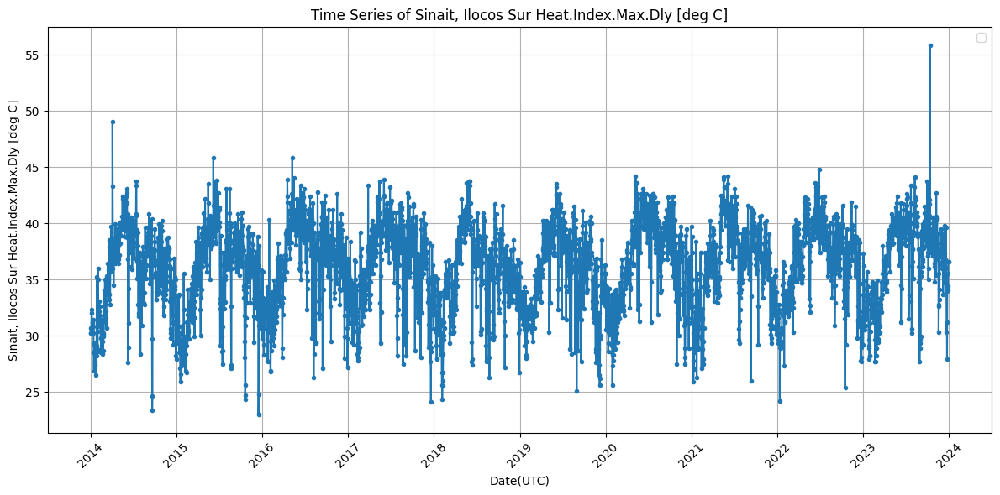

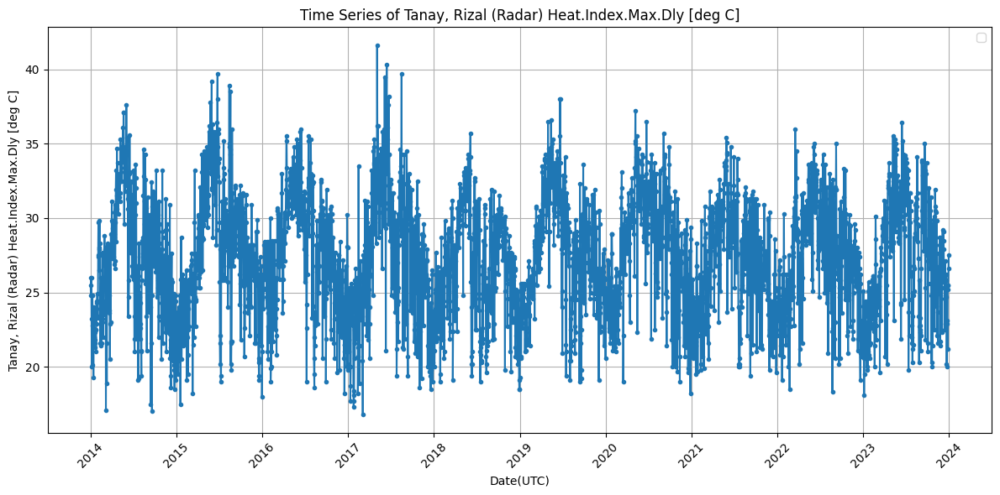

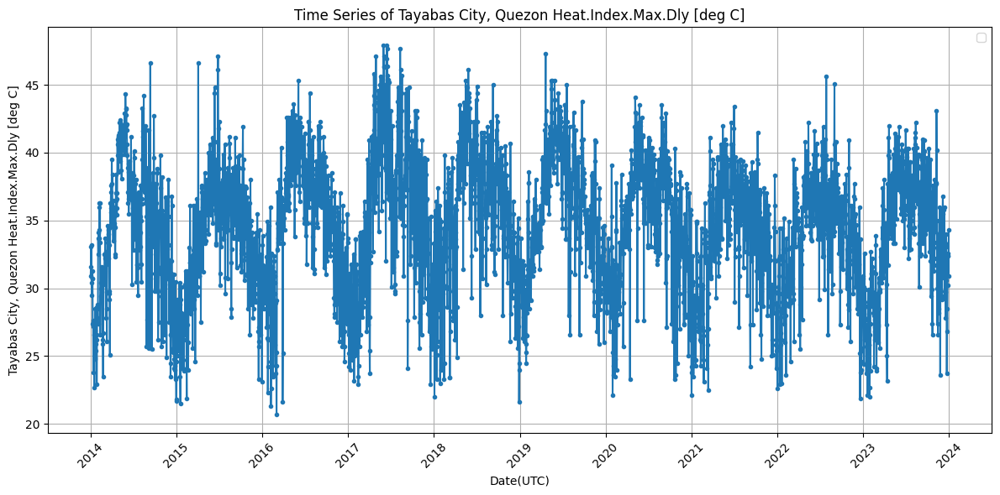

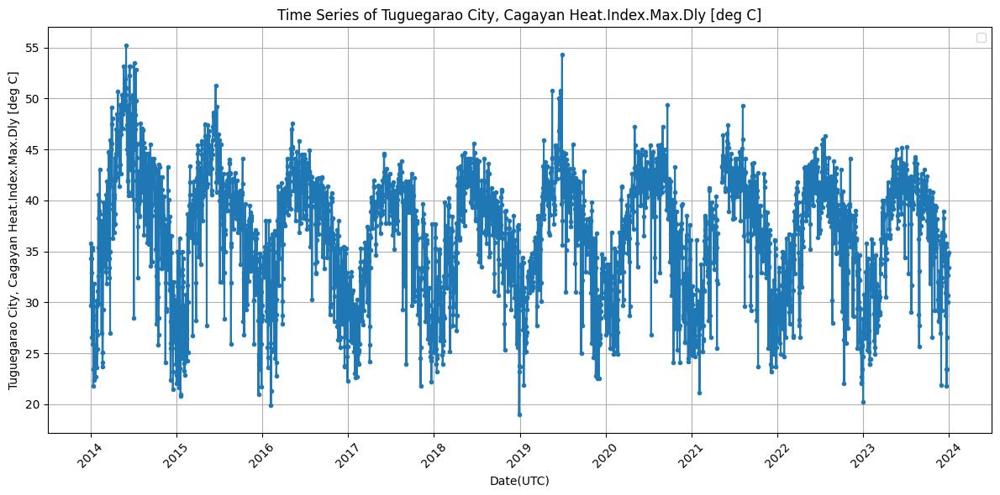

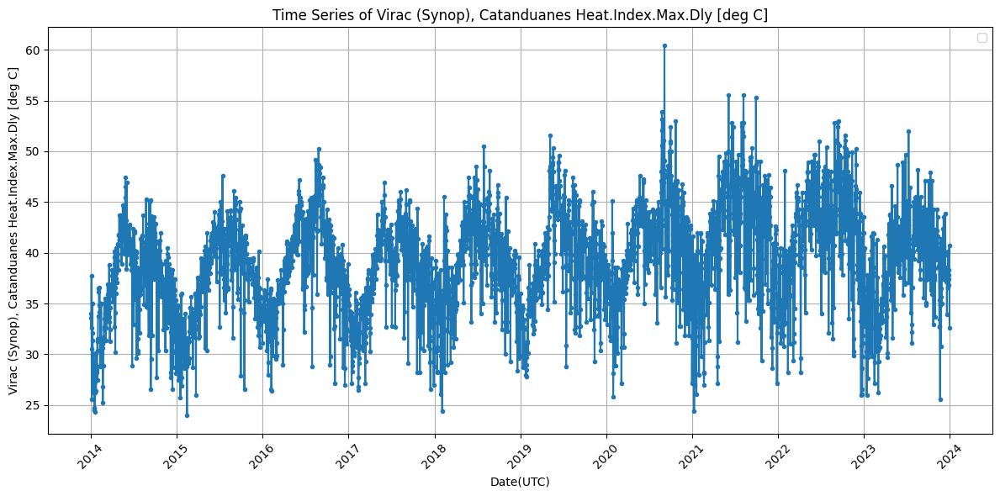

In [879]:
plot_heat_index_time_series(df_heat_index)

In [880]:
# Rename columns of df_heat_index to get only the first word per column. Remove any extra commas in the column.
df_heat_index.columns = [col.split()[0] for col in df_heat_index.columns]
df_heat_index.head(5)

,Date(UTC),"Ambulong,","Aparri,",Baguio,Baler,Basco,"Calapan,",Clark,CLSU,"Daet,",...,Port,Puerto,San,Sangley,Science,"Sinait,","Tanay,",Tayabas,Tuguegarao,Virac
0,2014-01-01,34.3,28.5,25.1,35.0,27.5,31.8,30.8,38.5,35.9,...,32.3,37.9,46.1,34.8,34.9,30.2,25.5,30.9,29.7,34.0
1,2014-01-02,33.3,30.2,24.1,27.6,25.5,32.1,31.0,37.7,34.4,...,32.4,39.1,42.5,36.7,34.2,30.7,24.8,31.6,34.3,33.6
2,2014-01-03,35.9,32.9,24.2,30.9,29.7,32.6,30.8,35.3,36.1,...,32.5,38.4,45.4,35.9,34.6,30.2,26.0,33.1,35.8,32.6
3,2014-01-04,38.0,29.8,23.8,38.2,27.4,35.8,32.5,38.8,31.3,...,33.2,37.1,41.6,34.8,35.1,30.5,26.0,33.2,32.9,37.7
4,2014-01-05,34.7,27.7,23.4,32.4,25.8,33.9,29.9,35.9,31.5,...,32.4,38.2,42.7,36.3,33.0,32.0,23.2,30.4,34.3,25.6


In [881]:
# Check for null values in all dataframes except heat index dataframe
for df, name in zip(dataframes, dataframe_names):
    null_counts = df.isna().sum()
    total_nulls = null_counts.sum()
    if total_nulls == 0:
        print(f"No null values in dataset: {name}")
    else:
        print(f"Dataset: {name} has {total_nulls} null values in columns:\n{null_counts[null_counts > 0]}")

No null values in dataset: Ambulong
No null values in dataset: Baguio
No null values in dataset: Baler
No null values in dataset: Basco
No null values in dataset: Calapan
No null values in dataset: Clark
No null values in dataset: Daet
No null values in dataset: Dagupan
No null values in dataset: Iba
No null values in dataset: Infanta
No null values in dataset: Laoag
No null values in dataset: Legazpi
No null values in dataset: NAIA
No null values in dataset: Port Area
No null values in dataset: Puerto Princesa
No null values in dataset: San Jose
No null values in dataset: Sangley Point
No null values in dataset: Science Garden
No null values in dataset: Sinait
No null values in dataset: Tanay
No null values in dataset: Tayabas
No null values in dataset: Tuguegarao
No null values in dataset: Virac Synop


In [882]:
# Check if the number of rows are matching for all dataframes, else print the number of rows for each dataframe
num_rows = [len(df) for df in dataframes]
if len(set(num_rows)) == 1:
    print(f"All datasets have the same number of rows: {num_rows[0]}")
else:
    for df, name in zip(dataframes, dataframe_names):
        print(f"Dataset: {name} has {len(df)} rows")


All datasets have the same number of rows: 3652


In [883]:
# Include Station Column for each dataframe
for df, name in zip(dataframes, dataframe_names):
    df['Station'] = name

In [884]:
def create_rothfusz_vectorized(T_celsius, RH_percent):
    """
    Calculates the Rothfusz heat index for entire pandas Series at once.
    This version handles potential negative values in the sqrt calculation.
    T_celsius: Temperature in Celsius
    RH_percent: Relative Humidity in percentage (0-100)
    Returns a pandas Series of the Heat Index in Celsius.
    """
    # 1. Convert T to Fahrenheit
    T_fahrenheit = T_celsius * 9/5 + 32
    
    # 2. Calculate the core Rothfusz regression formula
    HI_fahrenheit = (-42.379 + 2.04901523 * T_fahrenheit + 10.14333127 * RH_percent
                     - 0.22475541 * T_fahrenheit * RH_percent - 6.83783e-3 * T_fahrenheit**2
                     - 5.481717e-2 * RH_percent**2 + 1.22874e-3 * T_fahrenheit**2 * RH_percent
                     + 8.5282e-4 * T_fahrenheit * RH_percent**2 - 1.99e-6 * T_fahrenheit**2 * RH_percent**2)
    
    # 3. Apply the two specific Rothfusz adjustments using numpy.where
    # Adjustment for low humidity
    cond1 = (RH_percent < 13) & (T_fahrenheit >= 80) & (T_fahrenheit <= 112)
    # Clamp the value inside sqrt to be non-negative
    sqrt_val = np.maximum(0, (17 - np.abs(T_fahrenheit - 95)) / 17)
    adjustment1 = ((13 - RH_percent) / 4) * np.sqrt(sqrt_val)
    HI_fahrenheit = np.where(cond1, HI_fahrenheit - adjustment1, HI_fahrenheit)

    # Adjustment for high humidity
    cond2 = (RH_percent > 85) & (T_fahrenheit >= 80) & (T_fahrenheit <= 87)
    adjustment2 = ((RH_percent - 85) / 10) * ((87 - T_fahrenheit) / 5)
    HI_fahrenheit = np.where(cond2, HI_fahrenheit + adjustment2, HI_fahrenheit)

    # 4. Apply the simplified formulas for lower temperatures
    # For T < 79°F
    HI_fahrenheit = np.where(T_fahrenheit < 79, -10.3 + 1.1 * T_fahrenheit + 0.047 * RH_percent, HI_fahrenheit)
    
    # For T <= 40°F
    HI_fahrenheit = np.where(T_fahrenheit <= 40, T_fahrenheit, HI_fahrenheit)

    # 5. Convert the final result back to Celsius
    HI_celsius = (HI_fahrenheit - 32) * 5/9
    return HI_celsius

In [885]:
# Create new column 'HI_Calculated' in each dataframe using create_rothfusz function
for i, (df, name) in enumerate(zip(dataframes, dataframe_names)):
    df['HI_Calculated'] = create_rothfusz_vectorized(df['TMAX'], df['RH'])
    df['Rothfusz_Residuals'] = df['HI'] - df['HI_Calculated']
    average_residuals = np.average(df['Rothfusz_Residuals'])
    dataframes[i] = df  # Update the dataframe in the list
    print(f"Calculated HI_Calculated for dataset: {name}, MAE: {average_residuals}")

Calculated HI_Calculated for dataset: Ambulong, MAE: -7.444726323071417
Calculated HI_Calculated for dataset: Baguio, MAE: -0.802493679966652
Calculated HI_Calculated for dataset: Baler, MAE: -5.829606148505733
Calculated HI_Calculated for dataset: Basco, MAE: -2.749775674678429
Calculated HI_Calculated for dataset: Calapan, MAE: -8.18924084809346
Calculated HI_Calculated for dataset: Clark, MAE: -6.406136335256168
Calculated HI_Calculated for dataset: Daet, MAE: -5.086671976035827
Calculated HI_Calculated for dataset: Dagupan, MAE: -6.7316554705293195
Calculated HI_Calculated for dataset: Iba, MAE: -5.142263871001189
Calculated HI_Calculated for dataset: Infanta, MAE: -6.656155926086311
Calculated HI_Calculated for dataset: Laoag, MAE: -4.850129093586185
Calculated HI_Calculated for dataset: Legazpi, MAE: -5.063139203921357
Calculated HI_Calculated for dataset: NAIA, MAE: -7.239965865401124
Calculated HI_Calculated for dataset: Port Area, MAE: -5.784372409459882
Calculated HI_Calculat

In [886]:
for df, name in zip(dataframes, dataframe_names):
    df.name = name  # Assign name attribute to dataframe
    sanity_check(df)
    print("\n" + "="*50 + "\n")

Sanity Check for dataset: Ambulong
First 5 rows of the dataframe:
        Date  YEAR  MONTH  DAY  TMAX  TMIN    RH  WIND_SPEED  WIND_DIRECTION  \
0 2014-01-01  2014      1    1  30.4  22.8  74.0         2.0            40.0   
1 2014-01-02  2014      1    2  29.9  20.0  74.0         2.0            40.0   
2 2014-01-03  2014      1    3  31.0  20.5  79.0         1.0            40.0   
3 2014-01-04  2014      1    4  32.0  22.5  76.0         1.0            40.0   
4 2014-01-05  2014      1    5  30.6  23.0  75.0         2.0            40.0   

     HI  ...  NDBI_spline  NDVI_original  NDWI_linear  NDWI_spline   Latitude  \
0  34.3  ...    -0.199351       0.664753    -0.336428    -0.333871  14.090081   
1  33.3  ...    -0.199470       0.444930    -0.336428    -0.333871  14.090081   
2  35.9  ...    -0.199588       0.567675    -0.336428    -0.333871  14.090081   
3  38.0  ...    -0.199705       0.628662    -0.336428    -0.333871  14.090081   
4  34.7  ...    -0.199823       0.528463    -0.3

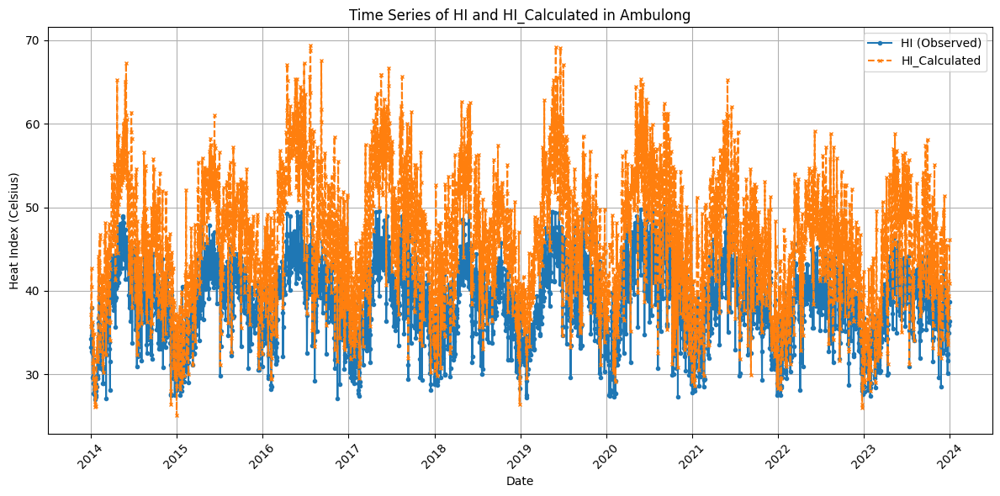

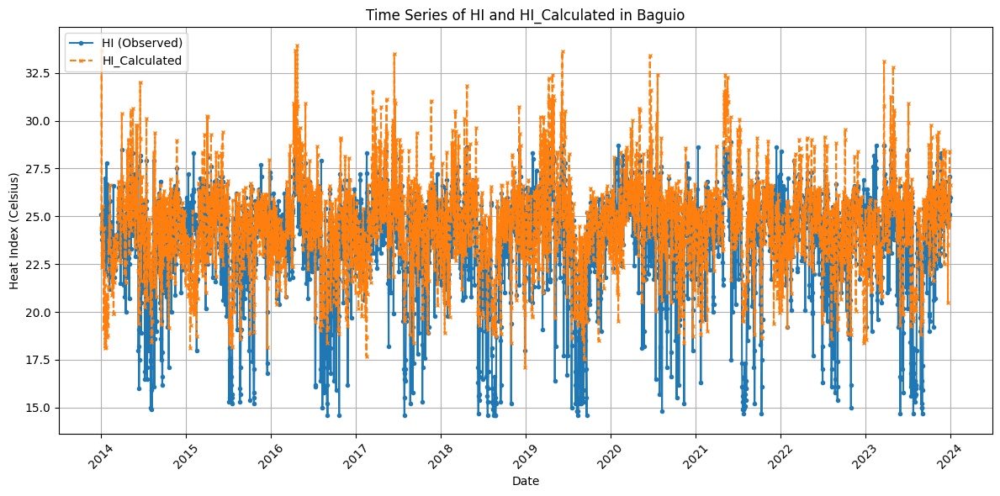

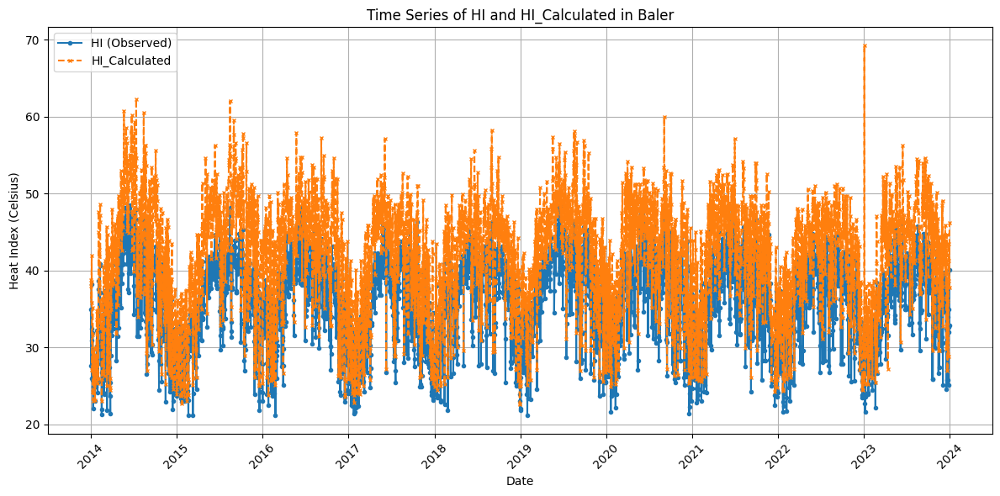

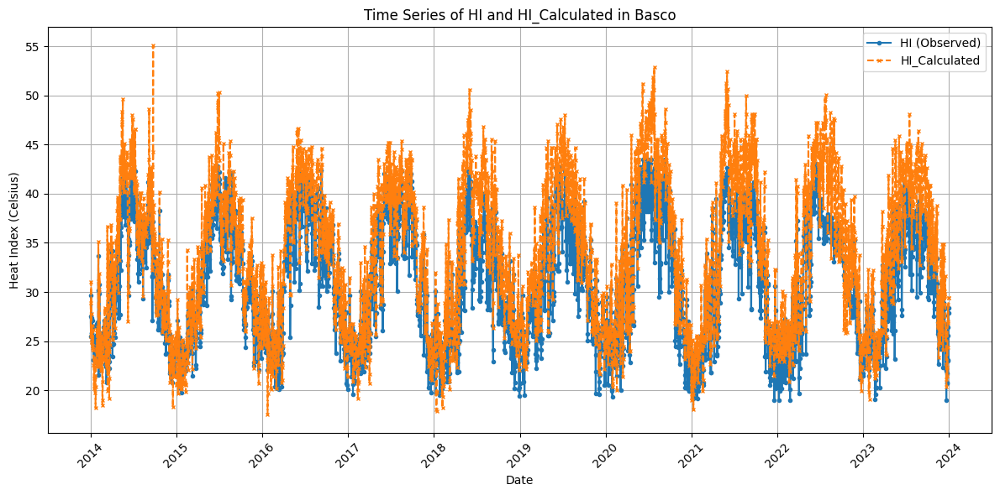

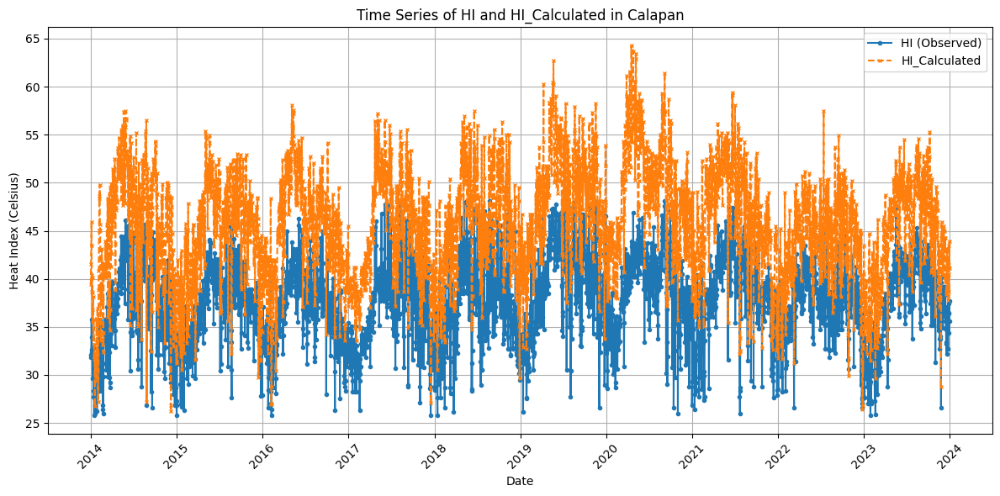

...

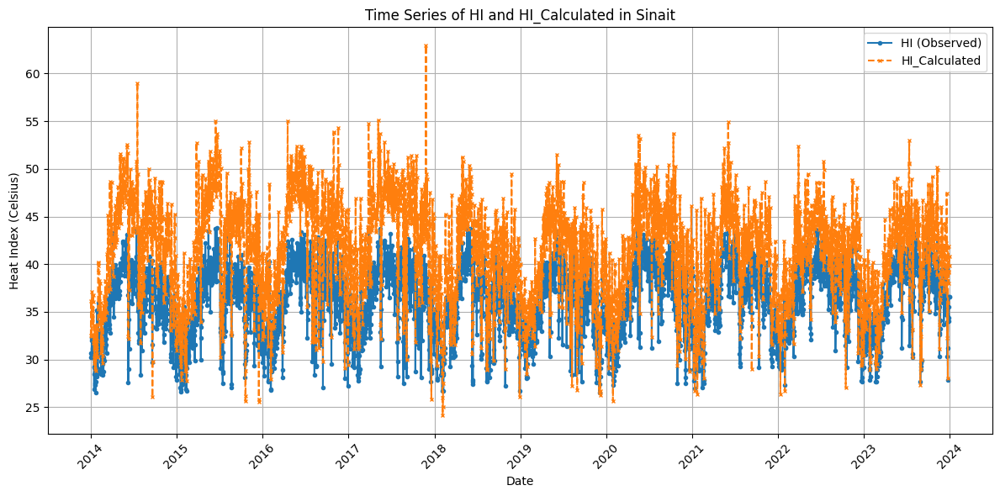

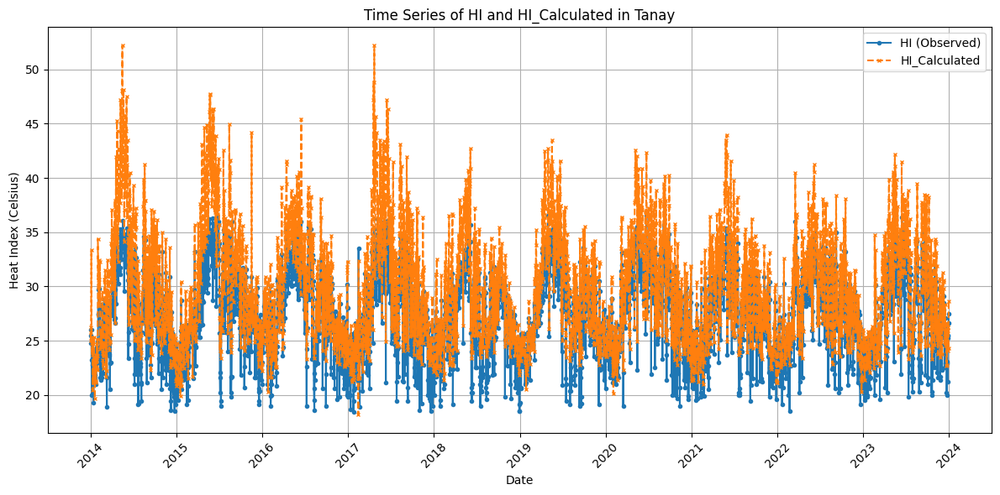

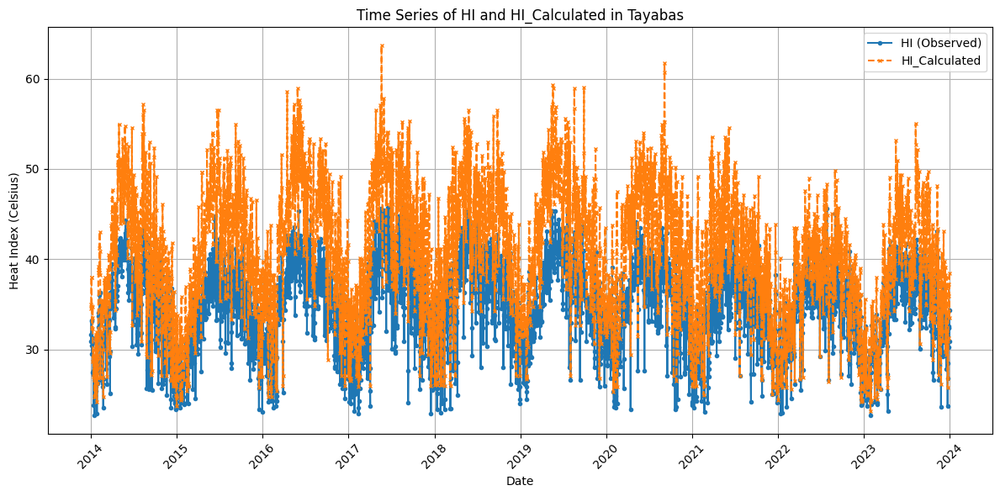

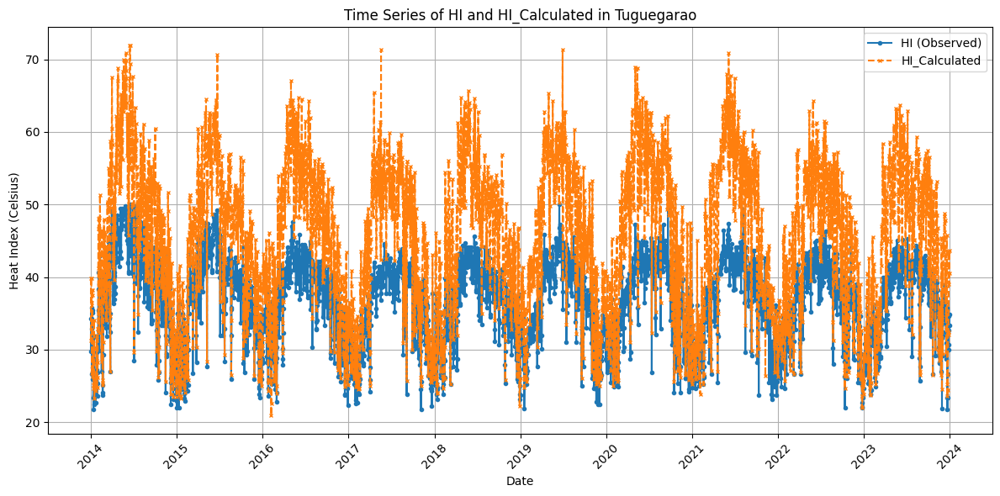

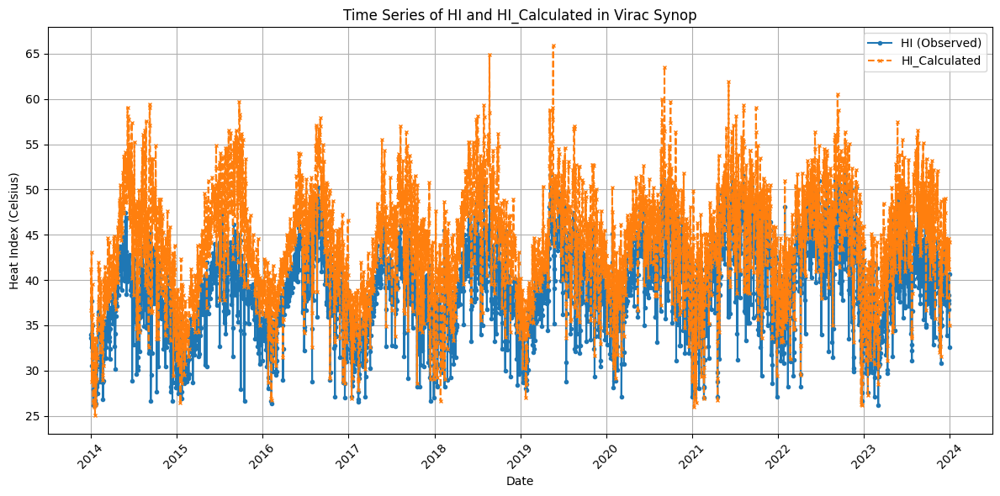

In [888]:
# Plot time-series graph of HI and HI_Calculated for each dataset. Date on x-axis, HI and HI_Calculated on y-axis.
for i, (df, name) in enumerate(zip(dataframes, dataframe_names)):
    plt.figure(figsize=(12, 6))
    plt.plot(df['Date'], df['HI'], marker='o', linestyle='-', markersize=3, label='HI (Observed)')
    plt.plot(df['Date'], df['HI_Calculated'], marker='x', linestyle='--', markersize=3, label='HI_Calculated')
    plt.title(f'Time Series of HI and HI_Calculated in {name}')
    plt.xlabel('Date')
    plt.ylabel('Heat Index (Celsius)')
    plt.xticks(rotation=45)
    plt.grid()
    plt.legend()
    plt.tight_layout()
    plt.show()

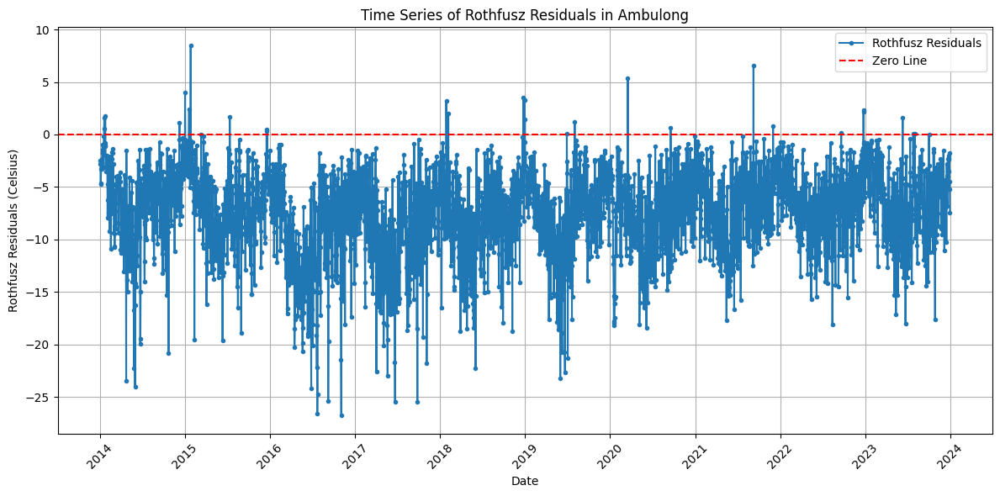

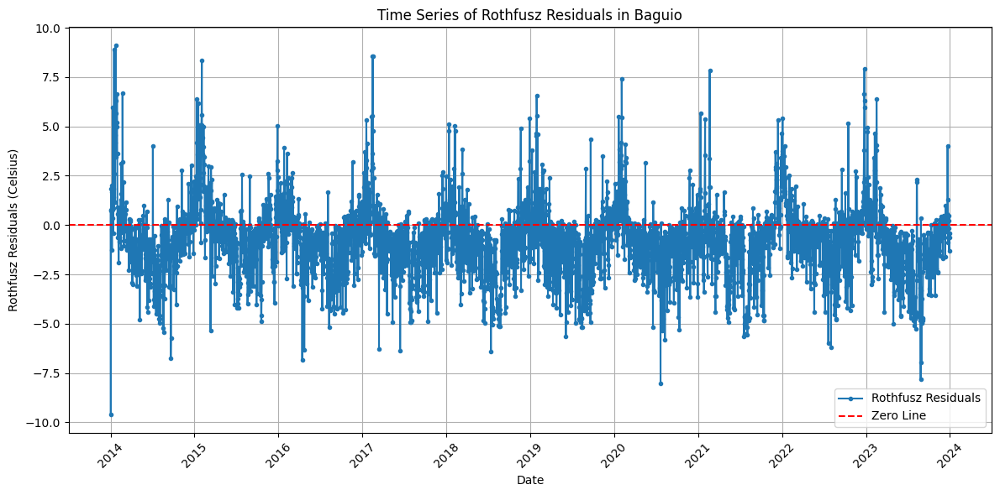

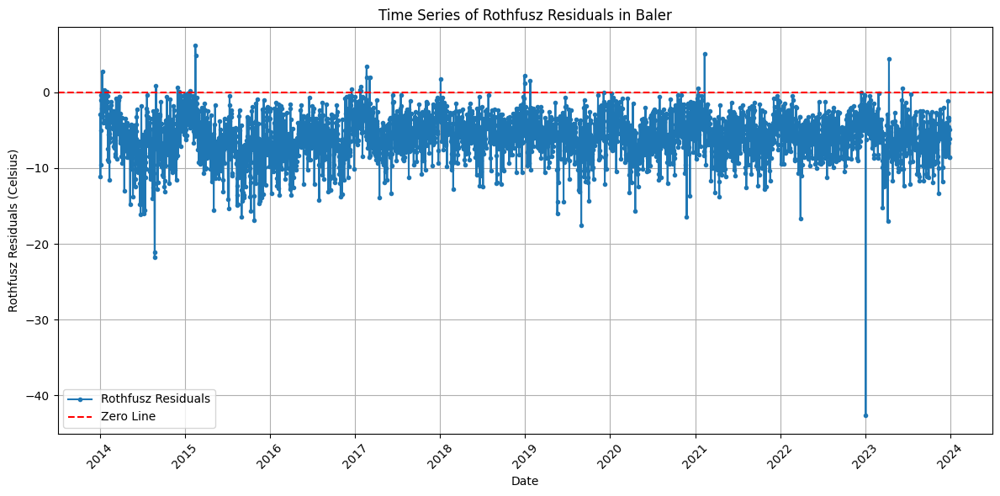

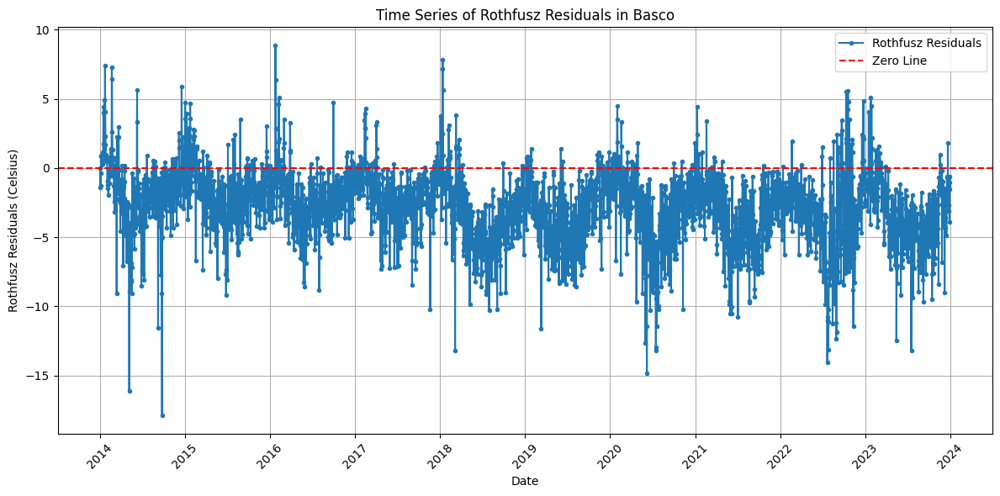

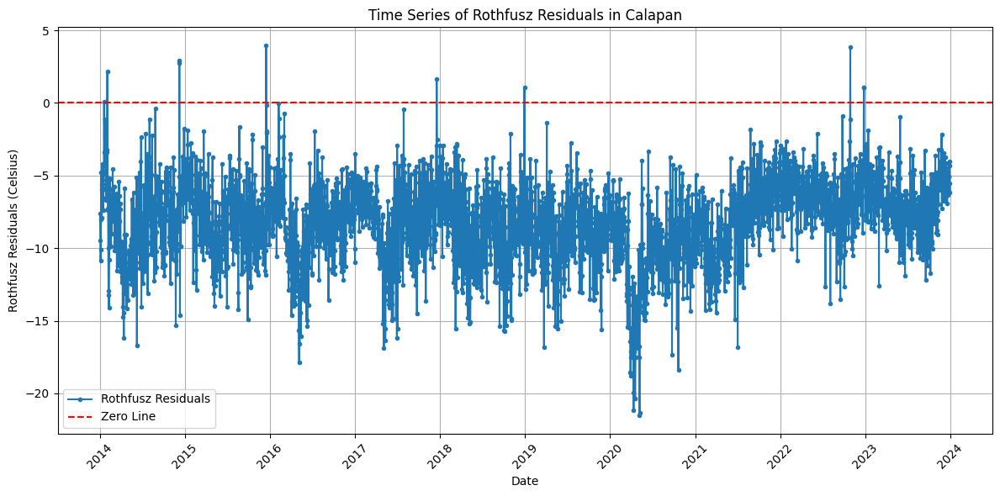

...

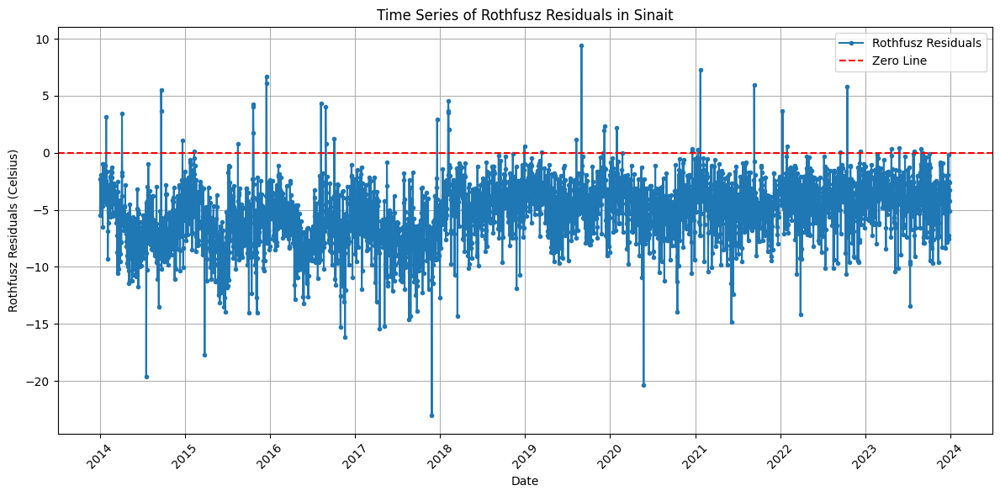

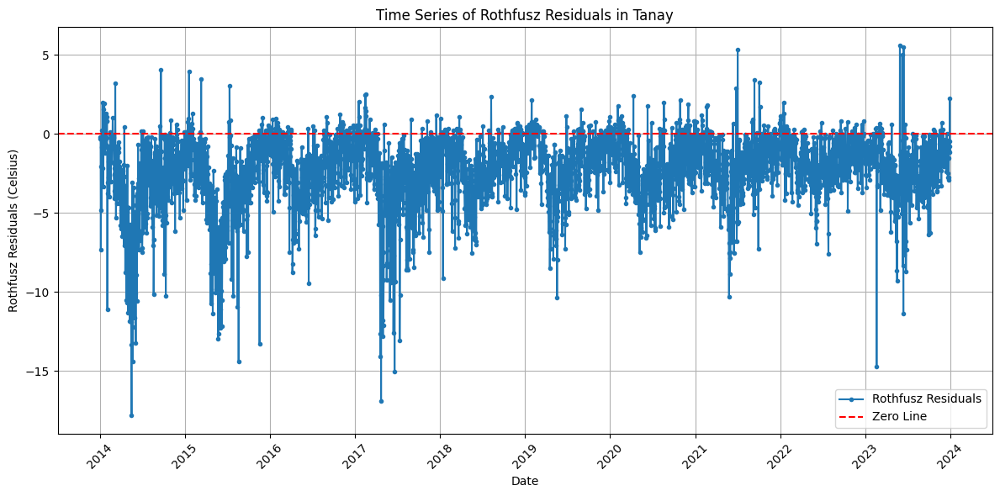

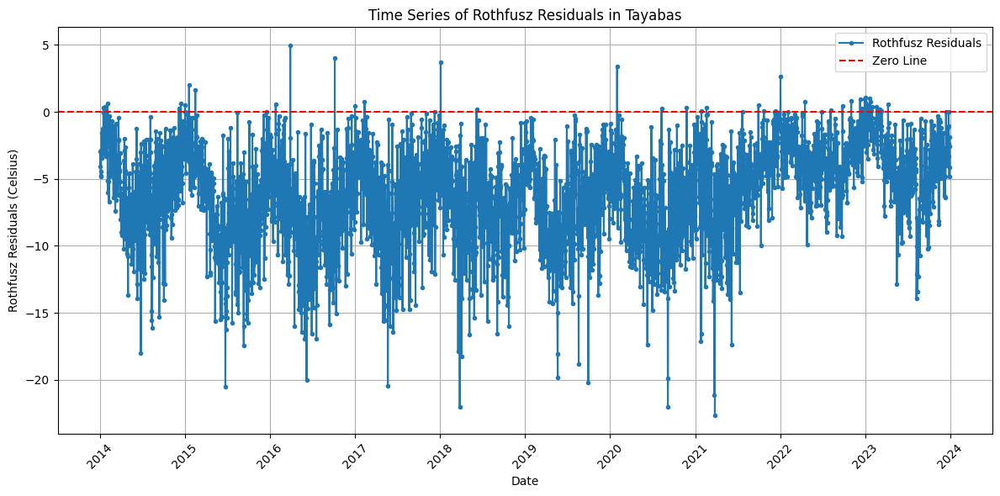

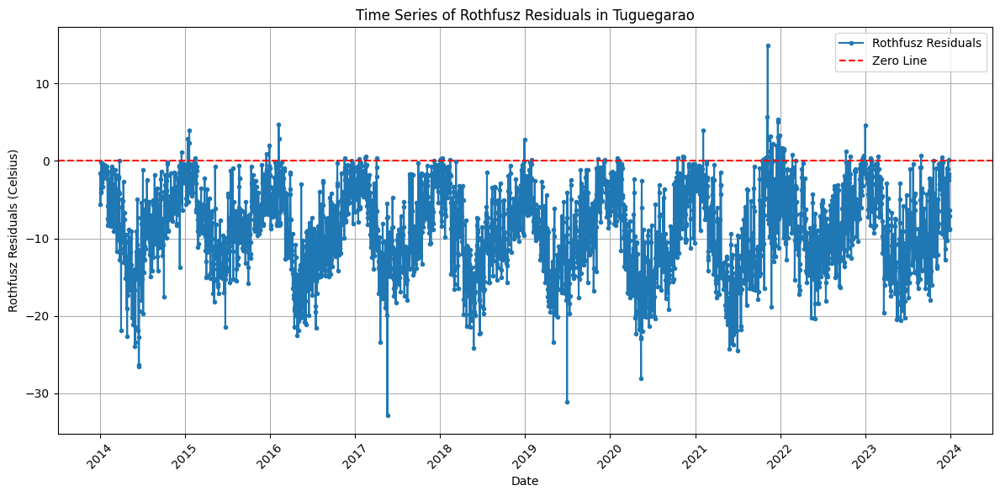

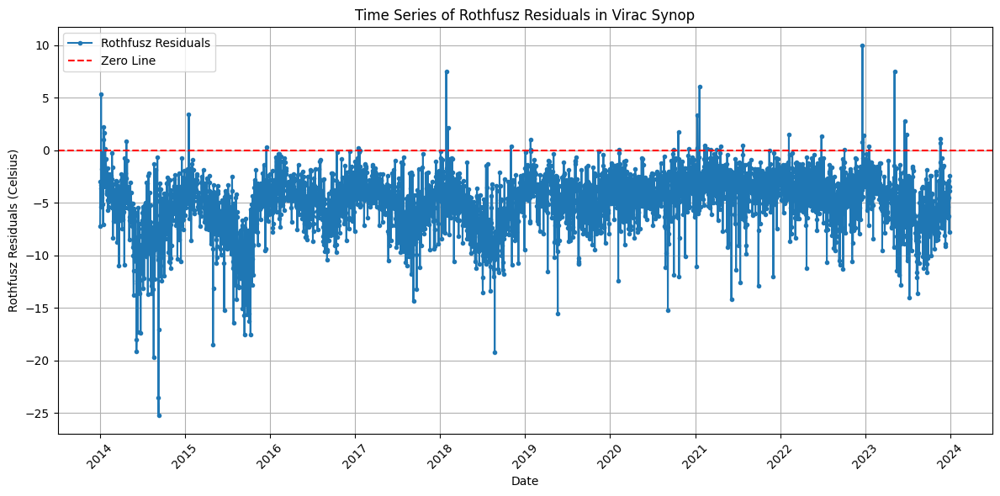

In [889]:
# Plot Residuals of HI - HI_Calculated for each dataset. Date on x-axis, Residuals on y-axis.
for i, (df, name) in enumerate(zip(dataframes, dataframe_names)):
    plt.figure(figsize=(12, 6))
    plt.plot(df['Date'], df['Rothfusz_Residuals'], marker='o', linestyle='-', markersize=3, label='Rothfusz Residuals')
    plt.axhline(0, color='red', linestyle='--', label='Zero Line')
    plt.title(f'Time Series of Rothfusz Residuals in {name}')
    plt.xlabel('Date')
    plt.ylabel('Rothfusz Residuals (Celsius)')
    plt.xticks(rotation=45)
    plt.grid()
    plt.legend()
    plt.tight_layout()
    plt.show()

In [890]:
def add_season(df):
    """
    Adds a binary column for Philippine season.
    The climate of the country can be divided into two major seasons: 
    (1) the wet season, from June to November; and 
    (2) the dry season, from December to May. 
    The dry season may be subdivided further into :
    (a) the cool dry season, from December to February; 
    and (b) the hot dry season, from March to May.
    """
    df['is_dry_season'] = df['MONTH'].apply(lambda x: 1 if x in [12, 1, 2, 3, 4, 5] else 0)
    df['is_wet_season'] = df['MONTH'].apply(lambda x: 1 if x in [6, 7, 8, 9, 10, 11] else 0)
    df['is_cool_dry_season'] = df['MONTH'].apply(lambda x: 1 if x in [12, 1, 2] else 0)
    df['is_hot_dry_season'] = df['MONTH'].apply(lambda x: 1 if x in [3, 4, 5] else 0)
    return df

In [891]:
# Calculate Saturation Vapor Pressure (SVP), Vapor Pressure Deficit (VPD), and actual Vapor Pressure using TMAX and RH
def add_vpd_features_TMAX(df):

    # Saturation Vapor Pressure using Tetens formula
    df['Saturation Vapor Pressure'] = 0.6108 * np.exp((17.27 * df['TMAX']) / (df['TMAX'] + 237.3))
    
    # Actual Vapor Pressure (kPa) 
    df['Actual Vapor Pressure'] = (df['RH'] / 100.0) * df['Saturation Vapor Pressure']
    
    # Vapor Pressure Deficit (kPa)
    df['Vapor Pressure Deficit'] = df['Saturation Vapor Pressure'] - df['Actual Vapor Pressure']
    
    return df


In [892]:
def add_quadratic_interaction_features(df):
    df['T^2'] = df['TMAX']**2
    df['RH^2'] = df['RH']**2
    df['TxRH'] = df['TMAX'] * df['RH']

    return df

In [893]:
def add_wetbulb_temperature(df):
    term1 = df['TMAX'] * np.arctan(0.151977 * np.sqrt(df['RH'] + 8.313659))
    term2 = np.arctan(df['TMAX'] + df['RH'])
    term3 = np.arctan(df['RH'] - 1.676331)
    term4 = 0.00391838 * df['RH']**1.5 * np.arctan(0.023101 * df['RH'])
    
    df['Tw'] = term1 + term2 - term3 + term4 - 4.686035
    return df

In [894]:
# Create diurnal temperature range (DTR) feature using TMAX and TMIN
def add_dtr_feature(df):
    df['DTR'] = df['TMAX'] - df['TMIN']
    return df

In [895]:
# Create lag features for HI.
def create_lag_features(df, column, lagdays):
    for lag in range(1, lagdays):
        df[f'{column}_lag_{lag}'] = df[column].shift(lag)
    return df

In [896]:
# Create multi-step ahead target variable for HI (2-day ahead)
def create_multi_step_target(df, steps_ahead):
    for step in range(1, steps_ahead + 1):
        df[f'HI_{step}day_forecast'] = df['HI'].shift(-step)
        df[f'TMAX_{step}day_forecast'] = df['TMAX'].shift(-step)
        df[f'RH_{step}day_forecast'] = df['RH'].shift(-step)
        df[f'Rothfusz_{step}day_forecast'] = df['Rothfusz_Residuals'].shift(-step)
    return df

In [ ]:
# Create window_length-day HI Rolling Mean and STD feature.
def add_rolling_windows(df, window_length):
    df[f'HI_Rolling_Min_{window_length}'] = df['HI'].rolling(window=window_length).min()
    df[f'HI_Rolling_Max_{window_length}'] = df['HI'].rolling(window=window_length).max()
    df[f'HI_Rolling_Mean_{window_length}'] = df['HI'].rolling(window=window_length).mean()
    df[f'HI_Rolling_STD_{window_length}'] = df['HI'].rolling(window=window_length).std()

    df[f'TMAX_Rolling_Mean_{window_length}'] = df['TMAX'].rolling(window=window_length).mean()
    df[f'TMAX_Rolling_STD_{window_length}'] = df['TMAX'].rolling(window=window_length).std()
    df[f'TMAX_Rolling_Max_{window_length}'] = df['TMAX'].rolling(window=window_length).max()
    df[f'TMAX_Rolling_Min_{window_length}'] = df['TMAX'].rolling(window=window_length).min()
    
    df[f'RH_Rolling_Mean_{window_length}'] = df['RH'].rolling(window=window_length).mean()
    df[f'RH_Rolling_STD_{window_length}'] = df['RH'].rolling(window=window_length).std()
    df[f'RH_Rolling_Max_{window_length}'] = df['RH'].rolling(window=window_length).max()
    df[f'RH_Rolling_Min_{window_length}'] = df['RH'].rolling(window=window_length).min()
    return df

In [898]:
# Create Wind Vector Components (U and V) from WIND_SPEED and WIND_DIRECTION
def add_wind_vector_components(df):
    # Convert WIND_DIRECTION from degrees to radians
    wind_dir_rad = np.deg2rad(df['WIND_DIRECTION'])
    
    # Calculate U and V components
    df['U_wind_component'] = df['WIND_SPEED'] * np.sin(wind_dir_rad)
    df['V_wind_component'] = df['WIND_SPEED'] * np.cos(wind_dir_rad)
    
    return df

In [899]:
# Create Cyclical Encoding for Month & Day
def add_cyclical_features(df):
    df['Month_sin'] = np.sin(2 * np.pi * df['MONTH'] / 12)
    df['Month_cos'] = np.cos(2 * np.pi * df['MONTH'] / 12)
    df['Day_sin'] = np.sin(2 * np.pi * df['DAY'] / 31)
    df['Day_cos'] = np.cos(2 * np.pi * df['DAY'] / 31)
    return df

In [900]:
# Create Day of Year feature and cyclical encoding
def add_day_of_year_feature(df):
    df['Day_of_Year'] = df['Date'].dt.dayofyear
    df['Day_of_Year_sin'] = np.sin(2 * np.pi * df['Day_of_Year'] / 365.25)
    df['Day_of_Year_cos'] = np.cos(2 * np.pi * df['Day_of_Year'] / 365.25)
    return df

In [901]:
seq_len = 4
for i in range(len(dataframes)):
    '''dataframes[i] = create_lag_features(dataframes[i], 'HI', 5)
    dataframes[i] = create_lag_features(dataframes[i], 'TMAX', 3)
    dataframes[i] = create_lag_features(dataframes[i], 'RH', 3)'''
    dataframes[i] = add_rolling_windows(dataframes[i], 4)
    dataframes[i] = create_multi_step_target(dataframes[i], 2)
    dataframes[i] = add_dtr_feature(dataframes[i])
    dataframes[i] = add_vpd_features_TMAX(dataframes[i])
    dataframes[i] = add_wetbulb_temperature(dataframes[i])
    dataframes[i] = add_quadratic_interaction_features(dataframes[i])

    conditions = [
        (df['HI'] >= 27) & (df['HI'] <= 32),
        (df['HI'] >= 33) & (df['HI'] <= 41),
        (df['HI'] >= 42) & (df['HI'] <= 51),
    ]
    choices = [1, 2, 3]
    dataframes[i]['Effect_classification'] = np.select(conditions, choices, default=4)
    # dataframes[i] = add_rolling_windows(dataframes[i])
    dataframes[i] = add_wind_vector_components(dataframes[i])
    dataframes[i] = add_cyclical_features(dataframes[i])
    dataframes[i] = add_day_of_year_feature(dataframes[i])
    

In [902]:
'''# Check updated dataframes for lag features
for df, name in zip(dataframes, dataframe_names):
    print(f"Dataset: {name} with lag features")
    print(df[[f'HI_lag_{lag}' for lag in range(1,5)]].head(10))
    print("\n" + "="*50 + "\n")'''

'# Check updated dataframes for lag features\nfor df, name in zip(dataframes, dataframe_names):\n    print(f"Dataset: {name} with lag features")\n    print(df[[f\'HI_lag_{lag}\' for lag in range(1,5)]].head(10))\n    print("\n" + "="*50 + "\n")'

In [903]:
# Check HI, HI_Calculated, HI_1day_forecast, HI_2day_forecast columns for one dataframe
for df, name in zip(dataframes, dataframe_names):
    print(f"Dataset: {name} with HI features")
    print(df[['HI', 'HI_Calculated', 'HI_1day_forecast', 'HI_2day_forecast']].head(10))
    print("\n" + "="*50 + "\n")

Dataset: Ambulong with HI features
     HI  HI_Calculated  HI_1day_forecast  HI_2day_forecast
0  34.3      37.130392              33.3              35.9
1  33.3      35.772566              35.9              38.0
2  35.9      40.524793              38.0              34.7
3  38.0      42.709972              34.7              32.8
4  34.7      37.990952              32.8              32.6
5  32.8      35.635743              32.6              33.0
6  32.6      35.303814              33.0              32.5
7  33.0      36.299862              32.5              29.6
8  32.5      34.795697              29.6              29.8
9  29.6      31.355768              29.8              28.9


Dataset: Baguio with HI features
     HI  HI_Calculated  HI_1day_forecast  HI_2day_forecast
0  25.1      24.361667              24.1              24.2
1  24.1      33.693425              24.2              23.8
2  24.2      22.344444              23.8              23.4
3  23.8      23.025000              23.4     

In [904]:
# Check how many rows per dataframe after creating lag features
for df, name in zip(dataframes, dataframe_names):
    df.dropna(inplace=True)  # Drop rows with NaN values before classification
    print(f"Dataset: {name} has {len(df)} rows after creating new features.")

Dataset: Ambulong has 3647 rows after creating new features.
Dataset: Baguio has 3647 rows after creating new features.
Dataset: Baler has 3647 rows after creating new features.
Dataset: Basco has 3647 rows after creating new features.
Dataset: Calapan has 3647 rows after creating new features.
Dataset: Clark has 3647 rows after creating new features.
Dataset: Daet has 3647 rows after creating new features.
Dataset: Dagupan has 3647 rows after creating new features.
Dataset: Iba has 3647 rows after creating new features.
Dataset: Infanta has 3647 rows after creating new features.
Dataset: Laoag has 3647 rows after creating new features.
Dataset: Legazpi has 3647 rows after creating new features.
Dataset: NAIA has 3647 rows after creating new features.
Dataset: Port Area has 3647 rows after creating new features.
Dataset: Puerto Princesa has 3647 rows after creating new features.
Dataset: San Jose has 3647 rows after creating new features.
Dataset: Sangley Point has 3647 rows after crea

In [905]:
# Check null values in each dataframe after creating lag features
for df, name in zip(dataframes, dataframe_names):
    null_counts = df.isna().sum()
    total_nulls = null_counts.sum()
    if total_nulls == 0:
        print(f"No null values in dataset: {name}")
    else:
        print(f"Dataset: {name} has {total_nulls} null values in columns:\n{null_counts[null_counts > 0]}")

No null values in dataset: Ambulong
No null values in dataset: Baguio
No null values in dataset: Baler
No null values in dataset: Basco
No null values in dataset: Calapan
No null values in dataset: Clark
No null values in dataset: Daet
No null values in dataset: Dagupan
No null values in dataset: Iba
No null values in dataset: Infanta
No null values in dataset: Laoag
No null values in dataset: Legazpi
No null values in dataset: NAIA
No null values in dataset: Port Area
No null values in dataset: Puerto Princesa
No null values in dataset: San Jose
No null values in dataset: Sangley Point
No null values in dataset: Science Garden
No null values in dataset: Sinait
No null values in dataset: Tanay
No null values in dataset: Tayabas
No null values in dataset: Tuguegarao
No null values in dataset: Virac Synop


In [906]:
# Show info() of one dataframe as example
dataframes[0].info()

<class 'pandas.core.frame.DataFrame'>
Index: 3647 entries, 3 to 3649
Data columns (total 65 columns):
 #   Column                     Non-Null Count  Dtype         
---  ------                     --------------  -----         
 0   Date                       3647 non-null   datetime64[ns]
 1   YEAR                       3647 non-null   int64         
 2   MONTH                      3647 non-null   int64         
 3   DAY                        3647 non-null   int64         
 4   TMAX                       3647 non-null   float64       
 5   TMIN                       3647 non-null   float64       
 6   RH                         3647 non-null   float64       
 7   WIND_SPEED                 3647 non-null   float64       
 8   WIND_DIRECTION             3647 non-null   float64       
 9   HI                         3647 non-null   float64       
 10  Albedo_linear              3647 non-null   float64       
 11  Albedo_spline              3647 non-null   float64       
 12  skin_temper

## Handling of Numerical and Categorical Values

In [907]:
for df, name in zip(dataframes, dataframe_names):
    df.name = name  # Assign name attribute to dataframe
    sanity_check(df)
    print("\n" + "="*50 + "\n")

Sanity Check for dataset: Ambulong
First 5 rows of the dataframe:
        Date  YEAR  MONTH  DAY  TMAX  TMIN    RH  WIND_SPEED  WIND_DIRECTION  \
3 2014-01-04  2014      1    4  32.0  22.5  76.0         1.0            40.0   
4 2014-01-05  2014      1    5  30.6  23.0  75.0         2.0            40.0   
5 2014-01-06  2014      1    6  29.4  22.6  79.0         1.0            40.0   
6 2014-01-07  2014      1    7  29.2  23.0  80.0         2.0            40.0   
7 2014-01-08  2014      1    8  30.4  22.4  71.0         3.0            40.0   

     HI  ...  Effect_classification  U_wind_component  V_wind_component  \
3  38.0  ...                      2          0.642788          0.766044   
4  34.7  ...                      2          1.285575          1.532089   
5  32.8  ...                      1          0.642788          0.766044   
6  32.6  ...                      2          1.285575          1.532089   
7  33.0  ...                      4          1.928363          2.298133   

  

In [908]:
# Merge all dataframes into a single dataframe
df_merged = pd.concat(dataframes, ignore_index=True)
df_merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 83881 entries, 0 to 83880
Data columns (total 65 columns):
 #   Column                     Non-Null Count  Dtype         
---  ------                     --------------  -----         
 0   Date                       83881 non-null  datetime64[ns]
 1   YEAR                       83881 non-null  int64         
 2   MONTH                      83881 non-null  int64         
 3   DAY                        83881 non-null  float64       
 4   TMAX                       83881 non-null  float64       
 5   TMIN                       83881 non-null  float64       
 6   RH                         83881 non-null  float64       
 7   WIND_SPEED                 83881 non-null  float64       
 8   WIND_DIRECTION             83881 non-null  float64       
 9   HI                         83881 non-null  float64       
 10  Albedo_linear              83881 non-null  float64       
 11  Albedo_spline              83881 non-null  float64       
 12  skin

In [909]:
# Export merged dataframe to CSV for future use
# df_merged.to_csv('C:/Users/Blix/Documents/GitHub/CCTHESS1-CCTHESS2-Dev-and-Docs/merged_station_data.csv', index=False)

In [910]:
# Label encoding for Station column
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
df_merged['Station'] = le.fit_transform(df_merged['Station'])

# Check unique values in Station column
print(f"Unique stations after label encoding: {df_merged['Station'].nunique()}")

Unique stations after label encoding: 23


In [911]:
# Unmerge dataframes back to individual dataframes
dataframes = [df_merged[df_merged['Station'] == i].reset_index(drop=True) for i in range(df_merged['Station'].nunique())]
for i, df in enumerate(dataframes):
    df.name = dataframe_names[i]
    print(f"Dataset: {df.name} has {len(df)} rows after unmerging.")

Dataset: Ambulong has 3647 rows after unmerging.
Dataset: Baguio has 3647 rows after unmerging.
Dataset: Baler has 3647 rows after unmerging.
Dataset: Basco has 3647 rows after unmerging.
Dataset: Calapan has 3647 rows after unmerging.
Dataset: Clark has 3647 rows after unmerging.
Dataset: Daet has 3647 rows after unmerging.
Dataset: Dagupan has 3647 rows after unmerging.
Dataset: Iba has 3647 rows after unmerging.
Dataset: Infanta has 3647 rows after unmerging.
Dataset: Laoag has 3647 rows after unmerging.
Dataset: Legazpi has 3647 rows after unmerging.
Dataset: NAIA has 3647 rows after unmerging.
Dataset: Port Area has 3647 rows after unmerging.
Dataset: Puerto Princesa has 3647 rows after unmerging.
Dataset: San Jose has 3647 rows after unmerging.
Dataset: Sangley Point has 3647 rows after unmerging.
Dataset: Science Garden has 3647 rows after unmerging.
Dataset: Sinait has 3647 rows after unmerging.
Dataset: Tanay has 3647 rows after unmerging.
Dataset: Tayabas has 3647 rows after 

## Train-Test-Split Data

In [912]:
# Train-validation-test split based on Date. Use 60% for training, 20% for validation, and 20% for testing. Ensure no data leakage by splitting based on Date ranges and for each station separately.
train_dfs, val_dfs, test_dfs = [], [], []
for df in dataframes:
    n = len(df)
    train_end = int(0.80 * n)
    val_end = int(0.90 * n)
    
    train_dfs.append(df.iloc[:train_end].reset_index(drop=True))
    val_dfs.append(df.iloc[train_end:val_end].reset_index(drop=True))
    test_dfs.append(df.iloc[val_end:].reset_index(drop=True))

In [913]:
# Check number of rows in each split for each station
for i, name in enumerate(dataframe_names):
    print(f"Station: {name} - Train: {len(train_dfs[i])}, Val: {len(val_dfs[i])}, Test: {len(test_dfs[i])}")

Station: Ambulong - Train: 2917, Val: 365, Test: 365
Station: Baguio - Train: 2917, Val: 365, Test: 365
Station: Baler - Train: 2917, Val: 365, Test: 365
Station: Basco - Train: 2917, Val: 365, Test: 365
Station: Calapan - Train: 2917, Val: 365, Test: 365
Station: Clark - Train: 2917, Val: 365, Test: 365
Station: Daet - Train: 2917, Val: 365, Test: 365
Station: Dagupan - Train: 2917, Val: 365, Test: 365
Station: Iba - Train: 2917, Val: 365, Test: 365
Station: Infanta - Train: 2917, Val: 365, Test: 365
Station: Laoag - Train: 2917, Val: 365, Test: 365
Station: Legazpi - Train: 2917, Val: 365, Test: 365
Station: NAIA - Train: 2917, Val: 365, Test: 365
Station: Port Area - Train: 2917, Val: 365, Test: 365
Station: Puerto Princesa - Train: 2917, Val: 365, Test: 365
Station: San Jose - Train: 2917, Val: 365, Test: 365
Station: Sangley Point - Train: 2917, Val: 365, Test: 365
Station: Science Garden - Train: 2917, Val: 365, Test: 365
Station: Sinait - Train: 2917, Val: 365, Test: 365
Station

In [914]:
# Merge all dataframes into a single dataframe
df_train = pd.concat(train_dfs, ignore_index=True)
df_val = pd.concat(val_dfs, ignore_index=True)
df_test = pd.concat(test_dfs, ignore_index=True)

In [915]:
# Check min date and max date for each split
print(f"Train Date Range: {df_train['Date'].min()} to {df_train['Date'].max()}")
print(f"Validation Date Range: {df_val['Date'].min()} to {df_val['Date'].max()}")
print(f"Test Date Range: {df_test['Date'].min()} to {df_test['Date'].max()}")

Train Date Range: 2014-01-04 00:00:00 to 2021-12-29 00:00:00
Validation Date Range: 2021-12-30 00:00:00 to 2022-12-29 00:00:00
Test Date Range: 2022-12-30 00:00:00 to 2023-12-29 00:00:00


In [916]:
# Scale data per station using RobustScaler from sklearn. Do not scale Date, YEAR, MONTH, DAY, Day_of_Year, Month_sin, Month_cos, Day_sin, Day_cos, Day_of_Year_sin, Day_of_Year_cos
from sklearn.preprocessing import RobustScaler
# Columns you do NOT want to scale
columns_to_exclude = [
    'Date', 'YEAR', 'MONTH', 'DAY', 'Day_of_Year',
    'Month_sin', 'Month_cos', 'Day_sin', 'Day_cos',
    'Day_of_Year', 'Day_of_Year_sin', 'Day_of_Year_cos',
    'Station', 'HI_1day_forecast', 'HI_2day_forecast',
    'Rothfusz_1day_forecast', 'Rothfusz_2day_forecast',
    'TMAX_1day_forecast', 'TMAX_2day_forecast', 'RH_1day_forecast','RH_2day_forecast','Effect_classification', 
    'is_dry_season', 'is_wet_season', 'is_cool_dry_season', 'is_hot_dry_season'
]

# Determine columns to scale
cols_to_scale = [col for col in df_train.columns if col not in columns_to_exclude]

# Fit on training data only
scaler = RobustScaler()
scaler.fit(df_train[cols_to_scale])

# Transform train/val/test consistently
df_train[cols_to_scale] = scaler.transform(df_train[cols_to_scale])
df_val[cols_to_scale]   = scaler.transform(df_val[cols_to_scale])
df_test[cols_to_scale]  = scaler.transform(df_test[cols_to_scale])


In [917]:
df_train['HI_1day_forecast']

0        34.7
1        32.8
2        32.6
3        33.0
4        32.5
         ... 
67086    40.0
67087    27.1
67088    36.0
67089    32.1
67090    35.7
Name: HI_1day_forecast, Length: 67091, dtype: float64

In [918]:
df_train['Rothfusz_1day_forecast']

0       -3.290952
1       -2.835743
2       -2.703814
3       -3.299862
4       -2.295697
           ...   
67086   -4.143896
67087   -2.305396
67088   -1.624665
67089   -1.903200
67090   -3.306994
Name: Rothfusz_1day_forecast, Length: 67091, dtype: float64

In [919]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 67091 entries, 0 to 67090
Data columns (total 65 columns):
 #   Column                     Non-Null Count  Dtype         
---  ------                     --------------  -----         
 0   Date                       67091 non-null  datetime64[ns]
 1   YEAR                       67091 non-null  int64         
 2   MONTH                      67091 non-null  int64         
 3   DAY                        67091 non-null  float64       
 4   TMAX                       67091 non-null  float64       
 5   TMIN                       67091 non-null  float64       
 6   RH                         67091 non-null  float64       
 7   WIND_SPEED                 67091 non-null  float64       
 8   WIND_DIRECTION             67091 non-null  float64       
 9   HI                         67091 non-null  float64       
 10  Albedo_linear              67091 non-null  float64       
 11  Albedo_spline              67091 non-null  float64       
 12  skin

In [920]:
# Set X_train, y_train, X_val, y_val, X_test, y_test
X_train = df_train.drop(columns=['Date', 'YEAR', 'MONTH', 'DAY', 'Day_of_Year', 'WIND_DIRECTION', 'HI_1day_forecast', 'HI_2day_forecast', 'TMAX_1day_forecast', 'TMAX_2day_forecast', 'RH_1day_forecast', 'RH_2day_forecast', 'Rothfusz_1day_forecast', 'Rothfusz_2day_forecast', 'TMAX_1day_forecast', 'TMAX_2day_forecast', 'RH_1day_forecast', 'RH_2day_forecast']) # Drop lag features to avoid data leakage
y_train = df_train[['Rothfusz_1day_forecast', 'Rothfusz_2day_forecast', 'TMAX_1day_forecast', 'TMAX_2day_forecast', 'RH_1day_forecast', 'RH_2day_forecast']] # Assuming you want to predict both 1-day and 2-day ahead HI
X_val = df_val.drop(columns=['Date', 'YEAR', 'MONTH', 'DAY', 'Day_of_Year', 'WIND_DIRECTION', 'HI_1day_forecast', 'HI_2day_forecast', 'TMAX_1day_forecast', 'TMAX_2day_forecast', 'RH_1day_forecast', 'RH_2day_forecast', 'Rothfusz_1day_forecast', 'Rothfusz_2day_forecast', 'TMAX_1day_forecast', 'TMAX_2day_forecast', 'RH_1day_forecast', 'RH_2day_forecast'])
y_val = df_val[['Rothfusz_1day_forecast', 'Rothfusz_2day_forecast', 'TMAX_1day_forecast', 'TMAX_2day_forecast', 'RH_1day_forecast', 'RH_2day_forecast']] # Assuming you want to predict both 1-day and 2-day ahead HI
X_test = df_test.drop(columns=['Date', 'YEAR', 'MONTH', 'DAY', 'Day_of_Year', 'WIND_DIRECTION', 'HI_1day_forecast', 'HI_2day_forecast', 'TMAX_1day_forecast', 'TMAX_2day_forecast', 'RH_1day_forecast', 'RH_2day_forecast', 'Rothfusz_1day_forecast', 'Rothfusz_2day_forecast', 'TMAX_1day_forecast', 'TMAX_2day_forecast', 'RH_1day_forecast', 'RH_2day_forecast'])
y_test = df_test[['Rothfusz_1day_forecast', 'Rothfusz_2day_forecast', 'TMAX_1day_forecast', 'TMAX_2day_forecast', 'RH_1day_forecast', 'RH_2day_forecast']] # Assuming you want to predict both 1-day and 2-day ahead HI

In [811]:
X_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 67091 entries, 0 to 67090
Data columns (total 51 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   TMAX                       67091 non-null  float64
 1   TMIN                       67091 non-null  float64
 2   RH                         67091 non-null  float64
 3   WIND_SPEED                 67091 non-null  float64
 4   HI                         67091 non-null  float64
 5   Albedo_linear              67091 non-null  float64
 6   Albedo_spline              67091 non-null  float64
 7   skin_temperature_min_C     67091 non-null  float64
 8   skin_temperature_max_C     67091 non-null  float64
 9   NDBaI_linear               67091 non-null  float64
 10  NDBaI_spline               67091 non-null  float64
 11  NDBI_linear                67091 non-null  float64
 12  NDBI_spline                67091 non-null  float64
 13  NDVI_original              67091 non-null  flo

## Model Training

### Data-Driven and Physics Aware (Baseline Model)

In [509]:
# Create LSTM Model using PyTorch GPU to forecast 2-day ahead HI
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset
# Check if GPU is available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")

Using device: cuda


In [510]:
import numpy as np
import pandas as pd

def create_sequences_grouped(df, seq_len=14):
    Xs, ys_hi, ys_t, ys_rh = [], [], [], []
    for station_id, station_df in df.groupby("Station"):
        station_df = station_df.reset_index(drop=True)
        feature_cols = [col for col in station_df.columns if col not in 
                        ['Date', 'YEAR', 'MONTH', 'DAY', 'Day_of_Year', 'WIND_DIRECTION', 'HI_1day_forecast', 'HI_2day_forecast', 'HI_Calculated', 
                         'Rothfusz_Residuals', 'TMAX_1day_forecast', 'TMAX_2day_forecast', 'RH_1day_forecast', 'RH_2day_forecast',
                           'Rothfusz_1day_forecast', 'Rothfusz_2day_forecast']]
        target_hi_cols = ['HI_1day_forecast', 'HI_2day_forecast']
        target_t_cols = ['TMAX_1day_forecast', 'TMAX_2day_forecast']
        target_rh_cols = ['RH_1day_forecast', 'RH_2day_forecast']

        # Select only the numerical feature columns
        feature_df = station_df[feature_cols]

        if len(feature_df) >= seq_len + 2:
            for i in range(len(feature_df) - seq_len - 1):
                Xs.append(feature_df.iloc[i:i+seq_len].values.astype(float))
                ys_hi.append(station_df.iloc[i+seq_len][target_hi_cols].values.astype(float))
                ys_t.append(station_df.iloc[i+seq_len][target_t_cols].values.astype(float))
                ys_rh.append(station_df.iloc[i+seq_len][target_rh_cols].values.astype(float))

    return np.array(Xs), np.array(ys_hi), np.array(ys_t), np.array(ys_rh)

In [511]:
''' Parameter Grid: 
hidden_size = [64, 128, 256]
num_layers = [2, 3]
dropout_rate = [0.2, 0.3]
'''

' Parameter Grid: \nhidden_size = [64, 128, 256]\nnum_layers = [2, 3]\ndropout_rate = [0.2, 0.3]\n'

In [512]:
class LSTMModel(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers, output_size, dropout=0.3):
        super(LSTMModel, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        
        self.lstm = nn.LSTM(
            input_size, 
            hidden_size, 
            num_layers, 
            batch_first=True, 
            dropout=dropout if num_layers > 1 else 0,
            bidirectional=False
        )
        
        self.dropout = nn.Dropout(dropout)
        self.layer_norm = nn.LayerNorm(hidden_size)
        
        # MLP head
        self.fc1 = nn.Linear(hidden_size, hidden_size // 2)
        self.gelu = nn.GELU()
        self.fc_out = nn.Linear(hidden_size // 2, output_size)

    def forward(self, x):
        batch_size = x.size(0)
        h0 = torch.zeros(self.num_layers, batch_size, self.hidden_size, device=x.device)
        c0 = torch.zeros(self.num_layers, batch_size, self.hidden_size, device=x.device)
        
        lstm_out, _ = self.lstm(x, (h0, c0))  
        last_output = lstm_out[:, -1, :]  # last time step
        
        last_output = self.layer_norm(last_output)
        last_output = self.dropout(last_output)
        
        out = self.gelu(self.fc1(last_output))
        output = self.fc_out(out)
        
        return output


In [513]:
class GRUModel(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers, output_size, dropout=0.3):
        super(GRUModel, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        
        # Replace nn.LSTM with nn.GRU
        self.gru = nn.GRU(
            input_size, 
            hidden_size, 
            num_layers, 
            batch_first=True, 
            dropout=dropout if num_layers > 1 else 0,
            bidirectional=False # You can set this to True for a bidirectional model
        )
        
        self.dropout = nn.Dropout(dropout)
        self.layer_norm = nn.LayerNorm(hidden_size)
        
        # MLP head remains the same
        self.fc1 = nn.Linear(hidden_size, hidden_size // 2)
        self.gelu = nn.GELU()
        self.fc_out = nn.Linear(hidden_size // 2, output_size)

    def forward(self, x):
        batch_size = x.size(0)
        
        # Only initialize the hidden state h0
        h0 = torch.zeros(self.num_layers, batch_size, self.hidden_size, device=x.device)
        
        # The GRU returns only the output and the hidden state
        gru_out, _ = self.gru(x, h0)  
        last_output = gru_out[:, -1, :]  # last time step
        
        # The rest of the forward pass is the same
        last_output = self.layer_norm(last_output)
        last_output = self.dropout(last_output)
        
        out = self.gelu(self.fc1(last_output))
        output = self.fc_out(out)
        
        return output

In [514]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class StackedCNN1DModel(nn.Module):
    def __init__(self, input_size, seq_len, output_size, num_filters=64, kernel_size=3, num_conv_layers=2, dropout=0.3):
        super(StackedCNN1DModel, self).__init__()
        
        self.num_conv_layers = num_conv_layers
        self.conv_layers = nn.ModuleList()
        self.pool = nn.MaxPool1d(kernel_size=2)
        self.gelu = nn.GELU()

        # Input to the first conv layer
        current_input_size = input_size
        
        for i in range(num_conv_layers):
            # Use padding to maintain sequence length
            self.conv_layers.append(nn.Conv1d(
                in_channels=current_input_size, 
                out_channels=num_filters, 
                kernel_size=kernel_size,
                padding=(kernel_size - 1) // 2
            ))
            current_input_size = num_filters

        # Recalculate the output size after all layers, accounting for padding and pooling
        conv_output_size = self._get_conv_output(input_size, seq_len, num_filters, kernel_size)
        
        # MLP head
        self.fc1 = nn.Linear(conv_output_size, conv_output_size // 2)
        self.dropout = nn.Dropout(dropout)
        self.fc_out = nn.Linear(conv_output_size // 2, output_size)

    def _get_conv_output(self, input_size, seq_len, num_filters, kernel_size):
        # A utility function to calculate the output size of the conv layers
        test_tensor = torch.randn(1, input_size, seq_len)
        output = test_tensor
        for conv_layer in self.conv_layers:
            output = self.gelu(conv_layer(output))
        
        # We need to apply pooling here to get the correct flattened size
        output = self.pool(output)
        
        return output.flatten().shape[0]

    def forward(self, x):
        # Permute the input to (batch_size, features, sequence_length)
        x = x.permute(0, 2, 1)

        # Pass through the stacked convolutional layers
        for conv_layer in self.conv_layers:
            x = self.gelu(conv_layer(x))
        
        # Apply pooling after the convolutions
        x = self.pool(x)

        # Flatten the output for the fully connected layers
        x = x.view(x.size(0), -1)
        
        # MLP Head
        x = self.gelu(self.fc1(x))
        x = self.dropout(x)
        output = self.fc_out(x)
        
        return output

In [515]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class BiLSTMModel(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers, output_size, dropout=0.3):
        super(BiLSTMModel, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.output_size = output_size
        
        # Bidirectional LSTM (no station embeddings now)
        self.lstm = nn.LSTM(
            input_size,
            hidden_size,
            num_layers,
            batch_first=True,
            dropout=dropout if num_layers > 1 else 0,
            bidirectional=True
        )
        
        # Attention layer
        self.attn = nn.Linear(hidden_size * 2, 1)  

        # Normalization + Dropout
        self.layer_norm = nn.LayerNorm(hidden_size * 2)
        self.dropout = nn.Dropout(dropout)

        # Shared representation
        self.fc_shared = nn.Linear(hidden_size * 2, hidden_size)
        self.gelu = nn.GELU()

        # Multi-task heads
        self.fc_hi = nn.Sequential(
            nn.Linear(hidden_size, hidden_size // 2),
            nn.ReLU(),
            nn.Linear(hidden_size // 2, output_size)
        )
        self.fc_t = nn.Sequential(
            nn.Linear(hidden_size, hidden_size // 2),
            nn.ReLU(),
            nn.Linear(hidden_size // 2, output_size)
        )
        self.fc_rh = nn.Sequential(
            nn.Linear(hidden_size, hidden_size // 2),
            nn.ReLU(),
            nn.Linear(hidden_size // 2, output_size)
        )

    def forward(self, x):
        batch_size, seq_len, _ = x.size()

        # BiLSTM forward
        h0 = torch.zeros(self.num_layers * 2, batch_size, self.hidden_size, device=x.device)
        c0 = torch.zeros(self.num_layers * 2, batch_size, self.hidden_size, device=x.device)
        lstm_out, _ = self.lstm(x, (h0, c0))

        # --- Attention pooling over sequence ---
        attn_weights = F.softmax(self.attn(lstm_out), dim=1)  # (batch, seq_len, 1)
        context = torch.sum(lstm_out * attn_weights, dim=1)   # (batch, hidden_size*2)

        # Norm + Dropout
        context = self.layer_norm(context)
        context = self.dropout(context)

        # Shared representation
        shared_features = self.gelu(self.fc_shared(context))

        # Multi-task outputs
        pred_hi = self.fc_hi(shared_features)
        pred_t = self.fc_t(shared_features)
        pred_rh = self.fc_rh(shared_features)

        return pred_hi, pred_t, pred_rh


In [516]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class BiLSTMModel_Residuals(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers, output_size, dropout=0.3):
        super(BiLSTMModel, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.output_size = output_size
        
        # Bidirectional LSTM (no station embeddings now)
        self.lstm = nn.LSTM(
            input_size,
            hidden_size,
            num_layers,
            batch_first=True,
            dropout=dropout if num_layers > 1 else 0,
            bidirectional=True
        )
        
        # Attention layer
        self.attn = nn.Linear(hidden_size * 2, 1)  

        # Normalization + Dropout
        self.layer_norm = nn.LayerNorm(hidden_size * 2)
        self.dropout = nn.Dropout(dropout)

        # Shared representation
        self.fc_shared = nn.Linear(hidden_size * 2, hidden_size)

        # Multi-task heads
        self.fc_residual = nn.Sequential(
            nn.Linear(hidden_size, hidden_size // 2),
            nn.Linear(hidden_size // 2, output_size)
        )
        self.fc_t = nn.Sequential(
            nn.Linear(hidden_size, hidden_size // 2),
            nn.Linear(hidden_size // 2, output_size)
        )
        self.fc_rh = nn.Sequential(
            nn.Linear(hidden_size, hidden_size // 2),
            nn.Linear(hidden_size // 2, output_size)
        )

    def forward(self, x):
        batch_size, seq_len, _ = x.size()

        # BiLSTM forward
        h0 = torch.zeros(self.num_layers * 2, batch_size, self.hidden_size, device=x.device)
        c0 = torch.zeros(self.num_layers * 2, batch_size, self.hidden_size, device=x.device)
        lstm_out, _ = self.lstm(x, (h0, c0))

        # --- Attention pooling over sequence ---
        attn_weights = F.softmax(self.attn(lstm_out), dim=1)  # (batch, seq_len, 1)
        context = torch.sum(lstm_out * attn_weights, dim=1)   # (batch, hidden_size*2)

        # Norm + Dropout
        context = self.layer_norm(context)
        context = self.dropout(context)

        # Shared representation
        shared_features = self.gelu(self.fc_shared(context))

        # Multi-task outputs
        pred_hi = self.fc_residual(shared_features)
        pred_t = self.fc_t(shared_features)
        pred_rh = self.fc_rh(shared_features)

        return pred_hi, pred_t, pred_rh


In [517]:
# Create TCN Model using PyTorch to predict 2-day ahead HI
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.nn.utils import weight_norm
class Chomp1d(nn.Module):
    def __init__(self, chomp_size):
        super(Chomp1d, self).__init__()
        self.chomp_size = chomp_size

    def forward(self, x):
        return x[:, :, :-self.chomp_size].contiguous()
class TemporalBlock(nn.Module):
    def __init__(self, n_inputs, n_outputs, kernel_size, stride, dilation, padding, dropout=0.2):
        super(TemporalBlock, self).__init__()
        self.conv1 = weight_norm(nn.Conv1d(n_inputs, n_outputs, kernel_size,
                                           stride=stride, padding=padding, dilation=dilation))
        self.chomp1 = Chomp1d(padding)
        self.gelu1 = nn.GELU()
        self.dropout1 = nn.Dropout(dropout)

        self.conv2 = weight_norm(nn.Conv1d(n_outputs, n_outputs, kernel_size,
                                           stride=stride, padding=padding, dilation=dilation))
        self.chomp2 = Chomp1d(padding)
        self.gelu2 = nn.GELU()
        self.dropout2 = nn.Dropout(dropout)

        self.net = nn.Sequential(self.conv1, self.chomp1, self.gelu1, self.dropout1,
                                 self.conv2, self.chomp2, self.gelu2, self.dropout2)
        self.downsample = nn.Conv1d(n_inputs, n_outputs, 1) if n_inputs != n_outputs else None
        self.gelu = nn.GELU()
        self.init_weights()

    def init_weights(self):
        self.conv1.weight.data.normal_(0, 0.01)
        self.conv2.weight.data.normal_(0, 0.01)
        if self.downsample is not None:
            self.downsample.weight.data.normal_(0, 0.01)
    def forward(self, x):
        out = self.net(x)
        res = x if self.downsample is None else self.downsample(x)
        return self.gelu(out + res)
class TCN(nn.Module):
    def __init__(self, input_size, output_size, num_channels, kernel_size=2, dropout=0.2):
        super(TCN, self).__init__()
        layers = []
        num_levels = len(num_channels)
        for i in range(num_levels):
            dilation_size = 2 ** i
            in_channels = input_size if i == 0 else num_channels[i-1]
            out_channels = num_channels[i]
            layers += [TemporalBlock(in_channels, out_channels, kernel_size, stride=1, dilation=dilation_size,
                                     padding=(kernel_size-1) * dilation_size, dropout=dropout)]

        self.network = nn.Sequential(*layers)
        self.fc = nn.Linear(num_channels[-1], output_size)

    def forward(self, x):
        # x shape: (batch_size, seq_len, input_size)
        x = x.permute(0, 2, 1)  # Change to (batch_size, input_size, seq_len) for Conv1d
        y1 = self.network(x)
        y1 = y1[:, :, -1]  # Take the flast time step
        out = self.fc(y1)
        return out

In [518]:
!pip install optuna --quiet

In [519]:
class EarlyStopping:
    def __init__(self, patience=10, min_delta=0.0):
        self.patience = patience
        self.min_delta = min_delta
        self.best_loss = float("inf")
        self.counter = 0
        self.early_stop = False

    def __call__(self, val_loss):
        if val_loss < self.best_loss - self.min_delta:
            self.best_loss = val_loss
            self.counter = 0
        else:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True


In [520]:
'''
Best Params: {'seq_len': 6, 'hidden_size': 256, 'num_layers': 3, 'dropout': 0.2, 'lr': 0.0005, 'batch_size': 64, 'loss': 'MSE', 'loss_param': 1.0}
Best Validation Loss: 9.259106812653718

'seq_len': 29, 'hidden_size': 256, 'num_layers': 2, 'dropout': 0.3, 'lr': 0.0001, 'batch_size': 32, 'loss': 'MSE', 'loss_param': 2.0}
'''

"\nBest Params: {'seq_len': 6, 'hidden_size': 256, 'num_layers': 3, 'dropout': 0.2, 'lr': 0.0005, 'batch_size': 64, 'loss': 'MSE', 'loss_param': 1.0}\nBest Validation Loss: 9.259106812653718\n\n'seq_len': 29, 'hidden_size': 256, 'num_layers': 2, 'dropout': 0.3, 'lr': 0.0001, 'batch_size': 32, 'loss': 'MSE', 'loss_param': 2.0}\n"

In [521]:
# Apply on each split
seq_len = 13
# --- Call the multi-task sequence creation function on your data splits ---
X_train_seq, y_train_hi, y_train_t, y_train_rh = create_sequences_grouped(df_train, seq_len)
X_val_seq, y_val_hi, y_val_t, y_val_rh = create_sequences_grouped(df_val, seq_len)
X_test_seq, y_test_hi, y_test_t, y_test_rh = create_sequences_grouped(df_test, seq_len)

print("X_train_seq:", X_train_seq.shape)  # (samples, seq_len, features)
print("y_train_hi:", y_train_hi.shape)  # (samples, 2)
print("y_train_t:", y_train_t.shape)  # (samples, 2)
print("y_train_rh:", y_train_rh.shape)  # (samples,


X_train_seq: (66769, 13, 57)
y_train_hi: (66769, 2)
y_train_t: (66769, 2)
y_train_rh: (66769, 2)


In [522]:
y_train_hi

array([[27.  , 27.65],
       [27.65, 28.3 ],
       [28.3 , 27.5 ],
       ...,
       [27.1 , 36.  ],
       [36.  , 32.1 ],
       [32.1 , 35.7 ]], shape=(66769, 2))

In [523]:
# --- Convert to tensors and move to device ---
X_train_tensor = torch.tensor(X_train_seq, dtype=torch.float32).to(device)
y_train_hi_tensor = torch.tensor(y_train_hi, dtype=torch.float32).to(device)
y_train_t_tensor = torch.tensor(y_train_t, dtype=torch.float32).to(device)
y_train_rh_tensor = torch.tensor(y_train_rh, dtype=torch.float32).to(device)

X_val_tensor = torch.tensor(X_val_seq, dtype=torch.float32).to(device)
y_val_hi_tensor = torch.tensor(y_val_hi, dtype=torch.float32).to(device)
y_val_t_tensor = torch.tensor(y_val_t, dtype=torch.float32).to(device)
y_val_rh_tensor = torch.tensor(y_val_rh, dtype=torch.float32).to(device)

X_test_tensor = torch.tensor(X_test_seq, dtype=torch.float32).to(device)
y_test_hi_tensor = torch.tensor(y_test_hi, dtype=torch.float32).to(device)
y_test_t_tensor = torch.tensor(y_test_t, dtype=torch.float32).to(device)
y_test_rh_tensor = torch.tensor(y_test_rh, dtype=torch.float32).to(device)

In [524]:
# --- Wrap in Datasets and Loaders with ALL three targets ---
train_dataset = TensorDataset(X_train_tensor, y_train_hi_tensor, y_train_t_tensor, y_train_rh_tensor)
val_dataset = TensorDataset(X_val_tensor, y_val_hi_tensor, y_val_t_tensor, y_val_rh_tensor)
test_dataset = TensorDataset(X_test_tensor, y_test_hi_tensor, y_test_t_tensor, y_test_rh_tensor)

train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=64, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)

# Print tensor shapes to verify the change
print(f"X_train_tensor shape: {X_train_tensor.shape}, y_train_hi shape: {y_train_hi_tensor.shape}")
print(f"y_train_t shape: {y_train_t_tensor.shape}, y_train_rh shape: {y_train_rh_tensor.shape}")

X_train_tensor shape: torch.Size([66769, 13, 57]), y_train_hi shape: torch.Size([66769, 2])
y_train_t shape: torch.Size([66769, 2]), y_train_rh shape: torch.Size([66769, 2])


In [525]:
input_size = X_train_seq.shape[-1]
hidden_size = 512
num_layers = 1
dropout_rate = 0.3
output_size = 2  # Forecasting 2-day ahead HI
model1 = LSTMModel(input_size, hidden_size, num_layers, output_size, dropout_rate).to(device)
model2 = GRUModel(input_size, hidden_size, num_layers, output_size, dropout_rate).to(device)
model3 = StackedCNN1DModel(input_size, seq_len, output_size, hidden_size, kernel_size = 3, num_conv_layers = num_layers, dropout=dropout_rate).to(device)
model4 = BiLSTMModel(input_size, hidden_size, num_layers, output_size, dropout_rate).to(device)
model5 = TCN(input_size, output_size, num_channels=[hidden_size]*num_layers, kernel_size=3, dropout=dropout_rate).to(device)

c:\Users\Blix\miniconda3\envs\HI_forecasting\Lib\site-packages\torch\nn\utils\weight_norm.py:144: FutureWarning: `torch.nn.utils.weight_norm` is deprecated in favor of `torch.nn.utils.parametrizations.weight_norm`.
  WeightNorm.apply(module, name, dim)


In [526]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class UncertaintyLoss(nn.Module):
    def __init__(self, num_tasks):
        super(UncertaintyLoss, self).__init__()
        # Initialize log_sigma parameters for each task.
        # These are trainable parameters that the model will learn.
        self.log_sigma = nn.Parameter(torch.zeros(num_tasks))

    def forward(self, losses):
        """
        Calculates the total loss based on task uncertainty.
        Args:
            losses (list of torch.Tensor): A list of the individual task losses.
        Returns:
            torch.Tensor: The total uncertainty-weighted loss.
        """
        # The total loss is the sum of each task's uncertainty-weighted loss.
        # The formula is: loss_i * exp(-log_sigma_i) + log_sigma_i
        total_loss = 0
        for i, loss in enumerate(losses):
            precision = torch.exp(-self.log_sigma[i])
            total_loss += (precision * loss) + self.log_sigma[i]
        
        return total_loss

In [197]:
!pip install torchsummary

Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com


In [1498]:
# {'seq_len': 13, 'hidden_size': 512, 'num_layers': 1, 'dropout': 0.3, 'lr': 5e-05, 'batch_size': 32}. Best is trial 3 with value: 5.1629207477425085.

In [1499]:
'''from torchsummary import summary

input_size = X_train.shape[1]  # number of features
summary(model, input_size=(1, input_size))  # (seq_len=1, num_features)
'''

'from torchsummary import summary\n\ninput_size = X_train.shape[1]  # number of features\nsummary(model, input_size=(1, input_size))  # (seq_len=1, num_features)\n'

In [1500]:
from torch.optim.lr_scheduler import ReduceLROnPlateau
# Training loop
num_epochs = 10000
best_val_loss = float("inf")
warmup_epochs = 5
# Criterion is Mean Absolute Error (MAE)
criterion = nn.L1Loss()
loss_module = UncertaintyLoss(num_tasks=3).to(device)
optimizer = torch.optim.Adam(list(model4.parameters()) + list(loss_module.parameters()), lr=5e-5)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=15)
early_stopping = EarlyStopping(patience=40, min_delta=0.0001)

In [1501]:
import numpy as np
from sklearn.metrics import mean_squared_error, mean_absolute_error

for epoch in range(num_epochs):
    model4.train()
    loss_module.train()
    train_losses = []
    train_hi, train_t, train_rh = [], [], []
    
    # The data loader now yields four tensors
    for X_batch, y_batch_hi, y_batch_t, y_batch_rh in train_loader:
        # Move all tensors to the correct device
        X_batch, y_batch_hi, y_batch_t, y_batch_rh = X_batch.to(device), y_batch_hi.to(device), y_batch_t.to(device), y_batch_rh.to(device)
        
        optimizer.zero_grad()
        
        # The model now returns three outputs
        outputs_hi, outputs_t, outputs_rh = model4(X_batch)
        
        # Calculate individual losses
        loss_hi = F.l1_loss(outputs_hi, y_batch_hi)
        loss_t = F.l1_loss(outputs_t, y_batch_t)
        loss_rh = F.l1_loss(outputs_rh, y_batch_rh)
        # Save average training loss of each task
        train_hi.append(loss_hi.item())
        train_t.append(loss_t.item())
        train_rh.append(loss_rh.item())
        
        # Calculate the total uncertainty-based loss
        total_loss = loss_module([loss_hi, loss_t, loss_rh])
        train_losses.append(total_loss.item())
        
        total_loss.backward()
        optimizer.step()
        train_losses.append(total_loss.item())
    
    model4.eval()
    loss_module.eval()
    val_losses = []
    val_hi, val_t, val_rh = [], [], []
    with torch.no_grad():
        # The validation loader also yields four tensors
        for X_batch, y_batch_hi, y_batch_t, y_batch_rh in val_loader:
            X_batch, y_batch_hi, y_batch_t, y_batch_rh = X_batch.to(device), y_batch_hi.to(device), y_batch_t.to(device), y_batch_rh.to(device)
            
            outputs_hi, outputs_t, outputs_rh = model4(X_batch)
            
            # For validation, use the total uncertainty-based loss
            val_loss_hi = F.l1_loss(outputs_hi, y_batch_hi)
            val_loss_t = F.l1_loss(outputs_t, y_batch_t)
            val_loss_rh = F.l1_loss(outputs_rh, y_batch_rh)

            # Save average validation loss of each task
            val_hi.append(val_loss_hi.item())
            val_t.append(val_loss_t.item())
            val_rh.append(val_loss_rh.item())
            avg_val_loss = loss_module([val_loss_hi, val_loss_t, val_loss_rh])
            val_losses.append(avg_val_loss.item())
    
    avg_train_loss = np.mean(train_losses)
    avg_val_loss = np.mean(val_losses)
    avg_val_hi = np.mean(val_hi)
    avg_val_t = np.mean(val_t)
    avg_val_rh = np.mean(val_rh)
    
    print(f"Epoch {epoch+1}, Train Loss: {avg_train_loss:.4f}, Val Loss: {avg_val_loss:.4f}")
    print(f"    Val HI Loss: {avg_val_hi:.4f}, Val TMAX Loss: {avg_val_t:.4f}, Val RH Loss: {avg_val_rh:.4f}")
    # Print current learning rate
    for param_group in optimizer.param_groups:
        print(f"Current Learning Rate: {param_group['lr']}")
    
    # Print learned log_sigma values for each task
    print(f"Learned log_sigma value for HI: {loss_module.log_sigma[0].item():.4f}")
    print(f"Learned log_sigma value for TMAX: {loss_module.log_sigma[1].item():.4f}")
    print(f"Learned log_sigma value for RH: {loss_module.log_sigma[2].item():.4f}")
    
    # Step the scheduler and early stopper only after the warm-up period
    if epoch >= warmup_epochs:
        scheduler.step(avg_val_loss)
        early_stopping(avg_val_loss)
        
        if early_stopping.early_stop:
            print(f"Early stopping at epoch {epoch+1}")
            break
            
    # Save best model
    if avg_val_loss < best_val_loss:
        best_val_loss = avg_val_loss
        torch.save(model4.state_dict(), "best_lstm_model4.pth")


Epoch 1, Train Loss: 13.9022, Val Loss: 7.3753
    Val HI Loss: 2.3238, Val TMAX Loss: 1.2000, Val RH Loss: 3.9789
Current Learning Rate: 5e-05
Learned log_sigma value for HI: 0.0310
Learned log_sigma value for TMAX: 0.0130
Learned log_sigma value for RH: 0.0291
Epoch 2, Train Loss: 7.9330, Val Loss: 6.9723
    Val HI Loss: 2.2107, Val TMAX Loss: 1.1684, Val RH Loss: 3.9575
Current Learning Rate: 5e-05
Learned log_sigma value for HI: 0.0948
Learned log_sigma value for TMAX: 0.0367
Learned log_sigma value for RH: 0.0912
Epoch 3, Train Loss: 7.4809, Val Loss: 6.8888
    Val HI Loss: 2.2184, Val TMAX Loss: 1.2272, Val RH Loss: 4.1535
Current Learning Rate: 5e-05
Learned log_sigma value for HI: 0.1823
Learned log_sigma value for TMAX: 0.0817
Learned log_sigma value for RH: 0.1817
Epoch 4, Train Loss: 7.0548, Val Loss: 6.3467
    Val HI Loss: 2.1820, Val TMAX Loss: 1.1511, Val RH Loss: 3.9617
Current Learning Rate: 5e-05
Learned log_sigma value for HI: 0.2753
Learned log_sigma value for TMA

### Residual Learning Model (More Physics-Guided)

In [ ]:
 5   Albedo_linear              67091 non-null  float64
 6   Albedo_spline              67091 non-null  float64
 7   skin_temperature_min_C     67091 non-null  float64
 8   skin_temperature_max_C     67091 non-null  float64
 9   NDBaI_linear               67091 non-null  float64
 10  NDBaI_spline               67091 non-null  float64
 11  NDBI_linear                67091 non-null  float64
 12  NDBI_spline                67091 non-null  float64
 13  NDVI_original              67091 non-null  float64
 14  NDWI_linear                67091 non-null  float64
 15  NDWI_spline                67091 non-null  float64

In [921]:
import numpy as np
import pandas as pd


def create_sequences_grouped_residuals(df, seq_len=14, include_hi=False):
    """
    Create sequences for residual modeling with option to include absolute HI (for test set).
    """
    Xs, ys_residual, ys_t, ys_rh, ys_hi = [], [], [], [], []

    for station_id, station_df in df.groupby("Station"):
        station_df = station_df.reset_index(drop=True)

        feature_cols = [col for col in station_df.columns if col not in [
            'Date','YEAR','MONTH','DAY','Day_of_Year','WIND_DIRECTION',
            'HI_1day_forecast','HI_2day_forecast',
            'TMAX_1day_forecast','TMAX_2day_forecast',
            'RH_1day_forecast','RH_2day_forecast',
            'Rothfusz_1day_forecast','Rothfusz_2day_forecast'
        ]]

        # Targets
        target_residual_cols = ['Rothfusz_1day_forecast','Rothfusz_2day_forecast']
        target_t_cols = ['TMAX_1day_forecast','TMAX_2day_forecast']
        target_rh_cols = ['RH_1day_forecast','RH_2day_forecast']

        feature_df = station_df[feature_cols]

        if len(feature_df) >= seq_len + 2:
            for i in range(len(feature_df) - seq_len - 1):
                Xs.append(feature_df.iloc[i:i+seq_len].values.astype(float))
                ys_residual.append(station_df.iloc[i+seq_len][target_residual_cols].values.astype(float))
                ys_t.append(station_df.iloc[i+seq_len][target_t_cols].values.astype(float))
                ys_rh.append(station_df.iloc[i+seq_len][target_rh_cols].values.astype(float))
                if include_hi:
                    ys_hi.append(station_df.iloc[i+seq_len][['HI_1day_forecast','HI_2day_forecast']].values.astype(float))

    Xs = np.array(Xs)
    ys_residual = np.array(ys_residual)
    ys_t = np.array(ys_t)
    ys_rh = np.array(ys_rh)

    if include_hi:
        ys_hi = np.array(ys_hi)
        return Xs, ys_residual, ys_t, ys_rh, ys_hi
    else:
        return Xs, ys_residual, ys_t, ys_rh

In [922]:
# Usage
seq_len = 13
X_train_seq, y_train_res, y_train_t, y_train_rh = create_sequences_grouped_residuals(df_train, seq_len, include_hi=False)
X_val_seq, y_val_res, y_val_t, y_val_rh = create_sequences_grouped_residuals(df_val, seq_len, include_hi=False)
X_test_seq, y_test_res, y_test_t, y_test_rh, y_test_hi = create_sequences_grouped_residuals(df_test, seq_len, include_hi=True)

print("Train:", X_train_seq.shape, y_train_res.shape, y_train_t.shape, y_train_rh.shape)
print("Val:", X_val_seq.shape, y_val_res.shape, y_val_t.shape, y_val_rh.shape)
print("Test:", X_test_seq.shape, y_test_res.shape, y_test_t.shape, y_test_rh.shape, y_test_hi.shape)

Train: (66769, 13, 51) (66769, 2) (66769, 2) (66769, 2)
Val: (8073, 13, 51) (8073, 2) (8073, 2) (8073, 2)
Test: (8073, 13, 51) (8073, 2) (8073, 2) (8073, 2) (8073, 2)


In [923]:
# --- Convert to tensors and move to device ---
X_train_tensor = torch.tensor(X_train_seq, dtype=torch.float32).to(device)
y_train_res_tensor = torch.tensor(y_train_res, dtype=torch.float32).to(device)
y_train_t_tensor = torch.tensor(y_train_t, dtype=torch.float32).to(device)
y_train_rh_tensor = torch.tensor(y_train_rh, dtype=torch.float32).to(device)

X_val_tensor = torch.tensor(X_val_seq, dtype=torch.float32).to(device)
y_val_res_tensor = torch.tensor(y_val_res, dtype=torch.float32).to(device)
y_val_t_tensor = torch.tensor(y_val_t, dtype=torch.float32).to(device)
y_val_rh_tensor = torch.tensor(y_val_rh, dtype=torch.float32).to(device)

# Test (with HI included)
X_test_tensor = torch.tensor(X_test_seq, dtype=torch.float32).to(device)
y_test_res_tensor = torch.tensor(y_test_res, dtype=torch.float32).to(device)
y_test_t_tensor = torch.tensor(y_test_t, dtype=torch.float32).to(device)
y_test_rh_tensor = torch.tensor(y_test_rh, dtype=torch.float32).to(device)
y_test_hi_tensor = torch.tensor(y_test_hi, dtype=torch.float32).to(device)

In [924]:
# --- Wrap in Datasets and Loaders with ALL three targets ---
train_dataset = TensorDataset(X_train_tensor, y_train_res_tensor, y_train_t_tensor, y_train_rh_tensor)
val_dataset = TensorDataset(X_val_tensor, y_val_res_tensor, y_val_t_tensor, y_val_rh_tensor)
# Test includes HI
test_dataset = TensorDataset(X_test_tensor, y_test_res_tensor, y_test_t_tensor, y_test_rh_tensor, y_test_hi_tensor)

train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)


# Print tensor shapes to verify the change
print(f"X_train_tensor shape: {X_train_tensor.shape}, y_train_res shape: {y_train_res_tensor.shape}")
print(f"y_train_t shape: {y_train_t_tensor.shape}, y_train_rh shape: {y_train_rh_tensor.shape}")

X_train_tensor shape: torch.Size([66769, 13, 51]), y_train_res shape: torch.Size([66769, 2])
y_train_t shape: torch.Size([66769, 2]), y_train_rh shape: torch.Size([66769, 2])


In [925]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class BiLSTMModel_Residuals(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers, output_size, dropout=0.3):
        super(BiLSTMModel_Residuals, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.output_size = output_size
        
        # Bidirectional LSTM
        self.lstm = nn.LSTM(
            input_size,
            hidden_size,
            num_layers,
            batch_first=True,
            dropout=dropout if num_layers > 1 else 0,
            bidirectional=True
        )
        
        # Attention layer
        self.attn = nn.Linear(hidden_size * 2, 1)  

        # Normalization + Dropout
        self.layer_norm = nn.LayerNorm(hidden_size * 2)
        self.dropout = nn.Dropout(dropout)

        # Shared representation
        self.fc_shared = nn.Linear(hidden_size * 2, hidden_size)
        self.gelu = nn.GELU()

        # Multi-task heads
        # Residuals: allow negative values -> no ReLU at final output
        self.fc_residuals = nn.Sequential(
            nn.Linear(hidden_size, hidden_size // 2),
            nn.Tanh(),  # smooth, keeps negative/positive signals
            nn.Linear(hidden_size // 2, output_size)  # identity activation
        )

        # TMAX: strictly positive -> ReLU is fine
        self.fc_t = nn.Sequential(
            nn.Linear(hidden_size, hidden_size // 2),
            nn.ReLU(),
            nn.Linear(hidden_size // 2, output_size)
        )

        # RH: bounded [0,100], we clamp in forward
        self.fc_rh = nn.Sequential(
            nn.Linear(hidden_size, hidden_size // 2),
            nn.ReLU(),
            nn.Linear(hidden_size // 2, output_size)
        )

    def forward(self, x):
        batch_size, seq_len, _ = x.size()

        # BiLSTM forward
        h0 = torch.zeros(self.num_layers * 2, batch_size, self.hidden_size, device=x.device)
        c0 = torch.zeros(self.num_layers * 2, batch_size, self.hidden_size, device=x.device)
        lstm_out, _ = self.lstm(x, (h0, c0))

        # --- Attention pooling ---
        attn_weights = F.softmax(self.attn(lstm_out), dim=1)  # (batch, seq_len, 1)
        context = torch.sum(lstm_out * attn_weights, dim=1)   # (batch, hidden_size*2)

        # Norm + Dropout
        context = self.layer_norm(context)
        context = self.dropout(context)

        # Shared representation
        shared_features = self.gelu(self.fc_shared(context))

        # Multi-task outputs
        pred_residuals = self.fc_residuals(shared_features)
        pred_t = self.fc_t(shared_features)
        pred_rh = self.fc_rh(shared_features)

        # Clamp RH to [0,100] (physical realism)
        pred_rh = torch.clamp(pred_rh, 0, 100)

        return pred_residuals, pred_t, pred_rh


In [926]:
input_size = X_train_seq.shape[-1]
hidden_size = 512
num_layers = 1
dropout_rate = 0.3
output_size = 2  # Forecasting 2-day ahead HI
res_model = BiLSTMModel_Residuals(input_size, hidden_size, num_layers, output_size, dropout_rate).to(device)

In [927]:
from torch.optim.lr_scheduler import ReduceLROnPlateau
# Training loop
num_epochs = 10000
best_val_loss = float("inf")
warmup_epochs = 5
# Criterion is Mean Absolute Error (MAE)
criterion = nn.L1Loss()
loss_module = UncertaintyLoss(num_tasks=3).to(device)
optimizer = torch.optim.Adam(list(res_model.parameters()) + list(loss_module.parameters()), lr=5e-5)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=15)
early_stopping = EarlyStopping(patience=40, min_delta=0.0001)

In [928]:
import numpy as np
from sklearn.metrics import mean_absolute_error, mean_squared_error
import torch.nn.functional as F

best_val_loss = float("inf")

for epoch in range(num_epochs):
    res_model.train()
    loss_module.train()
    train_losses = []
    train_residuals, train_t, train_rh = [], [], []
    
    # --- Training loop ---
    for X_batch, y_batch_residuals, y_batch_t, y_batch_rh in train_loader:
        # Move to device
        X_batch, y_batch_residuals, y_batch_t, y_batch_rh = (
            X_batch.to(device), y_batch_residuals.to(device), 
            y_batch_t.to(device), y_batch_rh.to(device)
        )
        
        optimizer.zero_grad()
        
        # Forward pass
        pred_residuals, pred_t, pred_rh = res_model(X_batch)
        
        # Individual task losses
        loss_residuals = F.l1_loss(pred_residuals, y_batch_residuals)
        loss_t = F.l1_loss(pred_t, y_batch_t)
        loss_rh = F.l1_loss(pred_rh, y_batch_rh)
        
        # Save for tracking
        train_residuals.append(loss_residuals.item())
        train_t.append(loss_t.item())
        train_rh.append(loss_rh.item())
        
        # Uncertainty-weighted total loss
        total_loss = loss_module([loss_residuals, loss_t, loss_rh])
        train_losses.append(total_loss.item())
        
        # Backpropagation
        total_loss.backward()
        optimizer.step()
    
    # --- Validation loop ---
    res_model.eval()
    loss_module.eval()
    val_losses = []
    val_residuals, val_t, val_rh = [], [], []
    all_preds_hi = []
    all_targets_hi = []
    with torch.no_grad():
        for X_batch, y_batch_residuals, y_batch_t, y_batch_rh in val_loader:
            X_batch, y_batch_residuals, y_batch_t, y_batch_rh = (
                X_batch.to(device), y_batch_residuals.to(device), 
                y_batch_t.to(device), y_batch_rh.to(device)
            )
            
            pred_residuals, pred_t, pred_rh = res_model(X_batch)
            
            # Task losses
            val_loss_residuals = F.l1_loss(pred_residuals, y_batch_residuals)
            val_loss_t = F.l1_loss(pred_t, y_batch_t)
            val_loss_rh = F.l1_loss(pred_rh, y_batch_rh)
            
            # Save for tracking
            val_residuals.append(val_loss_residuals.item())
            val_t.append(val_loss_t.item())
            val_rh.append(val_loss_rh.item())
            
            # Uncertainty-weighted validation loss
            avg_val_loss = loss_module([val_loss_residuals, val_loss_t, val_loss_rh])
            val_losses.append(avg_val_loss.item())

            # --- Physics-guided HI reconstruction ---
            # Use predicted TMAX & RH to compute Rothfusz HI
            T_pred = pred_t.cpu().numpy()
            RH_pred = pred_rh.cpu().numpy()
            HI_rothfusz = create_rothfusz_vectorized(T_pred[:, 0], RH_pred[:, 0])  # t+1
            HI_rothfusz2 = create_rothfusz_vectorized(T_pred[:, 1], RH_pred[:, 1]) # t+2
            HI_rothfusz = np.stack([HI_rothfusz, HI_rothfusz2], axis=1)

            # Correct Rothfusz with residuals
            HI_corrected = HI_rothfusz + pred_residuals.cpu().numpy()

            # Save for metrics
            y_hi_true = (y_batch_residuals.cpu().numpy() + HI_rothfusz)  # residual + rothfusz = true HI
            all_preds_hi.append(HI_corrected)
            all_targets_hi.append(y_hi_true)
    
    all_preds_hi = np.vstack(all_preds_hi)
    all_targets_hi = np.vstack(all_targets_hi)
    # --- Averages ---
    avg_train_loss = np.mean(train_losses)
    avg_val_loss = np.mean(val_losses)
    avg_val_residuals = np.mean(val_residuals)
    avg_val_t = np.mean(val_t)
    avg_val_rh = np.mean(val_rh)

    rmse_t1 = np.sqrt(mean_squared_error(all_targets_hi[:, 0], all_preds_hi[:, 0]))
    mae_t1 = mean_absolute_error(all_targets_hi[:, 0], all_preds_hi[:, 0])

    rmse_t2 = np.sqrt(mean_squared_error(all_targets_hi[:, 1], all_preds_hi[:, 1]))
    mae_t2 = mean_absolute_error(all_targets_hi[:, 1], all_preds_hi[:, 1])
    
    # --- Logging ---
    print(f"Epoch {epoch+1}, Train Loss: {avg_train_loss:.4f}, Val Loss: {avg_val_loss:.4f}")
    print(f"    Val Residuals Loss: {avg_val_residuals:.4f}, Val TMAX Loss: {avg_val_t:.4f}, Val RH Loss: {avg_val_rh:.4f}")
    
    # Current learning rate
    for param_group in optimizer.param_groups:
        print(f"Current Learning Rate: {param_group['lr']}")
    
    # Learned task uncertainties
    print(f"Learned log_sigma value for Residuals: {loss_module.log_sigma[0].item():.4f}")
    print(f"Learned log_sigma value for TMAX: {loss_module.log_sigma[1].item():.4f}")
    print(f"Learned log_sigma value for RH: {loss_module.log_sigma[2].item():.4f}")
    print(f"    Val HI RMSE t+1: {rmse_t1:.4f}, MAE t+1: {mae_t1:.4f}")
    print(f"    Val HI RMSE t+2: {rmse_t2:.4f}, MAE t+2: {mae_t2:.4f}")
    
    # --- Scheduler + Early Stopping ---
    if epoch >= warmup_epochs:
        scheduler.step(avg_val_loss)
        early_stopping(avg_val_loss)
        if early_stopping.early_stop:
            print(f"Early stopping at epoch {epoch+1}")
            break
    
    # --- Save Best Model ---
    if avg_val_loss < best_val_loss:
        best_val_loss = avg_val_loss
        torch.save(res_model.state_dict(), "best_lstm_res_model.pth")


Epoch 1, Train Loss: 12.6707, Val Loss: 6.9074
    Val Residuals Loss: 1.9330, Val TMAX Loss: 1.1642, Val RH Loss: 3.9586
Current Learning Rate: 5e-05
Learned log_sigma value for Residuals: 0.0804
Learned log_sigma value for TMAX: 0.0126
Learned log_sigma value for RH: 0.0267
    Val HI RMSE t+1: 2.5576, MAE t+1: 1.9376
    Val HI RMSE t+2: 2.5619, MAE t+2: 1.9294
Epoch 2, Train Loss: 7.5154, Val Loss: 6.6883
    Val Residuals Loss: 1.9180, Val TMAX Loss: 1.2094, Val RH Loss: 3.9248
Current Learning Rate: 5e-05
Learned log_sigma value for Residuals: 0.1648
Learned log_sigma value for TMAX: 0.0343
Learned log_sigma value for RH: 0.0835
    Val HI RMSE t+1: 2.5121, MAE t+1: 1.9113
    Val HI RMSE t+2: 2.5315, MAE t+2: 1.9266
Epoch 3, Train Loss: 7.1238, Val Loss: 6.3680
    Val Residuals Loss: 1.8931, Val TMAX Loss: 1.1304, Val RH Loss: 3.9668
Current Learning Rate: 5e-05
Learned log_sigma value for Residuals: 0.2511
Learned log_sigma value for TMAX: 0.0761
Learned log_sigma value for RH

## Model Evaluation - Data Driven Baseline

In [1502]:
# import metrics for evaluation
from sklearn.metrics import mean_squared_error, mean_absolute_error
# Load best model for evaluation
model4.load_state_dict(torch.load("best_lstm_model4.pth"))
model4.eval()

# Evaluate on test set
all_preds_hi, all_targets_hi = [], []
all_preds_t, all_targets_t = [], []
all_preds_rh, all_targets_rh = [], []

with torch.no_grad():
    for X_batch, y_batch_hi, y_batch_t, y_batch_rh in test_loader:
        # Ensure data is on the correct device
        X_batch, y_batch_hi, y_batch_t, y_batch_rh = X_batch.to(device), y_batch_hi.to(device), y_batch_t.to(device), y_batch_rh.to(device)
        
        # The model returns three predictions
        preds_hi, preds_t, preds_rh = model4(X_batch)
        
        # Append the unscaled data directly
        all_preds_hi.append(preds_hi.cpu().numpy())
        all_targets_hi.append(y_batch_hi.cpu().numpy())
        all_preds_t.append(preds_t.cpu().numpy())
        all_targets_t.append(y_batch_t.cpu().numpy())
        all_preds_rh.append(preds_rh.cpu().numpy())
        all_targets_rh.append(y_batch_rh.cpu().numpy())

# Concatenate all results
all_preds_hi = np.vstack(all_preds_hi)
all_targets_hi = np.vstack(all_targets_hi)
all_preds_t = np.vstack(all_preds_t)
all_targets_t = np.vstack(all_targets_t)
all_preds_rh = np.vstack(all_preds_rh)
all_targets_rh = np.vstack(all_targets_rh)

# --- Calculate metrics for each task ---

print("\n🔹 Heat Index (HI) Test Evaluation")
rmse_hi_t1 = np.sqrt(mean_squared_error(all_targets_hi[:, 0], all_preds_hi[:, 0]))
mae_hi_t1 = mean_absolute_error(all_targets_hi[:, 0], all_preds_hi[:, 0])
bias_hi_t1 = np.mean(all_preds_hi[:, 0] - all_targets_hi[:, 0])
correlation_hi_t1 = np.corrcoef(all_targets_hi[:, 0], all_preds_hi[:, 0])[0, 1]
print(f"t+1 (tomorrow): RMSE = {rmse_hi_t1:.3f}, MAE = {mae_hi_t1:.3f}, Bias = {bias_hi_t1:.3f}, R = {correlation_hi_t1:.3f}")
rmse_hi_t2 = np.sqrt(mean_squared_error(all_targets_hi[:, 1], all_preds_hi[:, 1]))
mae_hi_t2 = mean_absolute_error(all_targets_hi[:, 1], all_preds_hi[:, 1])
bias_hi_t2 = np.mean(all_preds_hi[:, 1] - all_targets_hi[:, 1])
correlation_hi_t2 = np.corrcoef(all_targets_hi[:, 1], all_preds_hi[:, 1])[0, 1]
print(f"t+2 (day after): RMSE = {rmse_hi_t2:.3f}, MAE = {mae_hi_t2:.3f}, Bias = {bias_hi_t2:.3f}, R = {correlation_hi_t2:.3f}")

print("\n🔹 TMAX Test Evaluation")
rmse_t_t1 = np.sqrt(mean_squared_error(all_targets_t[:, 0], all_preds_t[:, 0]))
mae_t_t1 = mean_absolute_error(all_targets_t[:, 0], all_preds_t[:, 0])
bias_t_t1 = np.mean(all_preds_t[:, 0] - all_targets_t[:, 0])
correlation_t_t1 = np.corrcoef(all_targets_t[:, 0], all_preds_t[:, 0])[0, 1]
print(f"t+1 (tomorrow): RMSE = {rmse_t_t1:.3f}, MAE = {mae_t_t1:.3f}, Bias = {bias_t_t1:.3f}, R = {correlation_t_t1:.3f}")
rmse_t_t2 = np.sqrt(mean_squared_error(all_targets_t[:, 1], all_preds_t[:, 1]))
mae_t_t2 = mean_absolute_error(all_targets_t[:, 1], all_preds_t[:, 1])
bias_t_t2 = np.mean(all_preds_t[:, 1] - all_targets_t[:, 1])
correlation_t_t2 = np.corrcoef(all_targets_t[:, 1], all_preds_t[:, 1])[0, 1]
print(f"t+2 (day after): RMSE = {rmse_t_t2:.3f}, MAE = {mae_t_t2:.3f}, Bias = {bias_t_t2:.3f}, R = {correlation_t_t2:.3f}")

print("\n🔹 RH Test Evaluation")
rmse_rh_t1 = np.sqrt(mean_squared_error(all_targets_rh[:, 0], all_preds_rh[:, 0]))
mae_rh_t1 = mean_absolute_error(all_targets_rh[:, 0], all_preds_rh[:, 0])
bias_rh_t1 = np.mean(all_preds_rh[:, 0] - all_targets_rh[:, 0])
correlation_rh_t1 = np.corrcoef(all_targets_rh[:, 0], all_preds_rh[:, 0])[0, 1]
print(f"t+1 (tomorrow): RMSE = {rmse_rh_t1:.3f}, MAE = {mae_rh_t1:.3f}, Bias = {bias_rh_t1:.3f}, R = {correlation_rh_t1:.3f}")
rmse_rh_t2 = np.sqrt(mean_squared_error(all_targets_rh[:, 1], all_preds_rh[:, 1]))
mae_rh_t2 = mean_absolute_error(all_targets_rh[:, 1], all_preds_rh[:, 1])
bias_rh_t2 = np.mean(all_preds_rh[:, 1] - all_targets_rh[:, 1])
correlation_rh_t2 = np.corrcoef(all_targets_rh[:, 1], all_preds_rh[:, 1])[0, 1]
print(f"t+2 (day after): RMSE = {rmse_rh_t2:.3f}, MAE = {mae_rh_t2:.3f}, Bias = {bias_rh_t2:.3f}, R = {correlation_rh_t2:.3f}")


🔹 Heat Index (HI) Test Evaluation
t+1 (tomorrow): RMSE = 2.613, MAE = 1.971, Bias = 0.200, R = 0.877
t+2 (day after): RMSE = 2.765, MAE = 2.080, Bias = 0.416, R = 0.864

🔹 TMAX Test Evaluation
t+1 (tomorrow): RMSE = 1.478, MAE = 1.093, Bias = 0.251, R = 0.876
t+2 (day after): RMSE = 1.550, MAE = 1.155, Bias = 0.191, R = 0.861

🔹 RH Test Evaluation
t+1 (tomorrow): RMSE = 5.429, MAE = 4.179, Bias = 0.443, R = 0.790
t+2 (day after): RMSE = 5.602, MAE = 4.310, Bias = -0.038, R = 0.773


In [1503]:
model4.eval()

BiLSTMModel(
  (lstm): LSTM(49, 512, batch_first=True, bidirectional=True)
  (attn): Linear(in_features=1024, out_features=1, bias=True)
  (layer_norm): LayerNorm((1024,), eps=1e-05, elementwise_affine=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (fc_shared): Linear(in_features=1024, out_features=512, bias=True)
  (gelu): GELU(approximate='none')
  (fc_hi): Sequential(
    (0): Linear(in_features=512, out_features=256, bias=True)
    (1): ReLU()
    (2): Linear(in_features=256, out_features=2, bias=True)
  )
  (fc_t): Sequential(
    (0): Linear(in_features=512, out_features=256, bias=True)
    (1): ReLU()
    (2): Linear(in_features=256, out_features=2, bias=True)
  )
  (fc_rh): Sequential(
    (0): Linear(in_features=512, out_features=256, bias=True)
    (1): ReLU()
    (2): Linear(in_features=256, out_features=2, bias=True)
  )
)

In [1504]:
# Put model4 in eval mode
model4.eval()
all_preds = []

# Generate code to get predictions for the entire test set
with torch.no_grad():
    for X_batch, _, _, _ in test_loader:  # Ignore targets
        X_batch = X_batch.to(device)
        preds_hi, _, _ = model4(X_batch)  # Get only HI predictions
        all_preds.append(preds_hi.cpu().numpy())

# Combine predictions
all_preds = np.vstack(all_preds)  # (n_samples, 2)

# Convert y_test_seq to numpy
y_test_np = y_test_hi  # (n_samples, 2)

# --- Create results dataframe with predictions + actuals ---
results = []

# IMPORTANT: work per station to align properly
stations = df_test['Station'].unique()

start = 0
for station in stations:
    station_data = df_test[df_test['Station'] == station].reset_index(drop=True)
    n_samples = len(station_data) - seq_len - 1  # Number of sequences for this station

    if n_samples <= 0:
        continue  # Skip stations with insufficient data

    station_preds = all_preds[start:start + n_samples]
    station_actuals = y_test_np[start:start + n_samples]

    station_results = pd.DataFrame({
        'Date': station_data['Date'].iloc[seq_len + 1:].values,
        'Station': station,
        'Pred_HI_t+1': station_preds[:, 0],
        'Pred_HI_t+2': station_preds[:, 1],
        'Actual_HI_t+1': station_actuals[:, 0],
        'Actual_HI_t+2': station_actuals[:, 1],
    })

    results.append(station_results)
    start += n_samples

# Merge everything back
df_results_by_station = pd.concat(results, ignore_index=True)

print(df_results_by_station.head())
print(df_results_by_station['Station'].unique())

        Date  Station  Pred_HI_t+1  Pred_HI_t+2  Actual_HI_t+1  Actual_HI_t+2
0 2023-01-13        0    31.106813    31.117147           31.5           30.3
1 2023-01-14        0    31.066494    31.121937           30.3           32.2
2 2023-01-15        0    31.497492    31.562992           32.2           31.4
3 2023-01-16        0    32.032005    32.154552           31.4           31.5
4 2023-01-17        0    32.575302    32.685207           31.5           33.0
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23]


In [1505]:
# Reverse label encoding for Station column
df_results_by_station['Station'] = le.inverse_transform(df_results_by_station['Station'])

In [1506]:
df_results_by_station.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8424 entries, 0 to 8423
Data columns (total 6 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   Date           8424 non-null   datetime64[ns]
 1   Station        8424 non-null   object        
 2   Pred_HI_t+1    8424 non-null   float32       
 3   Pred_HI_t+2    8424 non-null   float32       
 4   Actual_HI_t+1  8424 non-null   float64       
 5   Actual_HI_t+2  8424 non-null   float64       
dtypes: datetime64[ns](1), float32(2), float64(2), object(1)
memory usage: 329.2+ KB


In [1507]:
# Check number of rows per station
df_results_by_station['Station'].value_counts()

Station
Ambulong           351
Baguio             351
Baler              351
Basco              351
Cabatuan & CLSU    351
Calapan            351
Clark              351
Daet               351
Dagupan            351
Iba                351
Infanta            351
Laoag              351
Legazpi            351
NAIA               351
Port Area          351
Puerto Princesa    351
San Jose           351
Sangley Point      351
Science Garden     351
Sinait             351
Tanay              351
Tayabas            351
Tuguegarao         351
Virac Synop        351
Name: count, dtype: int64

In [1508]:
stations = df_results_by_station['Station'].unique()
print(stations)

['Ambulong' 'Baguio' 'Baler' 'Basco' 'Cabatuan & CLSU' 'Calapan' 'Clark'
 'Daet' 'Dagupan' 'Iba' 'Infanta' 'Laoag' 'Legazpi' 'NAIA' 'Port Area'
 'Puerto Princesa' 'San Jose' 'Sangley Point' 'Science Garden' 'Sinait'
 'Tanay' 'Tayabas' 'Tuguegarao' 'Virac Synop']


In [1509]:
# Calculate RMSE, MAE, Bias, and Correlation for each station separately and print the results
for station in stations:
    station_data = df_results_by_station[df_results_by_station['Station'] == station]
    rmse_t1 = np.sqrt(mean_squared_error(station_data['Actual_HI_t+1'], station_data['Pred_HI_t+1']))
    mae_t1 = mean_absolute_error(station_data['Actual_HI_t+1'], station_data['Pred_HI_t+1'])
    bias_t1 = np.mean(station_data['Pred_HI_t+1'] - station_data['Actual_HI_t+1'])
    correlation_t1 = np.corrcoef(station_data['Actual_HI_t+1'], station_data['Pred_HI_t+1'])[0, 1]

    rmse_t2 = np.sqrt(mean_squared_error(station_data['Actual_HI_t+2'], station_data['Pred_HI_t+2']))
    mae_t2 = mean_absolute_error(station_data['Pred_HI_t+2'], station_data['Actual_HI_t+2'])
    bias_t2 = np.mean(station_data['Actual_HI_t+2'] - station_data['Pred_HI_t+2'])
    correlation_t2 = np.corrcoef(station_data['Pred_HI_t+2'], station_data['Actual_HI_t+2'])[0, 1]

    print(f"\nStation: {station}")
    print(f"t+1 (tomorrow):   RMSE = {rmse_t1:.3f}, MAE = {mae_t1:.3f}, Bias = {bias_t1:.3f}, R = {correlation_t1:.3f}")
    print(f"t+2 (day after):  RMSE = {rmse_t2:.3f}, MAE = {mae_t2:.3f}, Bias = {bias_t2:.3f}, R = {correlation_t2:.3f}")


Station: Ambulong
t+1 (tomorrow):   RMSE = 2.827, MAE = 2.229, Bias = 0.341, R = 0.717
t+2 (day after):  RMSE = 2.920, MAE = 2.309, Bias = -0.504, R = 0.700

Station: Baguio
t+1 (tomorrow):   RMSE = 2.366, MAE = 1.893, Bias = -0.101, R = 0.682
t+2 (day after):  RMSE = 2.581, MAE = 2.038, Bias = -0.086, R = 0.596

Station: Baler
t+1 (tomorrow):   RMSE = 3.376, MAE = 2.635, Bias = 0.110, R = 0.732
t+2 (day after):  RMSE = 3.520, MAE = 2.717, Bias = -0.264, R = 0.706

Station: Basco
t+1 (tomorrow):   RMSE = 2.701, MAE = 2.089, Bias = 0.233, R = 0.873
t+2 (day after):  RMSE = 2.941, MAE = 2.282, Bias = -0.516, R = 0.852

Station: Cabatuan & CLSU
t+1 (tomorrow):   RMSE = 2.561, MAE = 1.950, Bias = 0.471, R = 0.738
t+2 (day after):  RMSE = 2.752, MAE = 2.090, Bias = -0.693, R = 0.701

Station: Calapan
t+1 (tomorrow):   RMSE = 2.410, MAE = 1.862, Bias = 0.251, R = 0.820
t+2 (day after):  RMSE = 2.556, MAE = 1.978, Bias = -0.383, R = 0.794

Station: Clark
t+1 (tomorrow):   RMSE = 2.526, MAE =

## Model Evaluation - Residual Model

In [929]:
import torch

def rothfusz_hi(T_celsius, RH_percent):
    """
    Calculates Rothfusz Heat Index (HI) in Celsius for PyTorch tensors.
    Inputs:
        T_celsius: torch.Tensor, temperature in °C
        RH_percent: torch.Tensor, relative humidity in %
    Returns:
        HI_celsius: torch.Tensor, heat index in °C
    """
    # Convert to Fahrenheit
    T_f = T_celsius * 9.0 / 5.0 + 32.0
    RH = RH_percent

    # Core Rothfusz regression formula
    HI_f = (-42.379 + 2.04901523 * T_f + 10.14333127 * RH
            - 0.22475541 * T_f * RH - 6.83783e-3 * T_f**2
            - 5.481717e-2 * RH**2 + 1.22874e-3 * T_f**2 * RH
            + 8.5282e-4 * T_f * RH**2 - 1.99e-6 * T_f**2 * RH**2)

    # Adjustment 1: low humidity
    cond1 = (RH < 13) & (T_f >= 80) & (T_f <= 112)
    sqrt_val = torch.clamp((17 - torch.abs(T_f - 95.0)) / 17.0, min=0.0)
    adj1 = ((13 - RH) / 4.0) * torch.sqrt(sqrt_val)
    HI_f = torch.where(cond1, HI_f - adj1, HI_f)

    # Adjustment 2: high humidity
    cond2 = (RH > 85) & (T_f >= 80) & (T_f <= 87)
    adj2 = ((RH - 85.0) / 10.0) * ((87.0 - T_f) / 5.0)
    HI_f = torch.where(cond2, HI_f + adj2, HI_f)

    # Simplified formulas for lower temperatures
    HI_f = torch.where(T_f < 79.0, -10.3 + 1.1 * T_f + 0.047 * RH, HI_f)
    HI_f = torch.where(T_f <= 40.0, T_f, HI_f)

    # Convert back to Celsius
    HI_c = (HI_f - 32.0) * 5.0 / 9.0
    return HI_c


In [930]:
# --- Import metrics ---
from sklearn.metrics import mean_squared_error, mean_absolute_error

# Load best model for evaluation
res_model.load_state_dict(torch.load("best_lstm_res_model.pth"))
res_model.eval()

# Containers
all_preds_hi, all_targets_hi = [], []
all_preds_t, all_targets_t = [], []
all_preds_rh, all_targets_rh = [], []

with torch.no_grad():
    for X_batch, y_batch_res, y_batch_t, y_batch_rh, y_batch_hi in test_loader:
        # Move to device
        X_batch = X_batch.to(device)
        y_batch_res = y_batch_res.to(device)
        y_batch_t = y_batch_t.to(device)
        y_batch_rh = y_batch_rh.to(device)
        y_batch_hi = y_batch_hi.to(device)

        # Model outputs: residual, TMAX, RH
        preds_res, preds_t, preds_rh = res_model(X_batch)

        # Compute physics-based HI using predicted TMAX & RH
        HI_phys = rothfusz_hi(preds_t, preds_rh)   # implement Rothfusz formula here
        preds_hi = HI_phys + preds_res             # reconstruct absolute HI

        # Save results
        all_preds_hi.append(preds_hi.cpu().numpy())
        all_targets_hi.append(y_batch_hi.cpu().numpy())
        all_preds_t.append(preds_t.cpu().numpy())
        all_targets_t.append(y_batch_t.cpu().numpy())
        all_preds_rh.append(preds_rh.cpu().numpy())
        all_targets_rh.append(y_batch_rh.cpu().numpy())

# --- Concatenate ---
all_preds_hi = np.vstack(all_preds_hi)
all_targets_hi = np.vstack(all_targets_hi)
all_preds_t = np.vstack(all_preds_t)
all_targets_t = np.vstack(all_targets_t)
all_preds_rh = np.vstack(all_preds_rh)
all_targets_rh = np.vstack(all_targets_rh)

# --- Metrics helper ---
def eval_metrics(y_true, y_pred, label=""):
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    bias = np.mean(y_pred - y_true)
    corr = np.corrcoef(y_true, y_pred)[0, 1]
    print(f"{label}: RMSE={rmse:.3f}, MAE={mae:.3f}, Bias={bias:.3f}, R={corr:.3f}")

# --- HI Evaluation ---
print("\n🔹 Heat Index (HI) Test Evaluation")
eval_metrics(all_targets_hi[:, 0], all_preds_hi[:, 0], "t+1 (tomorrow)")
eval_metrics(all_targets_hi[:, 1], all_preds_hi[:, 1], "t+2 (day after)")

# --- TMAX ---
print("\n🔹 TMAX Test Evaluation")
eval_metrics(all_targets_t[:, 0], all_preds_t[:, 0], "t+1 (tomorrow)")
eval_metrics(all_targets_t[:, 1], all_preds_t[:, 1], "t+2 (day after)")

# --- RH ---
print("\n🔹 RH Test Evaluation")
eval_metrics(all_targets_rh[:, 0], all_preds_rh[:, 0], "t+1 (tomorrow)")
eval_metrics(all_targets_rh[:, 1], all_preds_rh[:, 1], "t+2 (day after)")



🔹 Heat Index (HI) Test Evaluation
t+1 (tomorrow): RMSE=2.687, MAE=2.065, Bias=-0.230, R=0.874
t+2 (day after): RMSE=2.816, MAE=2.148, Bias=0.090, R=0.861

🔹 TMAX Test Evaluation
t+1 (tomorrow): RMSE=1.485, MAE=1.133, Bias=-0.198, R=0.874
t+2 (day after): RMSE=1.546, MAE=1.177, Bias=-0.110, R=0.860

🔹 RH Test Evaluation
t+1 (tomorrow): RMSE=5.468, MAE=4.183, Bias=0.568, R=0.783
t+2 (day after): RMSE=5.706, MAE=4.376, Bias=0.928, R=0.765


In [931]:
res_model.eval()

BiLSTMModel_Residuals(
  (lstm): LSTM(51, 512, batch_first=True, bidirectional=True)
  (attn): Linear(in_features=1024, out_features=1, bias=True)
  (layer_norm): LayerNorm((1024,), eps=1e-05, elementwise_affine=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (fc_shared): Linear(in_features=1024, out_features=512, bias=True)
  (gelu): GELU(approximate='none')
  (fc_residuals): Sequential(
    (0): Linear(in_features=512, out_features=256, bias=True)
    (1): Tanh()
    (2): Linear(in_features=256, out_features=2, bias=True)
  )
  (fc_t): Sequential(
    (0): Linear(in_features=512, out_features=256, bias=True)
    (1): ReLU()
    (2): Linear(in_features=256, out_features=2, bias=True)
  )
  (fc_rh): Sequential(
    (0): Linear(in_features=512, out_features=256, bias=True)
    (1): ReLU()
    (2): Linear(in_features=256, out_features=2, bias=True)
  )
)

In [932]:
# Put res_model in eval mode
res_model.eval()
all_preds = []

# Generate code to get predictions for the entire test set
with torch.no_grad():
    for X_batch, _, _, _, _ in test_loader:  # Ignore targets
        X_batch = X_batch.to(device)
        preds_res, preds_t, preds_rh = res_model(X_batch)  # Get predictions
        # Compute physics-based HI using predicted TMAX & RH
        HI_phys = rothfusz_hi(preds_t, preds_rh)   # implement Rothfusz formula here
        preds_hi = HI_phys + preds_res             # reconstruct absolute HI
        all_preds.append(preds_hi.cpu().numpy())

# Combine predictions
all_preds = np.vstack(all_preds)  # (n_samples, 2)

# Convert y_test_seq to numpy
y_test_np = y_test_hi  # (n_samples, 2)

# --- Create results dataframe with predictions + actuals ---
results = []

# IMPORTANT: work per station to align properly
stations = df_test['Station'].unique()

start = 0
for station in stations:
    station_data = df_test[df_test['Station'] == station].reset_index(drop=True)
    n_samples = len(station_data) - seq_len - 1  # Number of sequences for this station

    if n_samples <= 0:
        continue  # Skip stations with insufficient data

    station_preds = all_preds[start:start + n_samples]
    station_actuals = y_test_np[start:start + n_samples]

    station_results = pd.DataFrame({
        'Date': station_data['Date'].iloc[seq_len + 1:].values,
        'Station': station,
        'Pred_HI_t+1': station_preds[:, 0],
        'Pred_HI_t+2': station_preds[:, 1],
        'Actual_HI_t+1': station_actuals[:, 0],
        'Actual_HI_t+2': station_actuals[:, 1],
    })

    results.append(station_results)
    start += n_samples

# Merge everything back
df_results_by_station_res = pd.concat(results, ignore_index=True)

print(df_results_by_station_res.head())
print(df_results_by_station_res['Station'].unique())

        Date  Station  Pred_HI_t+1  Pred_HI_t+2  Actual_HI_t+1  Actual_HI_t+2
0 2023-01-13        0    31.947264    32.026554           31.5           30.3
1 2023-01-14        0    31.605276    31.723761           30.3           32.2
2 2023-01-15        0    31.985203    32.127747           32.2           31.4
3 2023-01-16        0    31.870625    32.135525           31.4           31.5
4 2023-01-17        0    32.049854    32.296436           31.5           33.0
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22]


In [933]:
# Reverse label encoding for Station column
df_results_by_station_res['Station'] = le.inverse_transform(df_results_by_station_res['Station'])

In [934]:
df_results_by_station_res.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8073 entries, 0 to 8072
Data columns (total 6 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   Date           8073 non-null   datetime64[ns]
 1   Station        8073 non-null   object        
 2   Pred_HI_t+1    8073 non-null   float32       
 3   Pred_HI_t+2    8073 non-null   float32       
 4   Actual_HI_t+1  8073 non-null   float64       
 5   Actual_HI_t+2  8073 non-null   float64       
dtypes: datetime64[ns](1), float32(2), float64(2), object(1)
memory usage: 315.5+ KB


In [935]:
# Check number of rows per station
df_results_by_station_res['Station'].value_counts()

Station
Ambulong           351
Baguio             351
Baler              351
Basco              351
Calapan            351
Clark              351
Daet               351
Dagupan            351
Iba                351
Infanta            351
Laoag              351
Legazpi            351
NAIA               351
Port Area          351
Puerto Princesa    351
San Jose           351
Sangley Point      351
Science Garden     351
Sinait             351
Tanay              351
Tayabas            351
Tuguegarao         351
Virac Synop        351
Name: count, dtype: int64

In [936]:
stations = df_results_by_station_res['Station'].unique()
print(stations)

['Ambulong' 'Baguio' 'Baler' 'Basco' 'Calapan' 'Clark' 'Daet' 'Dagupan'
 'Iba' 'Infanta' 'Laoag' 'Legazpi' 'NAIA' 'Port Area' 'Puerto Princesa'
 'San Jose' 'Sangley Point' 'Science Garden' 'Sinait' 'Tanay' 'Tayabas'
 'Tuguegarao' 'Virac Synop']


In [937]:
# Calculate RMSE, MAE, Bias, and Correlation for each station separately and print the results
for station in stations:
    station_data = df_results_by_station_res[df_results_by_station_res['Station'] == station]
    rmse_t1 = np.sqrt(mean_squared_error(station_data['Actual_HI_t+1'], station_data['Pred_HI_t+1']))
    mae_t1 = mean_absolute_error(station_data['Actual_HI_t+1'], station_data['Pred_HI_t+1'])
    bias_t1 = np.mean(station_data['Pred_HI_t+1'] - station_data['Actual_HI_t+1'])
    correlation_t1 = np.corrcoef(station_data['Actual_HI_t+1'], station_data['Pred_HI_t+1'])[0, 1]

    rmse_t2 = np.sqrt(mean_squared_error(station_data['Actual_HI_t+2'], station_data['Pred_HI_t+2']))
    mae_t2 = mean_absolute_error(station_data['Pred_HI_t+2'], station_data['Actual_HI_t+2'])
    bias_t2 = np.mean(station_data['Actual_HI_t+2'] - station_data['Pred_HI_t+2'])
    correlation_t2 = np.corrcoef(station_data['Pred_HI_t+2'], station_data['Actual_HI_t+2'])[0, 1]

    print(f"\nStation: {station}")
    print(f"t+1 (tomorrow):   RMSE = {rmse_t1:.3f}, MAE = {mae_t1:.3f}, Bias = {bias_t1:.3f}, R = {correlation_t1:.3f}")
    print(f"t+2 (day after):  RMSE = {rmse_t2:.3f}, MAE = {mae_t2:.3f}, Bias = {bias_t2:.3f}, R = {correlation_t2:.3f}")


Station: Ambulong
t+1 (tomorrow):   RMSE = 3.073, MAE = 2.403, Bias = 0.587, R = 0.693
t+2 (day after):  RMSE = 3.211, MAE = 2.513, Bias = -0.886, R = 0.677

Station: Baguio
t+1 (tomorrow):   RMSE = 2.558, MAE = 2.117, Bias = -0.478, R = 0.651
t+2 (day after):  RMSE = 2.708, MAE = 2.238, Bias = 0.393, R = 0.573

Station: Baler
t+1 (tomorrow):   RMSE = 3.422, MAE = 2.729, Bias = -0.132, R = 0.721
t+2 (day after):  RMSE = 3.561, MAE = 2.812, Bias = -0.233, R = 0.693

Station: Basco
t+1 (tomorrow):   RMSE = 2.719, MAE = 2.139, Bias = -0.560, R = 0.869
t+2 (day after):  RMSE = 2.853, MAE = 2.232, Bias = 0.134, R = 0.850

Station: Calapan
t+1 (tomorrow):   RMSE = 2.418, MAE = 1.899, Bias = 0.091, R = 0.815
t+2 (day after):  RMSE = 2.591, MAE = 2.008, Bias = -0.388, R = 0.787

Station: Clark
t+1 (tomorrow):   RMSE = 2.732, MAE = 2.041, Bias = -0.295, R = 0.672
t+2 (day after):  RMSE = 2.880, MAE = 2.107, Bias = 0.003, R = 0.625

Station: Daet
t+1 (tomorrow):   RMSE = 2.787, MAE = 2.202, Bia

## Optimization

In [715]:
import optuna
import torch
import numpy as np
from torch.utils.data import TensorDataset, DataLoader
import torch.nn as nn

def get_loss_fn(loss_name, parameter):
    if loss_name == "MSE":
        return nn.MSELoss()
    elif loss_name == "MAE":
        return nn.L1Loss()
    elif loss_name == "Huber":
        return nn.HuberLoss(delta = parameter)
    else:
        raise ValueError(f"Unknown loss: {loss_name}")


In [716]:
def objective(trial):
    # Sample from your grid
    params = {
        "seq_len": trial.suggest_categorical("seq_len", [4, 6, 13, 29]),
        "hidden_size": trial.suggest_categorical("hidden_size", [64, 128, 256, 512]),
        "num_layers": trial.suggest_categorical("num_layers", [1, 2, 3]),
        "dropout": trial.suggest_categorical("dropout", [0.2, 0.3]),
        "lr": trial.suggest_categorical("lr", [5e-5, 3e-5]),
        "batch_size": trial.suggest_categorical("batch_size", [32, 64])
    }

    seq_len = params["seq_len"]


    X_train_seq, y_train_hi, y_train_t, y_train_rh = create_sequences_grouped(df_train, seq_len)
    X_val_seq, y_val_hi, y_val_t, y_val_rh = create_sequences_grouped(df_val, seq_len)

    # --- Convert to tensors and move to device ---
    X_train_tensor = torch.tensor(X_train_seq, dtype=torch.float32).to(device)
    y_train_hi_tensor = torch.tensor(y_train_hi, dtype=torch.float32).to(device)
    y_train_t_tensor = torch.tensor(y_train_t, dtype=torch.float32).to(device)
    y_train_rh_tensor = torch.tensor(y_train_rh, dtype=torch.float32).to(device)

    X_val_tensor = torch.tensor(X_val_seq, dtype=torch.float32).to(device)
    y_val_hi_tensor = torch.tensor(y_val_hi, dtype=torch.float32).to(device)
    y_val_t_tensor = torch.tensor(y_val_t, dtype=torch.float32).to(device)
    y_val_rh_tensor = torch.tensor(y_val_rh, dtype=torch.float32).to(device)

    # Datasets + loaders
    train_dataset = TensorDataset(X_train_tensor, y_train_hi_tensor, y_train_t_tensor, y_train_rh_tensor)
    val_dataset = TensorDataset(X_val_tensor, y_val_hi_tensor, y_val_t_tensor, y_val_rh_tensor)


    train_loader = DataLoader(train_dataset, batch_size=params["batch_size"], shuffle=True)
    val_loader   = DataLoader(val_dataset, batch_size=params["batch_size"], shuffle=False)

    # Model
    model = BiLSTMModel(
        input_size=X_train_seq.shape[2],
        hidden_size=params["hidden_size"],
        num_layers=params["num_layers"],
        output_size=2,
        dropout=params["dropout"]
    ).to(device)

    warmup_epochs = 5
    loss_module = UncertaintyLoss(num_tasks=3).to(device)
    optimizer = torch.optim.Adam(list(model.parameters()) + list(loss_module.parameters()), lr=params["lr"])
    scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=15)
    early_stopping = EarlyStopping(patience=40, min_delta=0.0001)

    # Training loop (short training for search)
    best_val_loss = float("inf")
    for epoch in range(num_epochs):
        model.train()
        loss_module.train()
        train_losses = []
        train_hi, train_t, train_rh = [], [], []
        
        # The data loader now yields four tensors
        for X_batch, y_batch_hi, y_batch_t, y_batch_rh in train_loader:
            # Move all tensors to the correct device
            X_batch, y_batch_hi, y_batch_t, y_batch_rh = X_batch.to(device), y_batch_hi.to(device), y_batch_t.to(device), y_batch_rh.to(device)
            
            optimizer.zero_grad()
            
            # The model now returns three outputs
            outputs_hi, outputs_t, outputs_rh = model(X_batch)
            
            # Calculate individual losses
            loss_hi = F.l1_loss(outputs_hi, y_batch_hi)
            loss_t = F.l1_loss(outputs_t, y_batch_t)
            loss_rh = F.l1_loss(outputs_rh, y_batch_rh)
            # Save average training loss of each task
            train_hi.append(loss_hi.item())
            train_t.append(loss_t.item())
            train_rh.append(loss_rh.item())
            
            # Calculate the total uncertainty-based loss
            total_loss = loss_module([loss_hi, loss_t, loss_rh])
            train_losses.append(total_loss.item())
            
            total_loss.backward()
            optimizer.step()
            train_losses.append(total_loss.item())
        
        model.eval()
        loss_module.eval()
        val_losses = []
        val_hi, val_t, val_rh = [], [], []
        with torch.no_grad():
            # The validation loader also yields four tensors
            for X_batch, y_batch_hi, y_batch_t, y_batch_rh in val_loader:
                X_batch, y_batch_hi, y_batch_t, y_batch_rh = X_batch.to(device), y_batch_hi.to(device), y_batch_t.to(device), y_batch_rh.to(device)
                
                outputs_hi, outputs_t, outputs_rh = model(X_batch)
                
                # For validation, use the total uncertainty-based loss
                val_loss_hi = F.l1_loss(outputs_hi, y_batch_hi)
                val_loss_t = F.l1_loss(outputs_t, y_batch_t)
                val_loss_rh = F.l1_loss(outputs_rh, y_batch_rh)

                # Save average validation loss of each task
                val_hi.append(val_loss_hi.item())
                val_t.append(val_loss_t.item())
                val_rh.append(val_loss_rh.item())
                avg_val_loss = loss_module([val_loss_hi, val_loss_t, val_loss_rh])
                val_losses.append(avg_val_loss.item())
        
        avg_train_loss = np.mean(train_losses)
        avg_val_loss = np.mean(val_losses)
        avg_val_hi = np.mean(val_hi)
        avg_val_t = np.mean(val_t)
        avg_val_rh = np.mean(val_rh)
        if epoch >= warmup_epochs:
            scheduler.step(avg_val_loss)
            early_stopping(avg_val_loss)
            if early_stopping.early_stop:
                break

        # Optuna pruning
        trial.report(avg_val_loss, epoch)
        if trial.should_prune():
            raise optuna.exceptions.TrialPruned()

        best_val_loss = min(best_val_loss, avg_val_loss)
        
    return best_val_loss


In [717]:
study = optuna.create_study(direction="minimize")
study.optimize(objective, n_trials=500)  # try ~50-100 for first run

print("Best Params:", study.best_trial.params)
print("Best Validation Loss:", study.best_value)


[I 2025-09-28 19:01:53,199] A new study created in memory with name: no-name-0af2c391-cc35-4021-93da-8b8d92773aec
[I 2025-09-28 19:13:21,436] Trial 0 finished with value: 5.1873363088678435 and parameters: {'seq_len': 4, 'hidden_size': 512, 'num_layers': 1, 'dropout': 0.3, 'lr': 5e-05, 'batch_size': 32}. Best is trial 0 with value: 5.1873363088678435.
[I 2025-09-28 19:28:21,208] Trial 1 finished with value: 5.1857179244359335 and parameters: {'seq_len': 4, 'hidden_size': 512, 'num_layers': 2, 'dropout': 0.3, 'lr': 3e-05, 'batch_size': 32}. Best is trial 1 with value: 5.1857179244359335.
[I 2025-09-28 19:40:57,730] Trial 2 finished with value: 5.169185904283372 and parameters: {'seq_len': 29, 'hidden_size': 128, 'num_layers': 2, 'dropout': 0.2, 'lr': 3e-05, 'batch_size': 32}. Best is trial 2 with value: 5.169185904283372.
[I 2025-09-28 19:53:22,998] Trial 3 finished with value: 5.1629207477425085 and parameters: {'seq_len': 13, 'hidden_size': 512, 'num_layers': 1, 'dropout': 0.3, 'lr': 

KeyboardInterrupt: 

## Forecast Plots

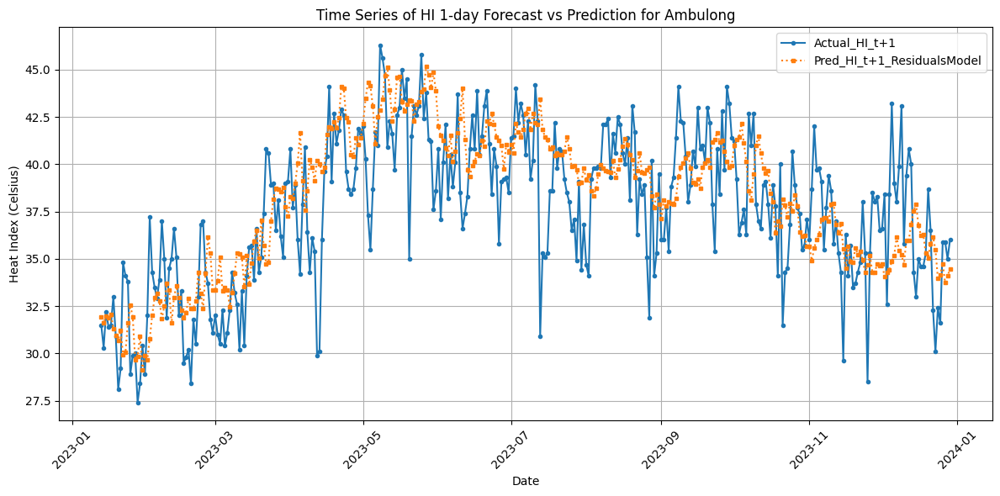

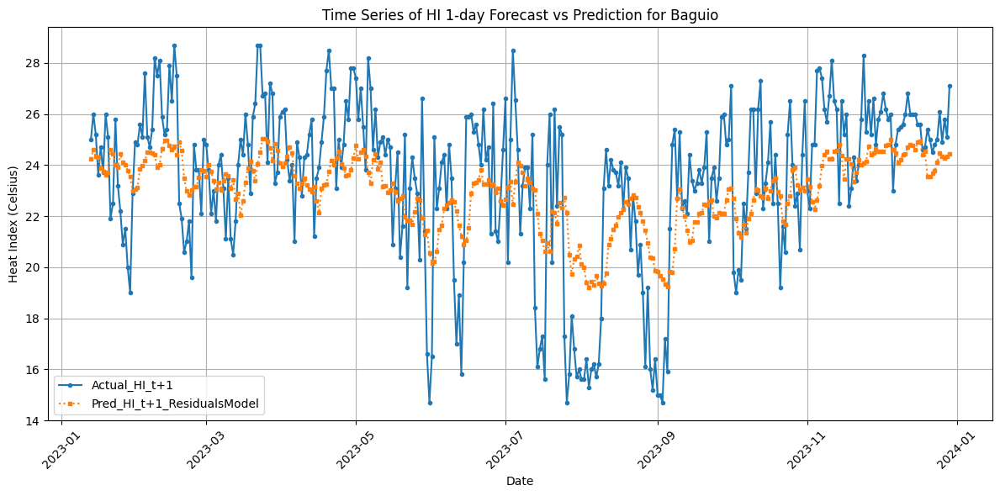

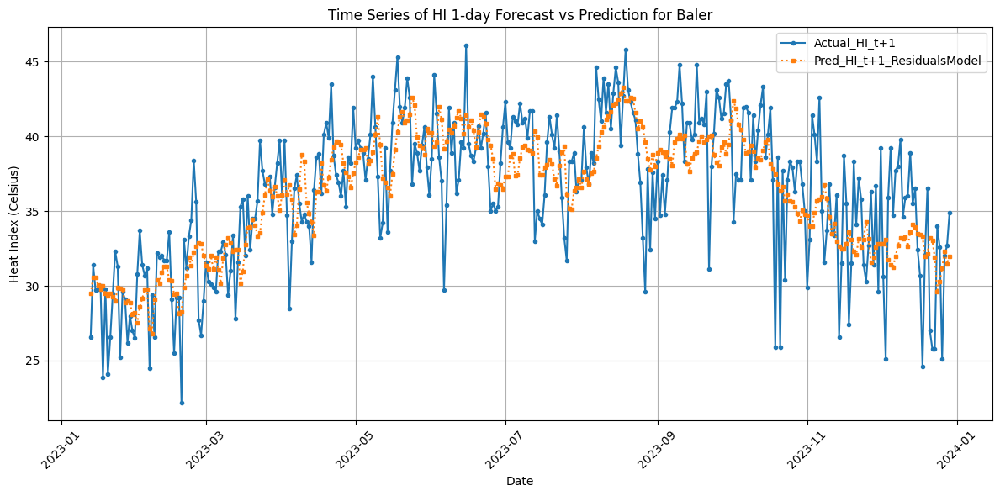

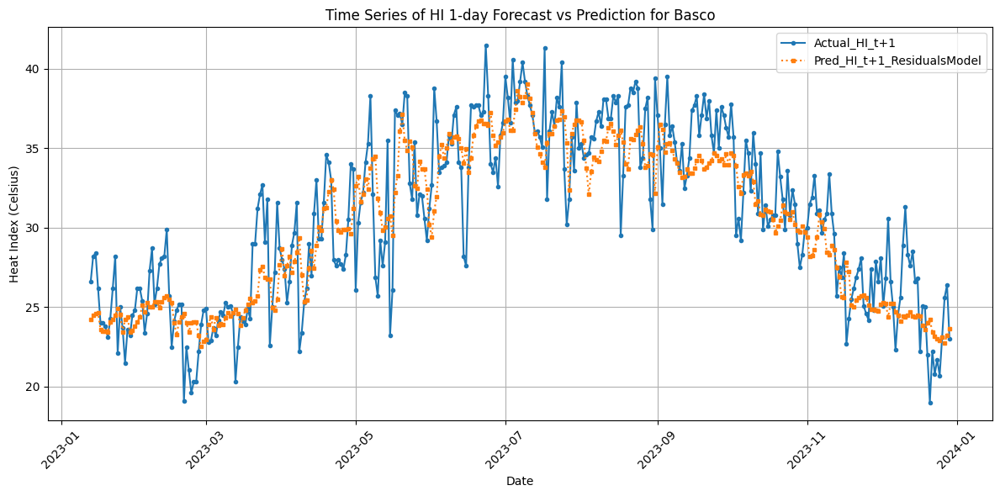

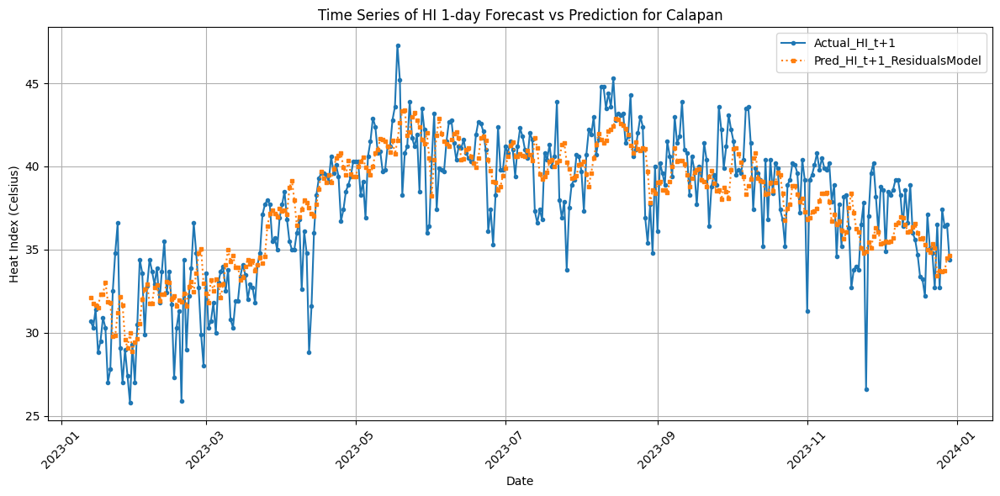

...

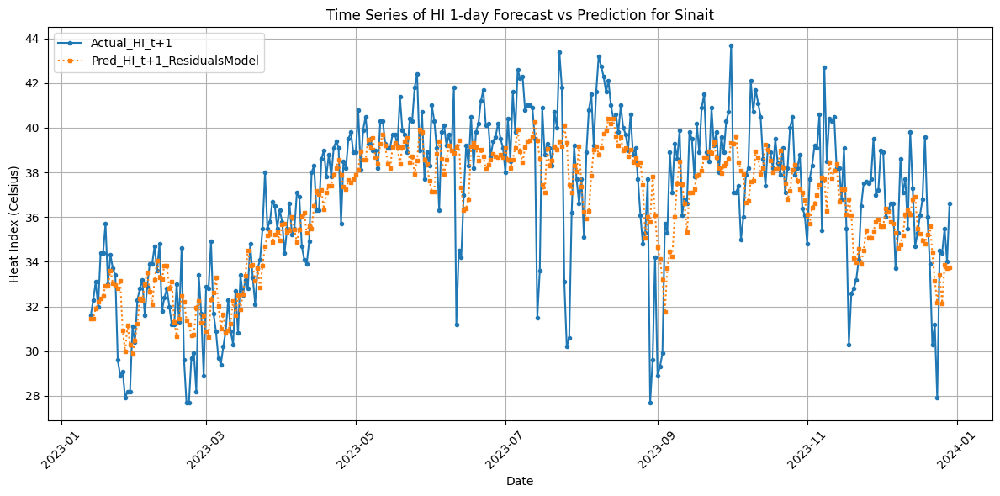

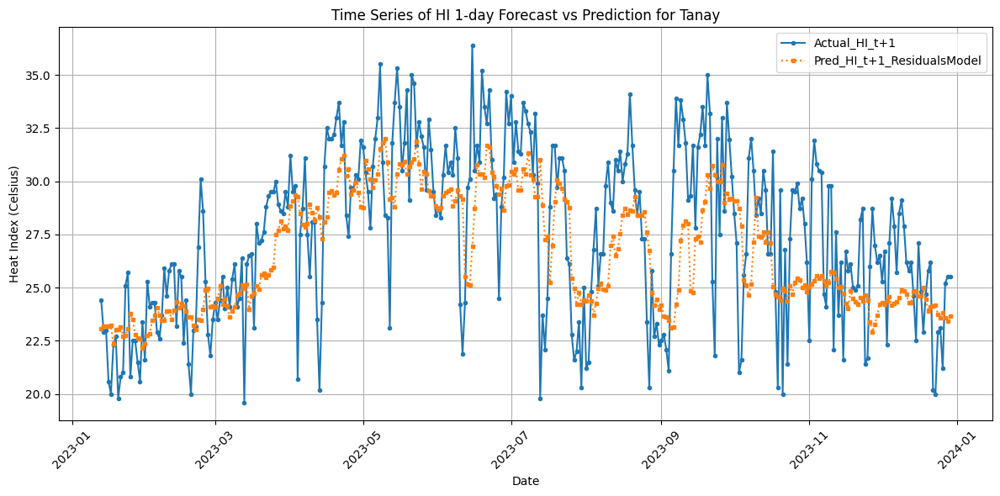

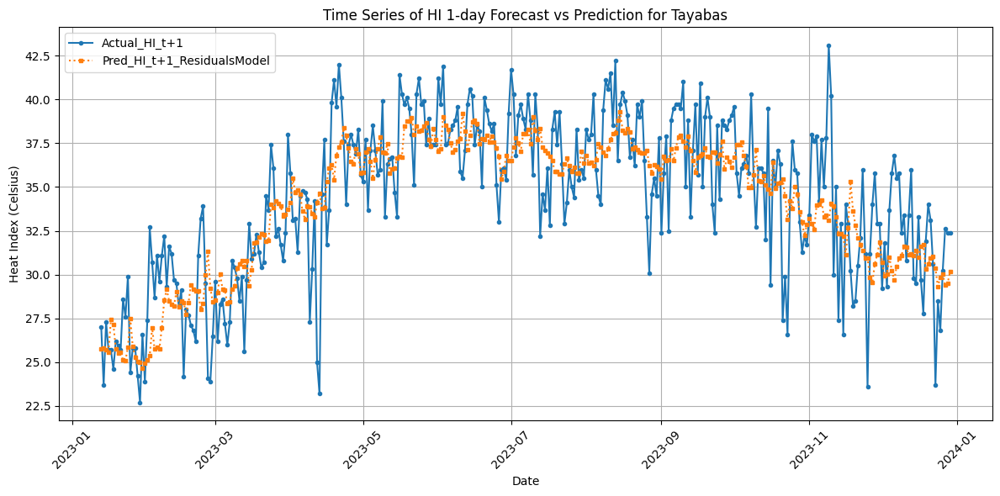

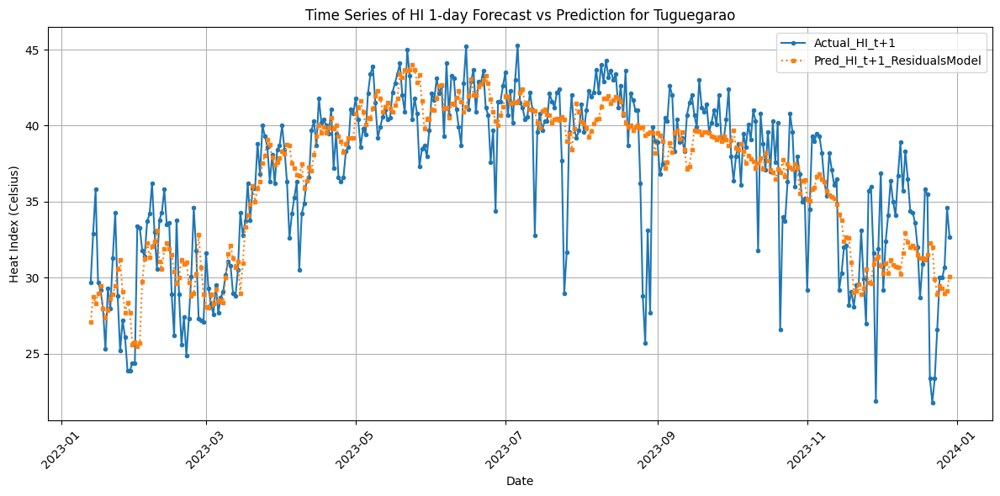

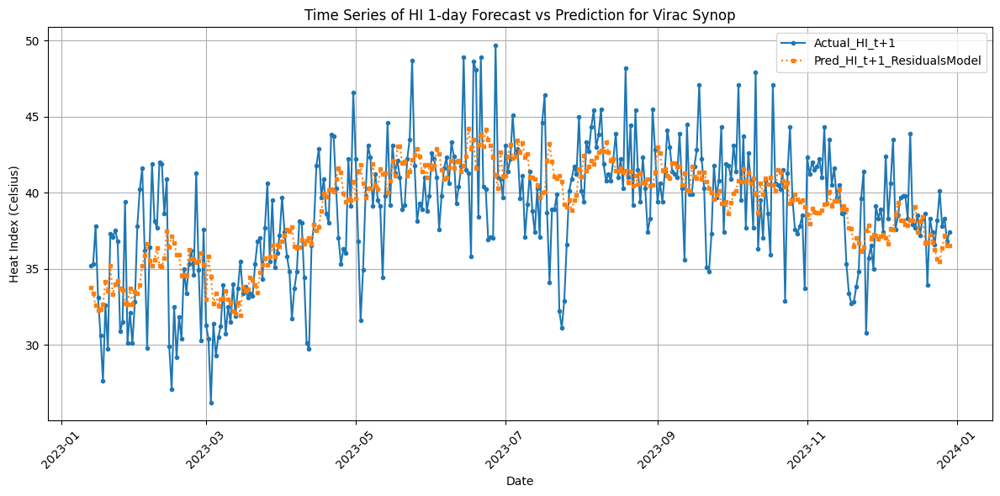

In [938]:
# Plot HI_1day_forecast and HI_1day_forecast_Pred for each station in df_results_by_station
for station in stations:
    # station_df = df_results_by_station[df_results_by_station['Station'] == station]
    station_df_residuals = df_results_by_station_res[df_results_by_station_res['Station'] == station]
    plt.figure(figsize=(12, 6))
    plt.plot(station_df_residuals['Date'], station_df_residuals['Actual_HI_t+1'], marker='o', linestyle='-', markersize=3, label='Actual_HI_t+1')
    plt.plot(station_df_residuals['Date'], station_df_residuals['Pred_HI_t+1'], marker='s', linestyle=':', markersize=3, label='Pred_HI_t+1_ResidualsModel')
    plt.title(f'Time Series of HI 1-day Forecast vs Prediction for {station}')
    plt.xlabel('Date')
    plt.ylabel('Heat Index (Celsius)')
    plt.xticks(rotation=45)
    plt.grid()
    plt.legend()
    plt.tight_layout()
    plt.show()

In [939]:
# Plot HI_1day_forecast and HI_1day_forecast_Pred for each station in df_results_by_station
for station in stations:
    station_df = df_results_by_station[df_results_by_station['Station'] == station]
    station_df_residuals = df_results_by_station_res[df_results_by_station_res['Station'] == station]
    plt.figure(figsize=(12, 6))
    plt.plot(station_df['Date'], station_df['Actual_HI_t+2'], marker='o', linestyle='-', markersize=3, label='Actual_HI_t+2')
    plt.plot(station_df['Date'], station_df['Pred_HI_t+2'], marker='x', linestyle='--', markersize=3, label='Pred_HI_t+2')
    plt.plot(station_df_residuals['Date'], station_df_residuals['Pred_HI_t+2'], marker='s', linestyle=':', markersize=3, label='Pred_HI_t+2_ResidualsModel')
    plt.title(f'Time Series of HI 2-day Forecast vs Prediction for {station}')
    plt.xlabel('Date')
    plt.ylabel('Heat Index (Celsius)')
    plt.xticks(rotation=45)
    plt.grid()
    plt.legend()
    plt.tight_layout()
    plt.show()

NameError: name 'df_results_by_station' is not defined